In [1]:
import numpy as np
import cv2
from matplotlib import pyplot as plt
import imutils
import math
import matplotlib.patches as patches
import time

import scipy

In [2]:
import importlib  

module = importlib.import_module('0) APIs')
detect_and_refine_boundingBox = module.detect_and_refine_boundingBox

In [3]:
from os import listdir
from os.path import isfile, join
images_paths = [f for f in listdir('../images') if isfile(join('../images', f))]

In [17]:
def compute_visualize_RminSC(image_path):
    print('Image path:', image_path)
    print()
    image = cv2.imread(image_path)
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)  
    plt.figure()
    plt.imshow(gray, 'gray')
    plt.title('Original image')  
    
    roi_image, bb_points_sorted_rot, bb_width, bb_height = detect_and_refine_boundingBox(image, 
                            use_same_threshold=False, compute_barcode_structure_algorithm=1, verbose_timing=False,
                            outlier_detection_level=0.02, visualization_dict=None)
    
    scanlines_indices = np.linspace(start=0, stop=bb_height, num=12, dtype=int)[1:-1]    
    roi_image_norm = 100*(roi_image/255)
    
    roi_image_tmp = roi_image.copy()
    roi_image_tmp = cv2.cvtColor(roi_image_tmp, cv2.COLOR_GRAY2RGB)
    roi_image_tmp[scanlines_indices,:,:] = np.array([255,0,0])
    plt.figure()
    plt.imshow(roi_image_tmp, 'gray') 
    plt.title('ROI image, with the 10 scanlines')
    
    R_min_list = []
    R_max_list = []
    SC_list = []
    GB_list = []

    fig, axs = plt.subplots(nrows=5, ncols=2, figsize=(15,15), squeeze=True)
    #print(axs.shape)

    for i, scanline_index in enumerate(scanlines_indices):
        scanline = roi_image_norm[scanline_index, :]

        R_min = scanline.min()
        R_max = scanline.max()
        R_min_list.append(R_min)
        R_max_list.append(R_max)

        SC = R_max - R_min
        SC_list.append(SC)

        GB = R_min + SC/2
        GB_list.append(GB)

        axs[i//2,i%2].plot(scanline)
        axs[i//2,i%2].axhline(GB, c='r', label='GB')
        axs[i//2,i%2].axhline(R_min, c='g', label='R_min')
        axs[i//2,i%2].axhline(R_max, c='y', label='R_max')
        axs[i//2,i%2].set_title(f'Scanline {i}')
        axs[i//2,i%2].legend()
        
    print('R_min_list:', R_min_list)
    R_min = np.mean(R_min_list)
    print('R_min mean:', R_min)
    print()

    print('R_max_list:', R_max_list)
    R_max = np.mean(R_max_list)
    print('R_max mean:', R_max)
    print()

    if R_min<=0.5*R_max:
        R_min_grade = 'A'
    else:
        R_min_grade = 'F'
    print('R_min_grade:', R_min_grade)
    print()
    
    print('SC_list:', SC_list)
    SC = np.mean(SC_list)
    print('SC mean:', SC)
    if SC>=70:
        SC_grade = 'A'
    elif SC>=55:
        SC_grade = 'B'
    elif SC>=40:
        SC_grade = 'C'
    elif SC>=20:
        SC_grade = 'D'
    else:
        SC_grade = 'F'
    print('SC_grade:', SC_grade)
    print()
    
    print('GB_list:', GB_list)
    print('GB mean:', np.mean(GB_list))

Image path: ../images/C128_4.4LOW.BMP

R_min_list: [8.235294117647058, 8.627450980392156, 8.235294117647058, 8.235294117647058, 8.235294117647058, 8.235294117647058, 8.627450980392156, 8.627450980392156, 8.235294117647058, 8.235294117647058]
R_min mean: 8.352941176470587

R_max_list: [80.7843137254902, 83.13725490196079, 82.35294117647058, 82.35294117647058, 82.35294117647058, 82.74509803921568, 81.56862745098039, 81.17647058823529, 81.17647058823529, 79.6078431372549]
R_max mean: 81.72549019607843

R_min_grade: A

SC_list: [72.54901960784314, 74.50980392156863, 74.11764705882352, 74.11764705882352, 74.11764705882352, 74.50980392156862, 72.94117647058823, 72.54901960784314, 72.94117647058823, 71.37254901960785]
SC mean: 73.37254901960783
SC_grade: A

GB_list: [44.509803921568626, 45.88235294117647, 45.29411764705882, 45.29411764705882, 45.29411764705882, 45.49019607843137, 45.09803921568627, 44.90196078431372, 44.705882352941174, 43.92156862745098]
GB mean: 45.03921568627451


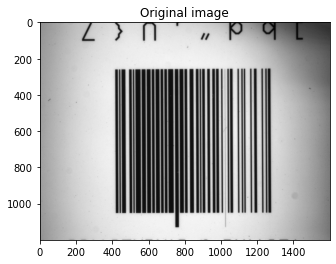

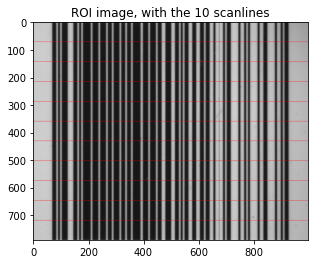

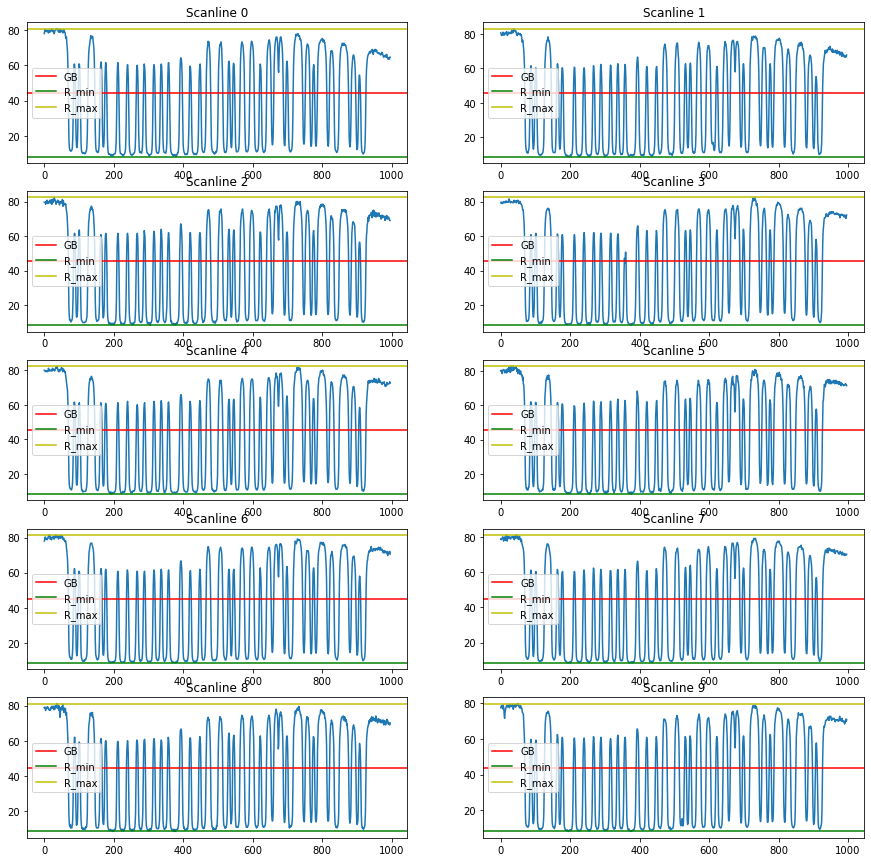

In [18]:
# TEST CHART SC: 74.9, 80. GRADE 'A'
# MINE SC: 73.37. GRADE 'A'
# OK

%matplotlib inline  
compute_visualize_RminSC(f'../images/{images_paths[0]}')

Image path: ../images/C128_4.4UP.BMP

R_min_list: [9.019607843137255, 8.235294117647058, 8.235294117647058, 7.8431372549019605, 7.8431372549019605, 7.8431372549019605, 7.8431372549019605, 7.8431372549019605, 7.450980392156863, 7.0588235294117645]
R_min mean: 7.921568627450981

R_max_list: [82.35294117647058, 82.35294117647058, 82.74509803921568, 82.35294117647058, 81.56862745098039, 80.7843137254902, 80.3921568627451, 80.7843137254902, 80.7843137254902, 79.6078431372549]
R_max mean: 81.37254901960783

R_min_grade: A

SC_list: [73.33333333333333, 74.11764705882352, 74.50980392156862, 74.50980392156862, 73.72549019607843, 72.94117647058823, 72.54901960784314, 72.94117647058823, 73.33333333333333, 72.54901960784314]
SC mean: 73.45098039215685
SC_grade: A

GB_list: [45.68627450980392, 45.29411764705882, 45.49019607843137, 45.09803921568627, 44.705882352941174, 44.31372549019608, 44.11764705882353, 44.31372549019608, 44.11764705882353, 43.33333333333333]
GB mean: 44.647058823529406


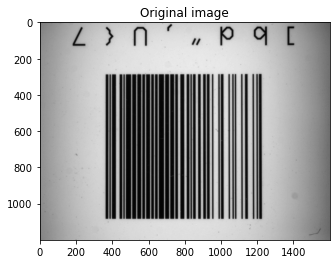

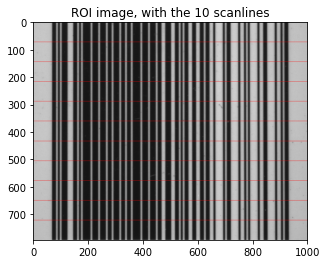

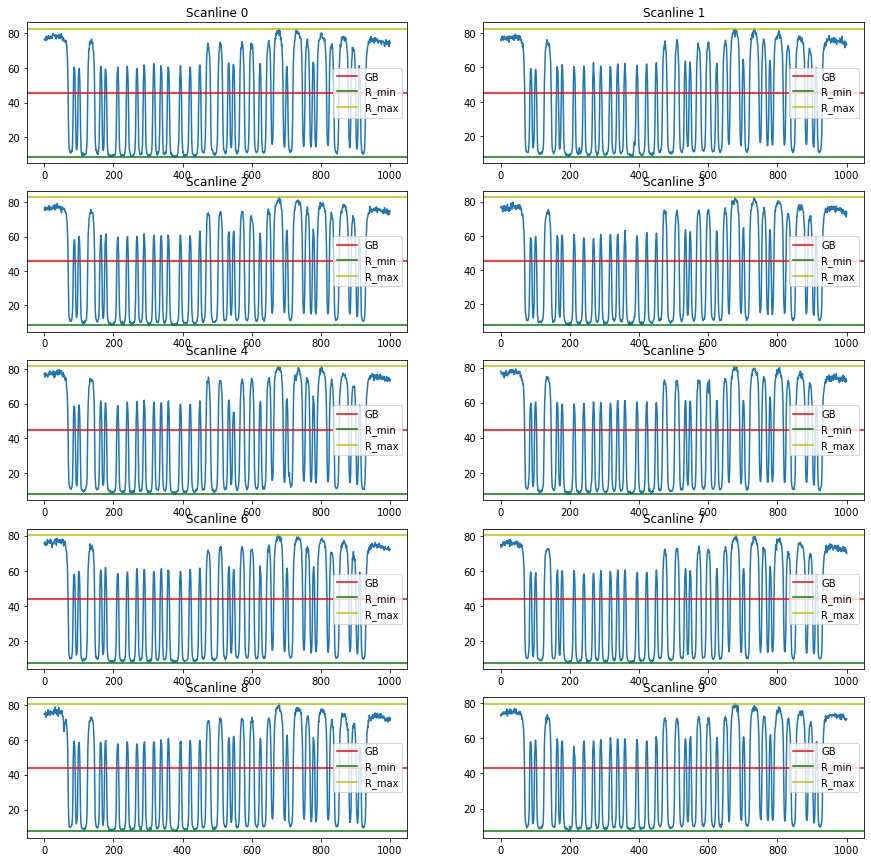

In [19]:
# TEST CHART SC: 74.8, 78.9. GRADE 'A'
# MINE SC: 73.45. GRADE 'A'
# OK

%matplotlib inline  
compute_visualize_RminSC(f'../images/{images_paths[1]}')

Image path: ../images/C128_7.5LOW.BMP

R_min_list: [0.7843137254901961, 0.7843137254901961, 0.7843137254901961, 1.1764705882352942, 1.1764705882352942, 1.1764705882352942, 0.7843137254901961, 0.7843137254901961, 0.7843137254901961, 0.39215686274509803]
R_min mean: 0.8627450980392158

R_max_list: [75.68627450980392, 74.50980392156863, 74.11764705882354, 74.11764705882354, 73.33333333333333, 74.11764705882354, 74.50980392156863, 74.50980392156863, 74.50980392156863, 74.50980392156863]
R_max mean: 74.39215686274511

R_min_grade: A

SC_list: [74.90196078431373, 73.72549019607844, 73.33333333333334, 72.94117647058825, 72.15686274509804, 72.94117647058825, 73.72549019607844, 73.72549019607844, 73.72549019607844, 74.11764705882354]
SC mean: 73.52941176470588
SC_grade: A

GB_list: [38.23529411764706, 37.64705882352941, 37.450980392156865, 37.64705882352942, 37.254901960784316, 37.64705882352942, 37.64705882352941, 37.64705882352941, 37.64705882352941, 37.450980392156865]
GB mean: 37.6274509803

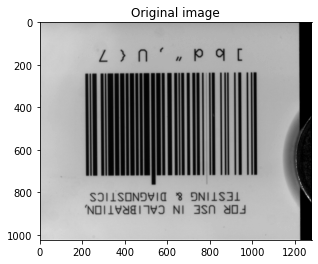

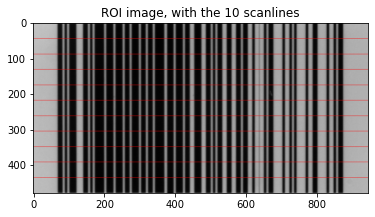

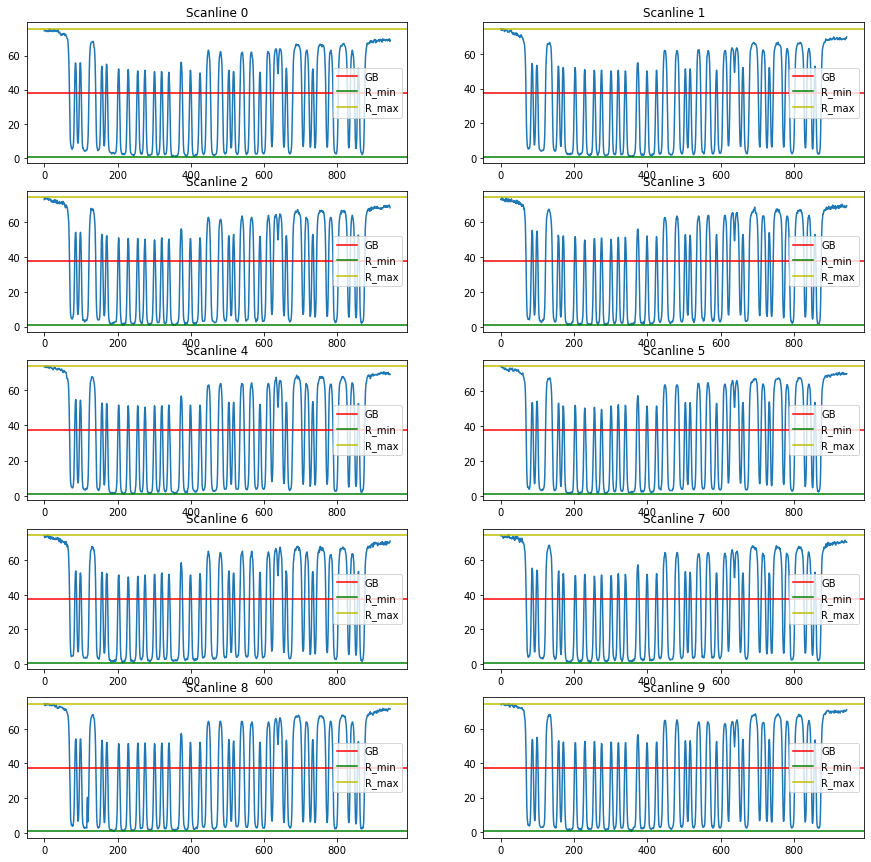

In [20]:
# TEST CHART SC: 76.4, 76.7. GRADE 'A'
# MINE SC: 73.52. GRADE 'A'
# OK

%matplotlib inline  
compute_visualize_RminSC(f'../images/{images_paths[2]}')

Image path: ../images/C128_7.5UP.BMP

R_min_list: [0.39215686274509803, 0.0, 0.39215686274509803, 0.39215686274509803, 0.7843137254901961, 1.1764705882352942, 0.0, 0.39215686274509803, 0.39215686274509803, 0.0]
R_min mean: 0.39215686274509803

R_max_list: [77.64705882352942, 76.47058823529412, 75.29411764705883, 74.50980392156863, 74.90196078431373, 75.68627450980392, 75.68627450980392, 75.68627450980392, 75.68627450980392, 76.47058823529412]
R_max mean: 75.80392156862747

R_min_grade: A

SC_list: [77.25490196078432, 76.47058823529412, 74.90196078431373, 74.11764705882354, 74.11764705882354, 74.50980392156863, 75.68627450980392, 75.29411764705883, 75.29411764705883, 76.47058823529412]
SC mean: 75.41176470588235
SC_grade: A

GB_list: [39.01960784313726, 38.23529411764706, 37.84313725490196, 37.450980392156865, 37.84313725490196, 38.43137254901961, 37.84313725490196, 38.03921568627451, 38.03921568627451, 38.23529411764706]
GB mean: 38.098039215686285


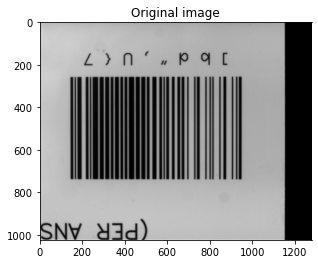

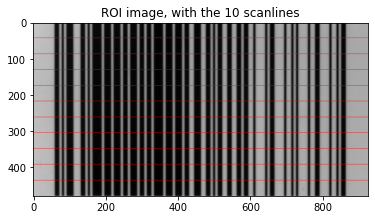

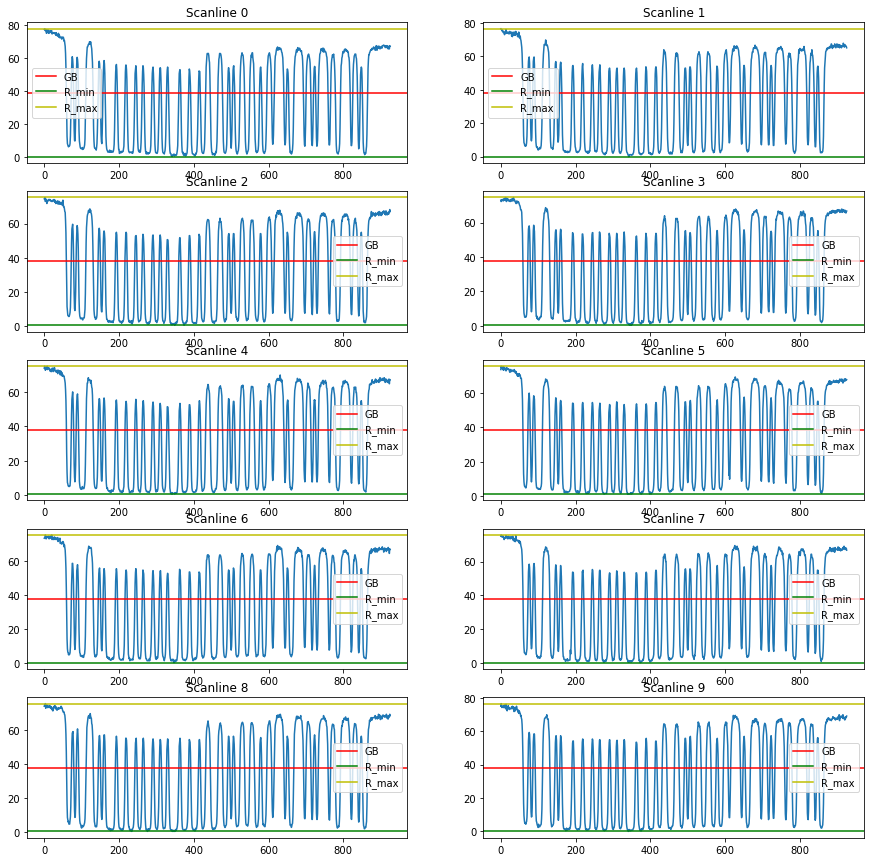

In [21]:
# TEST CHART SC: 76, 75.3. GRADE 'A'
# MINE SC: 75.41. GRADE 'A'
# OK

%matplotlib inline  
compute_visualize_RminSC(f'../images/{images_paths[3]}')

Image path: ../images/C39_4.4LOW.BMP

R_min_list: [0.7843137254901961, 1.1764705882352942, 1.1764705882352942, 1.5686274509803921, 1.9607843137254901, 2.3529411764705883, 2.3529411764705883, 1.9607843137254901, 1.9607843137254901, 1.9607843137254901]
R_min mean: 1.7254901960784312

R_max_list: [76.47058823529412, 75.68627450980392, 75.29411764705883, 74.50980392156863, 75.29411764705883, 75.68627450980392, 74.50980392156863, 73.72549019607844, 74.90196078431373, 74.50980392156863]
R_max mean: 75.05882352941177

R_min_grade: A

SC_list: [75.68627450980392, 74.50980392156863, 74.11764705882354, 72.94117647058825, 73.33333333333334, 73.33333333333333, 72.15686274509804, 71.76470588235296, 72.94117647058825, 72.54901960784315]
SC mean: 73.33333333333334
SC_grade: A

GB_list: [38.627450980392155, 38.43137254901961, 38.235294117647065, 38.03921568627452, 38.62745098039216, 39.01960784313725, 38.431372549019606, 37.84313725490197, 38.43137254901961, 38.235294117647065]
GB mean: 38.39215686274

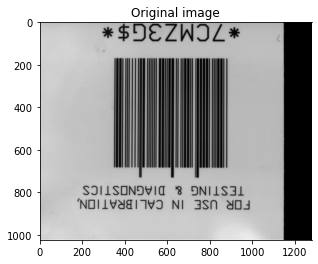

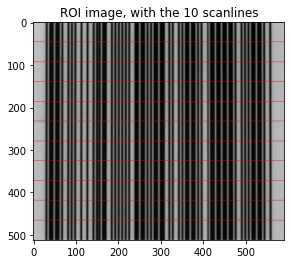

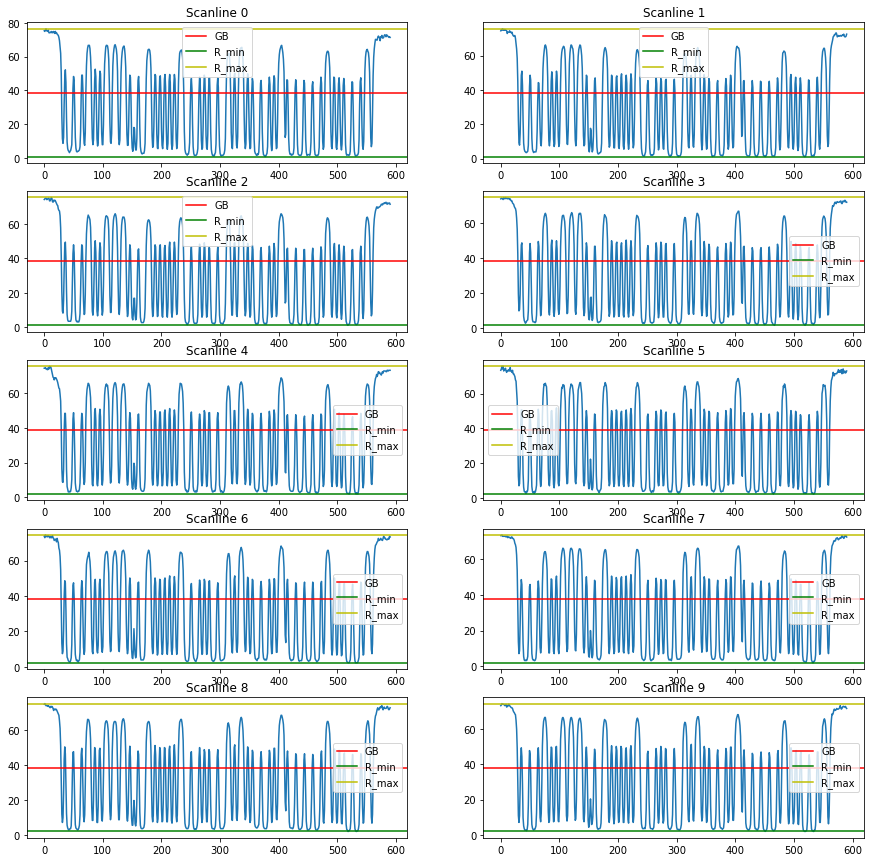

In [22]:
# TEST CHART SC: 74.9, 80. GRADE 'A'
# MINE SC: 73.33. GRADE 'A'
# OK

%matplotlib inline  
compute_visualize_RminSC(f'../images/{images_paths[4]}')

Image path: ../images/C39_4.4UP.BMP

R_min_list: [0.7843137254901961, 0.7843137254901961, 0.7843137254901961, 1.5686274509803921, 1.5686274509803921, 1.5686274509803921, 1.5686274509803921, 1.1764705882352942, 0.7843137254901961, 0.7843137254901961]
R_min mean: 1.1372549019607845

R_max_list: [74.90196078431373, 74.11764705882354, 74.11764705882354, 74.50980392156863, 74.90196078431373, 74.50980392156863, 74.11764705882354, 74.11764705882354, 74.11764705882354, 75.29411764705883]
R_max mean: 74.47058823529412

R_min_grade: A

SC_list: [74.11764705882354, 73.33333333333334, 73.33333333333334, 72.94117647058825, 73.33333333333334, 72.94117647058825, 72.54901960784315, 72.94117647058825, 73.33333333333334, 74.50980392156863]
SC mean: 73.33333333333334
SC_grade: A

GB_list: [37.84313725490196, 37.450980392156865, 37.450980392156865, 38.03921568627452, 38.235294117647065, 38.03921568627452, 37.84313725490197, 37.64705882352942, 37.450980392156865, 38.03921568627451]
GB mean: 37.803921568627

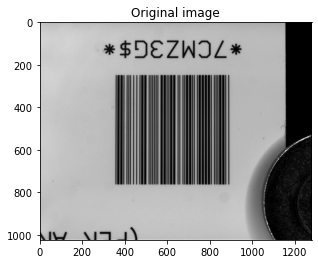

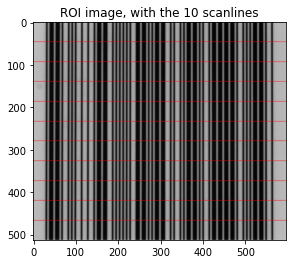

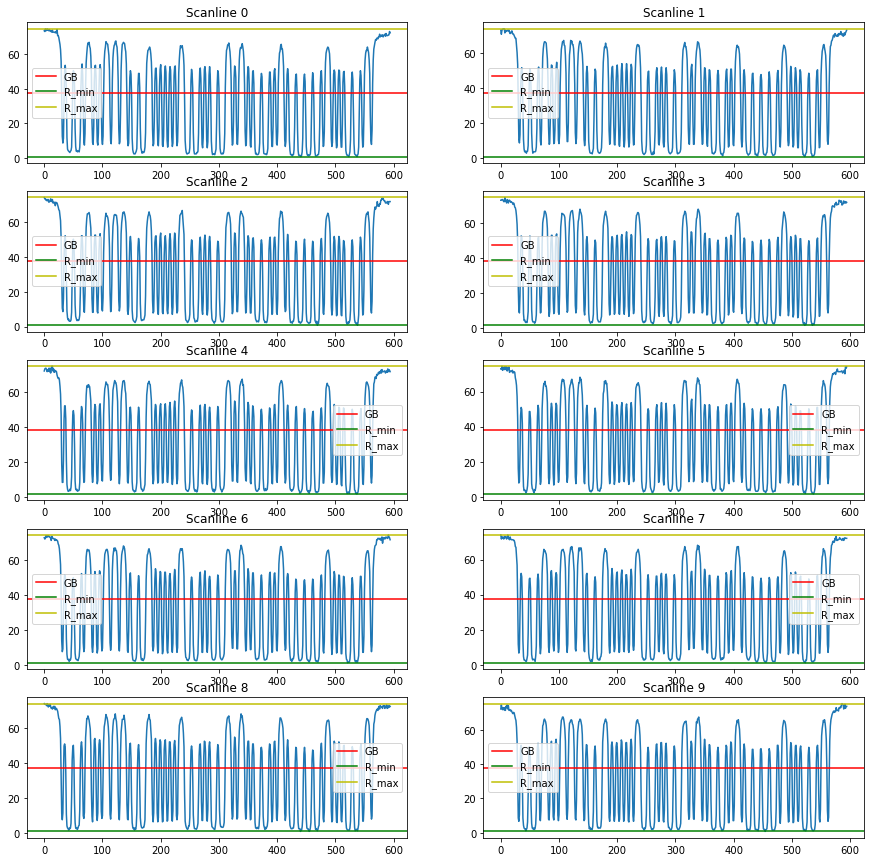

In [23]:
# TEST CHART SC: 74.8, 78.9. GRADE 'A'
# MINE SC: 73.33. GRADE 'A'
# OK

%matplotlib inline  
compute_visualize_RminSC(f'../images/{images_paths[5]}')

Image path: ../images/C39_7.5LOW.BMP

R_min_list: [0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.0, 0.39215686274509803, 0.0, 0.0, 0.0, 0.0, 0.0]
R_min mean: 0.1568627450980392

R_max_list: [78.03921568627452, 76.86274509803923, 75.68627450980392, 75.68627450980392, 76.07843137254902, 75.68627450980392, 75.68627450980392, 76.07843137254902, 76.47058823529412, 74.50980392156863]
R_max mean: 76.07843137254902

R_min_grade: A

SC_list: [77.64705882352942, 76.47058823529413, 75.29411764705883, 75.68627450980392, 75.68627450980392, 75.68627450980392, 75.68627450980392, 76.07843137254902, 76.47058823529412, 74.50980392156863]
SC mean: 75.92156862745098
SC_grade: A

GB_list: [39.21568627450981, 38.62745098039216, 38.03921568627451, 37.84313725490196, 38.23529411764706, 37.84313725490196, 37.84313725490196, 38.03921568627451, 38.23529411764706, 37.254901960784316]
GB mean: 38.11764705882352


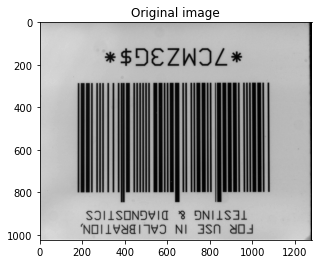

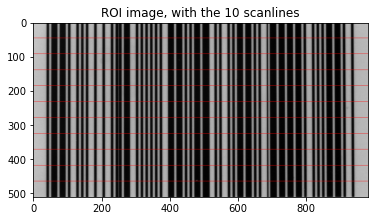

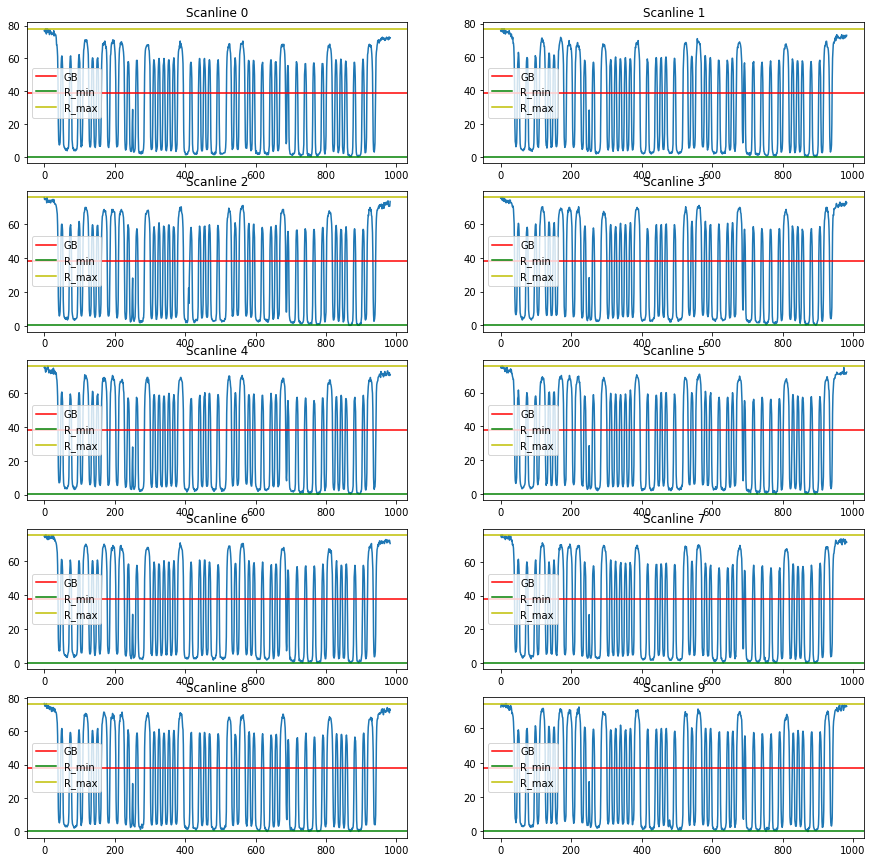

In [24]:
# TEST CHART SC: 76.4, 76.7. GRADE 'A'
# MINE SC: 75.9. GRADE 'A'
# OK

%matplotlib inline  
compute_visualize_RminSC(f'../images/{images_paths[6]}')

Image path: ../images/C39_7.5UP.BMP

R_min_list: [0.39215686274509803, 0.0, 0.39215686274509803, 0.39215686274509803, 0.39215686274509803, 0.7843137254901961, 0.0, 0.0, 0.0, 0.0]
R_min mean: 0.23529411764705882

R_max_list: [78.03921568627452, 77.64705882352942, 76.86274509803923, 76.47058823529412, 76.86274509803923, 76.07843137254902, 76.86274509803923, 76.47058823529412, 76.07843137254902, 75.29411764705883]
R_max mean: 76.66666666666666

R_min_grade: A

SC_list: [77.64705882352942, 77.64705882352942, 76.47058823529413, 76.07843137254902, 76.47058823529413, 75.29411764705883, 76.86274509803923, 76.47058823529412, 76.07843137254902, 75.29411764705883]
SC mean: 76.43137254901961
SC_grade: A

GB_list: [39.21568627450981, 38.82352941176471, 38.62745098039216, 38.431372549019606, 38.62745098039216, 38.431372549019606, 38.43137254901961, 38.23529411764706, 38.03921568627451, 37.64705882352941]
GB mean: 38.450980392156865


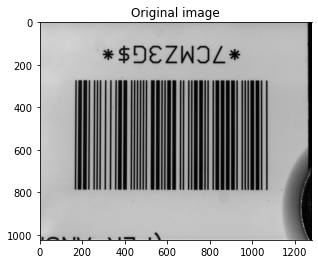

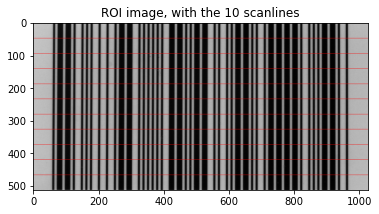

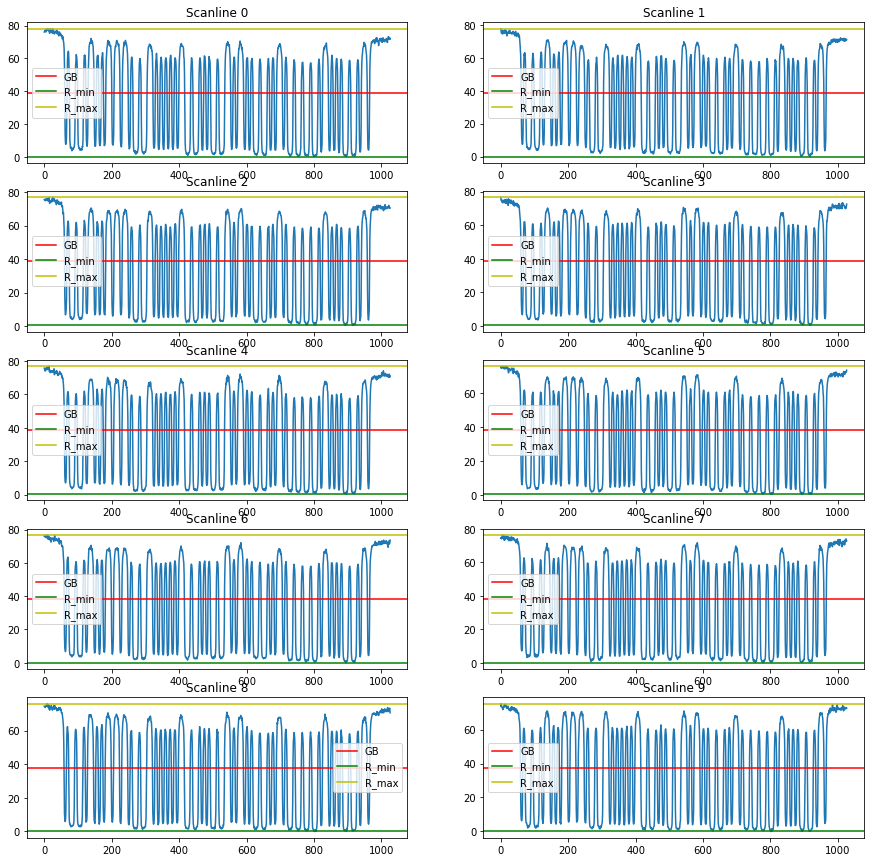

In [25]:
# TEST CHART SC: 76, 75.3. GRADE 'A'
# MINE SC: 76.43. GRADE 'A'
# OK

%matplotlib inline  
compute_visualize_RminSC(f'../images/{images_paths[7]}')

Image path: ../images/EAN-UPC-CONTRAST IMGB.BMP

R_min_list: [10.588235294117647, 10.588235294117647, 10.588235294117647, 10.196078431372548, 10.980392156862745, 9.803921568627452, 10.980392156862745, 10.588235294117647, 10.980392156862745, 11.76470588235294]
R_min mean: 10.705882352941178

R_max_list: [53.72549019607843, 54.90196078431373, 56.86274509803921, 56.07843137254902, 56.86274509803921, 56.86274509803921, 58.43137254901961, 58.43137254901961, 58.03921568627452, 59.21568627450981]
R_max mean: 56.94117647058823

R_min_grade: A

SC_list: [43.13725490196079, 44.313725490196084, 46.27450980392157, 45.88235294117647, 45.882352941176464, 47.05882352941176, 47.450980392156865, 47.84313725490197, 47.05882352941177, 47.450980392156865]
SC mean: 46.23529411764706
SC_grade: C

GB_list: [32.15686274509804, 32.74509803921569, 33.72549019607843, 33.13725490196079, 33.92156862745098, 33.33333333333333, 34.705882352941174, 34.50980392156863, 34.50980392156863, 35.490196078431374]
GB mean: 33.

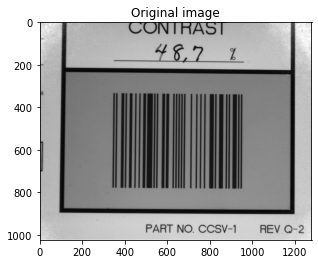

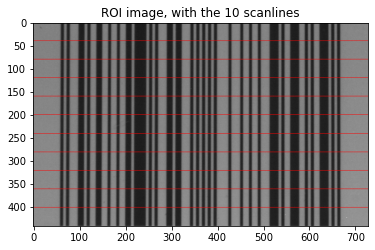

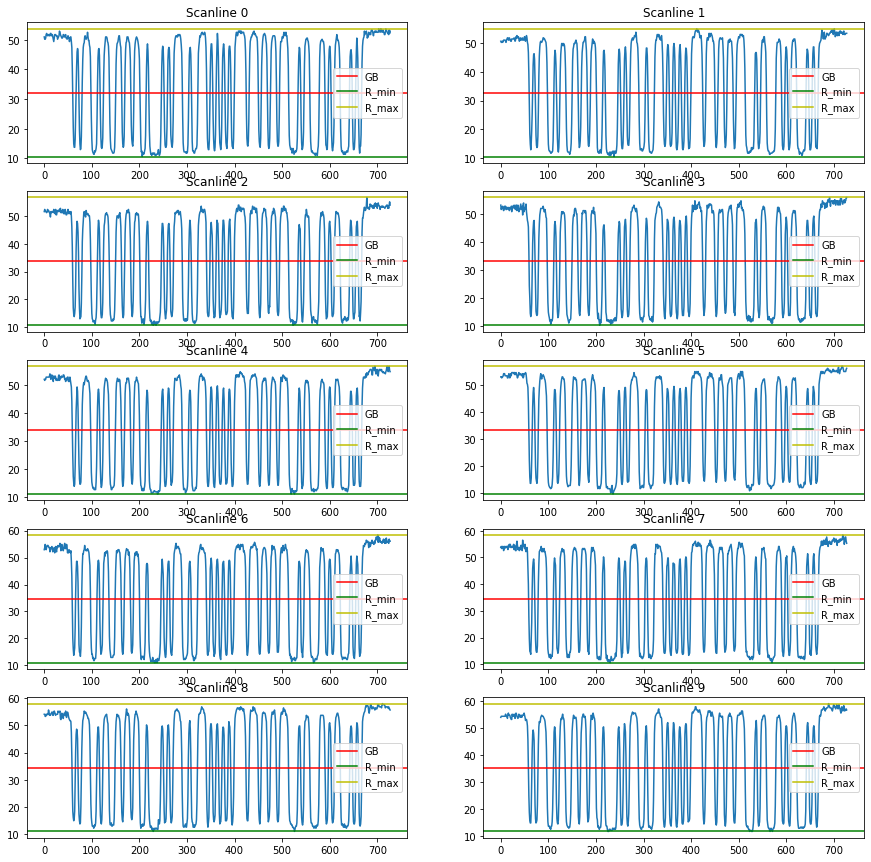

In [26]:
# TEST CHART SC: 48.7. GRADE 'C'
# MINE SC: 46.23. GRADE 'C'
# OK

%matplotlib inline  
compute_visualize_RminSC(f'../images/{images_paths[8]}')

Image path: ../images/EAN-UPC-DECODABILITY IMGB.BMP

R_min_list: [7.450980392156863, 8.235294117647058, 8.235294117647058, 8.235294117647058, 8.627450980392156, 7.8431372549019605, 8.235294117647058, 7.8431372549019605, 8.627450980392156, 8.627450980392156]
R_min mean: 8.196078431372548

R_max_list: [83.13725490196079, 83.52941176470588, 83.13725490196079, 83.92156862745098, 87.05882352941177, 85.09803921568627, 86.27450980392157, 85.88235294117646, 86.27450980392157, 86.27450980392157]
R_max mean: 85.05882352941175

R_min_grade: A

SC_list: [75.68627450980392, 75.29411764705883, 74.90196078431373, 75.68627450980392, 78.43137254901961, 77.25490196078431, 78.03921568627452, 78.0392156862745, 77.64705882352942, 77.64705882352942]
SC mean: 76.86274509803921
SC_grade: A

GB_list: [45.294117647058826, 45.88235294117647, 45.68627450980392, 46.07843137254902, 47.84313725490196, 46.470588235294116, 47.254901960784316, 46.86274509803921, 47.450980392156865, 47.450980392156865]
GB mean: 46.62745

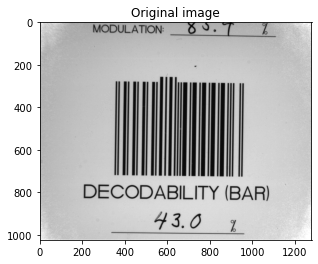

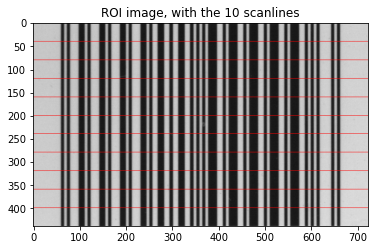

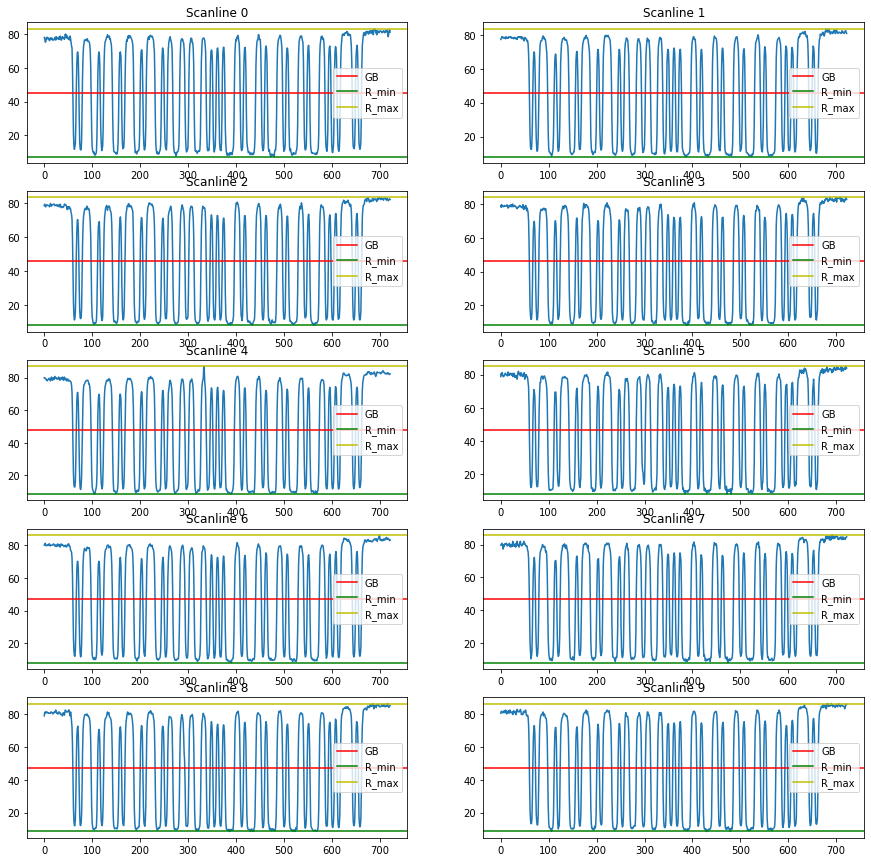

In [27]:
# TEST CHART SC: 80.7. GRADE 'A'
# MINE SC: 76.86. GRADE 'A'
# OK

%matplotlib inline  
compute_visualize_RminSC(f'../images/{images_paths[9]}')

Image path: ../images/EAN-UPC-DEFECTS IMGB.BMP

R_min_list: [7.0588235294117645, 8.235294117647058, 7.8431372549019605, 7.8431372549019605, 8.235294117647058, 8.235294117647058, 7.8431372549019605, 8.235294117647058, 7.450980392156863, 7.450980392156863]
R_min mean: 7.84313725490196

R_max_list: [87.45098039215686, 88.23529411764706, 87.45098039215686, 88.23529411764706, 87.84313725490196, 88.23529411764706, 88.23529411764706, 89.01960784313725, 88.62745098039215, 87.84313725490196]
R_max mean: 88.11764705882354

R_min_grade: A

SC_list: [80.3921568627451, 80.0, 79.6078431372549, 80.3921568627451, 79.6078431372549, 80.0, 80.3921568627451, 80.7843137254902, 81.17647058823529, 80.3921568627451]
SC mean: 80.27450980392157
SC_grade: A

GB_list: [47.25490196078431, 48.23529411764706, 47.64705882352941, 48.03921568627451, 48.03921568627451, 48.23529411764706, 48.03921568627451, 48.627450980392155, 48.03921568627451, 47.64705882352941]
GB mean: 47.98039215686275


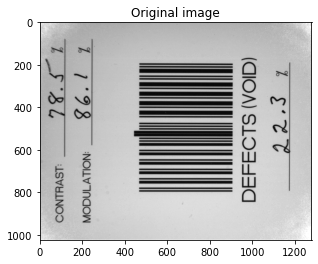

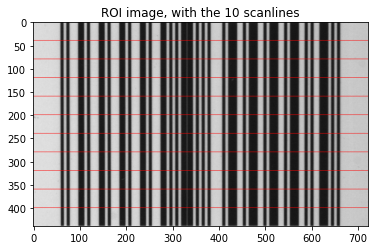

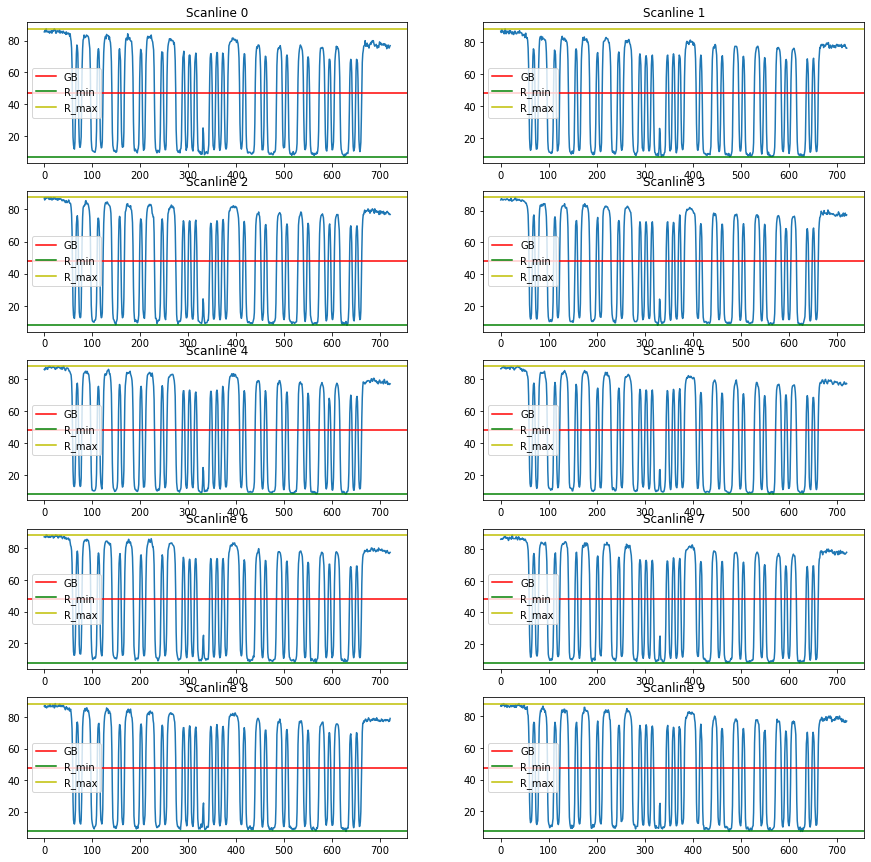

In [28]:
# TEST CHART SC: 78.5 or 79.9. GRADE 'A'
# MINE SC: 80.27. GRADE 'A'
# OK

%matplotlib inline  
compute_visualize_RminSC(f'../images/{images_paths[10]}')

Image path: ../images/EAN-UPC-EAN-13 MASTER GRADE IMGB.BMP

R_min_list: [7.8431372549019605, 7.8431372549019605, 7.8431372549019605, 7.8431372549019605, 7.0588235294117645, 8.235294117647058, 8.235294117647058, 8.235294117647058, 7.8431372549019605, 7.8431372549019605]
R_min mean: 7.882352941176469

R_max_list: [83.13725490196079, 83.92156862745098, 84.31372549019608, 85.09803921568627, 85.49019607843137, 84.70588235294117, 85.49019607843137, 85.09803921568627, 88.23529411764706, 86.66666666666667]
R_max mean: 85.2156862745098

R_min_grade: A

SC_list: [75.29411764705883, 76.07843137254902, 76.47058823529412, 77.25490196078431, 78.4313725490196, 76.47058823529412, 77.25490196078431, 76.86274509803921, 80.3921568627451, 78.82352941176471]
SC mean: 77.33333333333334
SC_grade: A

GB_list: [45.490196078431374, 45.88235294117647, 46.07843137254902, 46.470588235294116, 46.27450980392156, 46.470588235294116, 46.86274509803921, 46.666666666666664, 48.03921568627451, 47.254901960784316]
GB mean

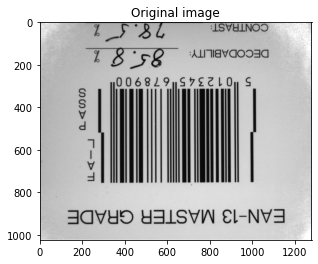

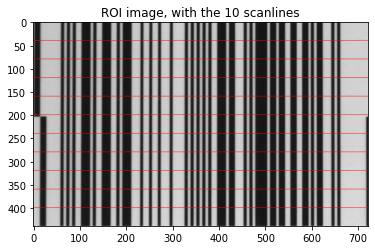

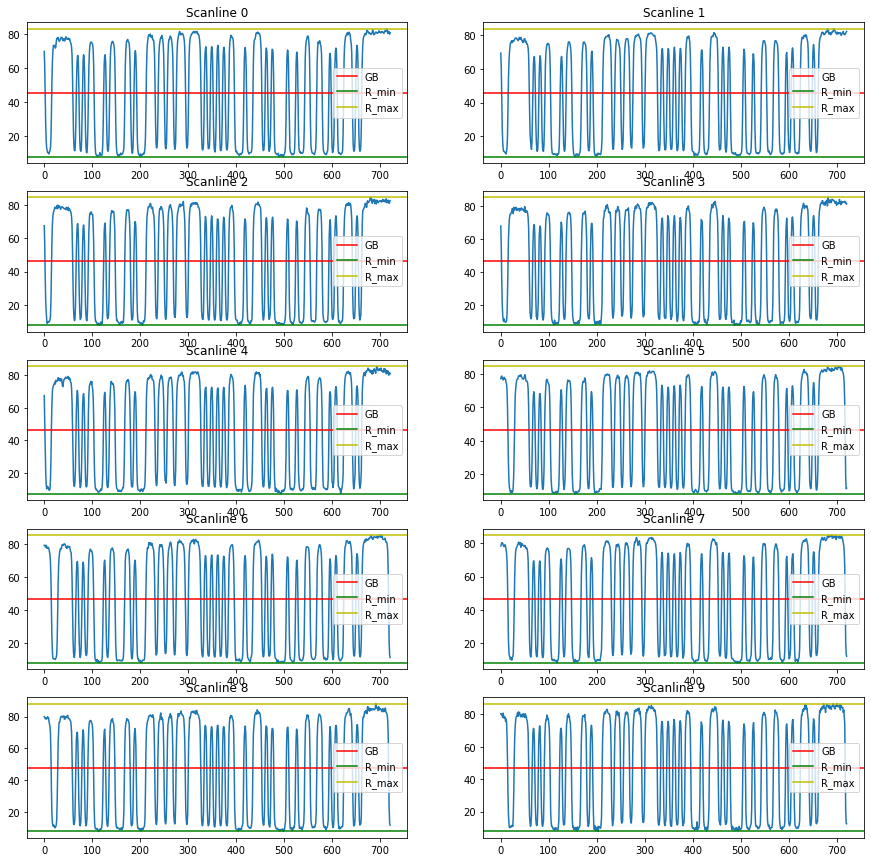

In [29]:
# TEST CHART SC: 78.5. GRADE 'A'
# MINE SC: 77.33. GRADE 'A'
# OK

%matplotlib inline  
compute_visualize_RminSC(f'../images/{images_paths[11]}')

Image path: ../images/EAN-UPC-UPC-A MASTER GRADE IMGB.BMP

R_min_list: [6.2745098039215685, 7.0588235294117645, 6.2745098039215685, 7.8431372549019605, 7.8431372549019605, 6.2745098039215685, 6.666666666666667, 7.0588235294117645, 7.450980392156863, 6.2745098039215685]
R_min mean: 6.901960784313727

R_max_list: [86.27450980392157, 87.05882352941177, 88.23529411764706, 87.84313725490196, 87.05882352941177, 88.23529411764706, 87.84313725490196, 87.84313725490196, 87.05882352941177, 88.23529411764706]
R_max mean: 87.5686274509804

R_min_grade: A

SC_list: [80.0, 80.0, 81.96078431372548, 80.0, 79.2156862745098, 81.96078431372548, 81.17647058823529, 80.7843137254902, 79.6078431372549, 81.96078431372548]
SC mean: 80.66666666666666
SC_grade: A

GB_list: [46.27450980392157, 47.05882352941177, 47.25490196078431, 47.84313725490196, 47.450980392156865, 47.25490196078431, 47.25490196078431, 47.450980392156865, 47.254901960784316, 47.25490196078431]
GB mean: 47.23529411764706


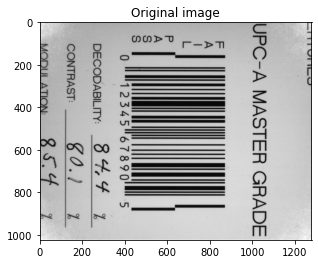

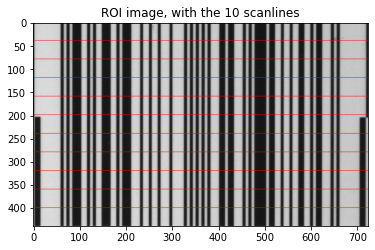

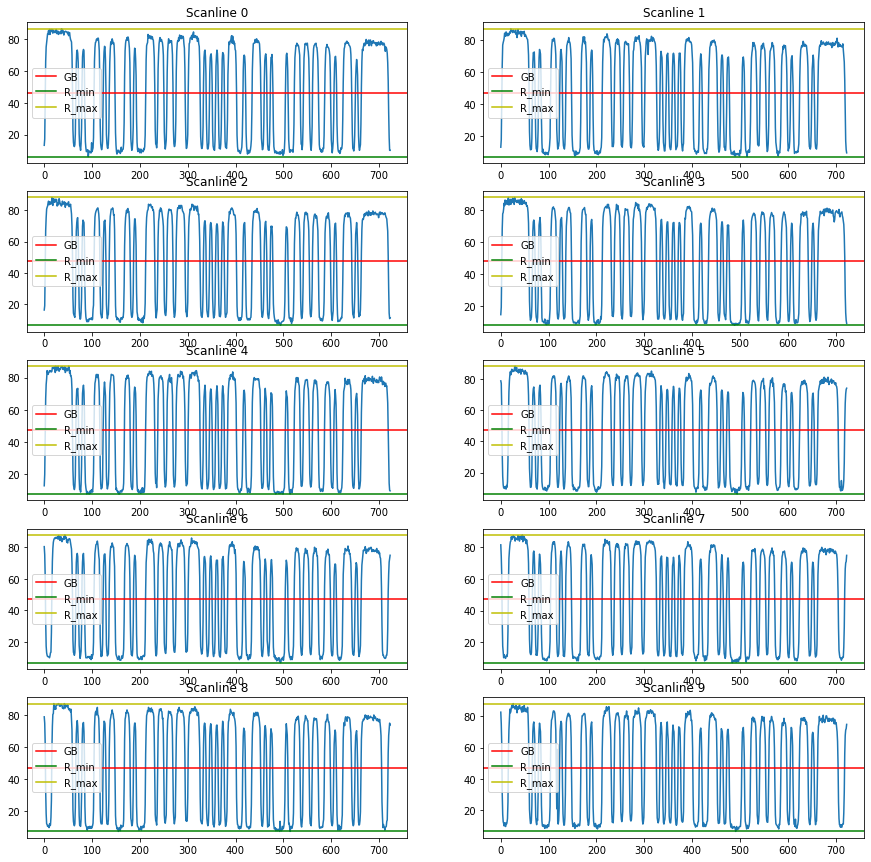

In [30]:
# TEST CHART SC: 80.1. GRADE 'A'
# MINE SC: 80.66. GRADE 'A'
# OK

%matplotlib inline  
compute_visualize_RminSC(f'../images/{images_paths[12]}')

Image path: ../images/EAN128-CONTRAST IMGB.BMP

R_min_list: [9.803921568627452, 9.803921568627452, 9.411764705882353, 9.411764705882353, 9.411764705882353, 9.019607843137255, 9.411764705882353, 9.019607843137255, 9.019607843137255, 9.019607843137255]
R_min mean: 9.333333333333332

R_max_list: [61.1764705882353, 60.78431372549019, 60.0, 59.6078431372549, 60.3921568627451, 60.0, 59.6078431372549, 58.43137254901961, 58.43137254901961, 58.03921568627452]
R_max mean: 59.64705882352941

R_min_grade: A

SC_list: [51.372549019607845, 50.98039215686274, 50.588235294117645, 50.19607843137255, 50.98039215686274, 50.98039215686275, 50.19607843137255, 49.41176470588236, 49.41176470588236, 49.019607843137265]
SC mean: 50.31372549019609
SC_grade: C

GB_list: [35.490196078431374, 35.294117647058826, 34.705882352941174, 34.509803921568626, 34.90196078431372, 34.50980392156863, 34.509803921568626, 33.72549019607844, 33.72549019607844, 33.529411764705884]
GB mean: 34.49019607843137


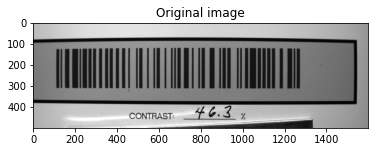

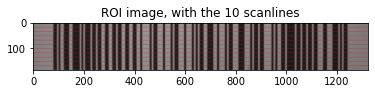

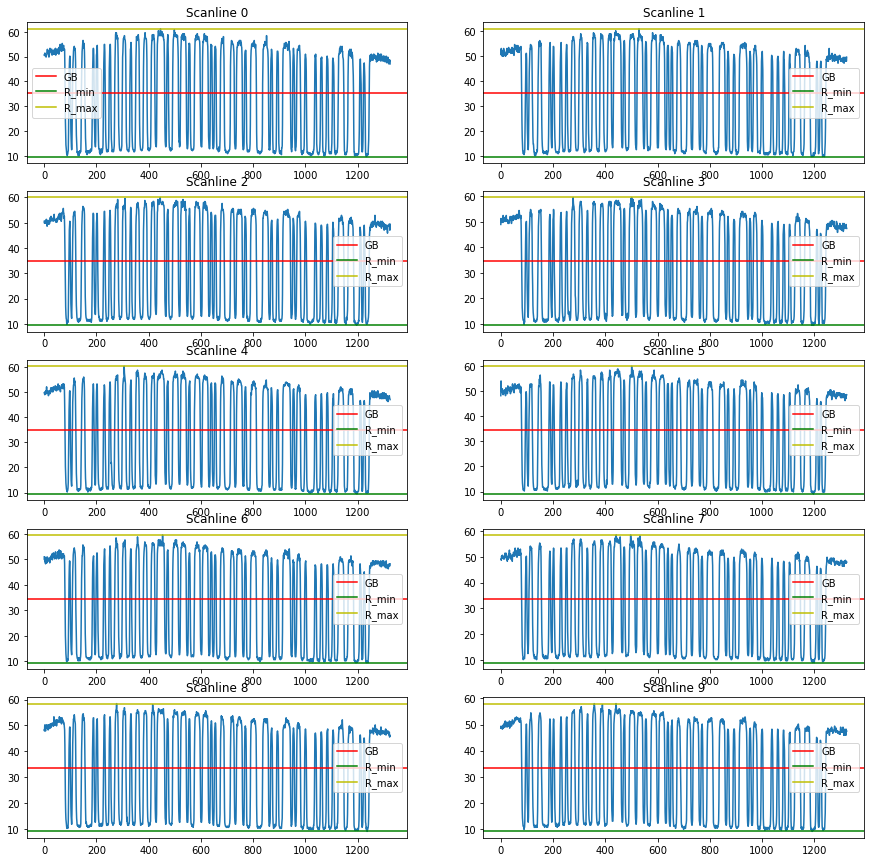

In [31]:
# TEST CHART SC: 46.3. GRADE 'C'
# MINE SC: 50.31. GRADE 'C'
# OK

%matplotlib inline  
compute_visualize_RminSC(f'../images/{images_paths[13]}')

Image path: ../images/EAN128-DEFECTS IMGB.BMP

R_min_list: [5.490196078431373, 5.490196078431373, 4.705882352941177, 5.490196078431373, 5.490196078431373, 5.490196078431373, 5.88235294117647, 5.88235294117647, 5.490196078431373, 5.88235294117647]
R_min mean: 5.529411764705882

R_max_list: [85.88235294117646, 85.49019607843137, 86.66666666666667, 87.05882352941177, 85.88235294117646, 85.49019607843137, 85.88235294117646, 86.27450980392157, 85.49019607843137, 87.05882352941177]
R_max mean: 86.11764705882354

R_min_grade: A

SC_list: [80.3921568627451, 80.0, 81.9607843137255, 81.5686274509804, 80.3921568627451, 80.0, 80.0, 80.39215686274511, 80.0, 81.1764705882353]
SC mean: 80.58823529411765
SC_grade: A

GB_list: [45.68627450980392, 45.490196078431374, 45.68627450980392, 46.274509803921575, 45.68627450980392, 45.490196078431374, 45.88235294117647, 46.078431372549026, 45.490196078431374, 46.47058823529412]
GB mean: 45.82352941176471


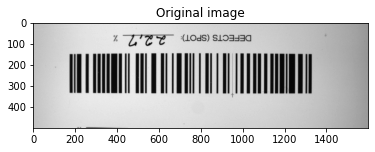

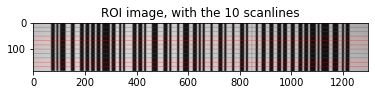

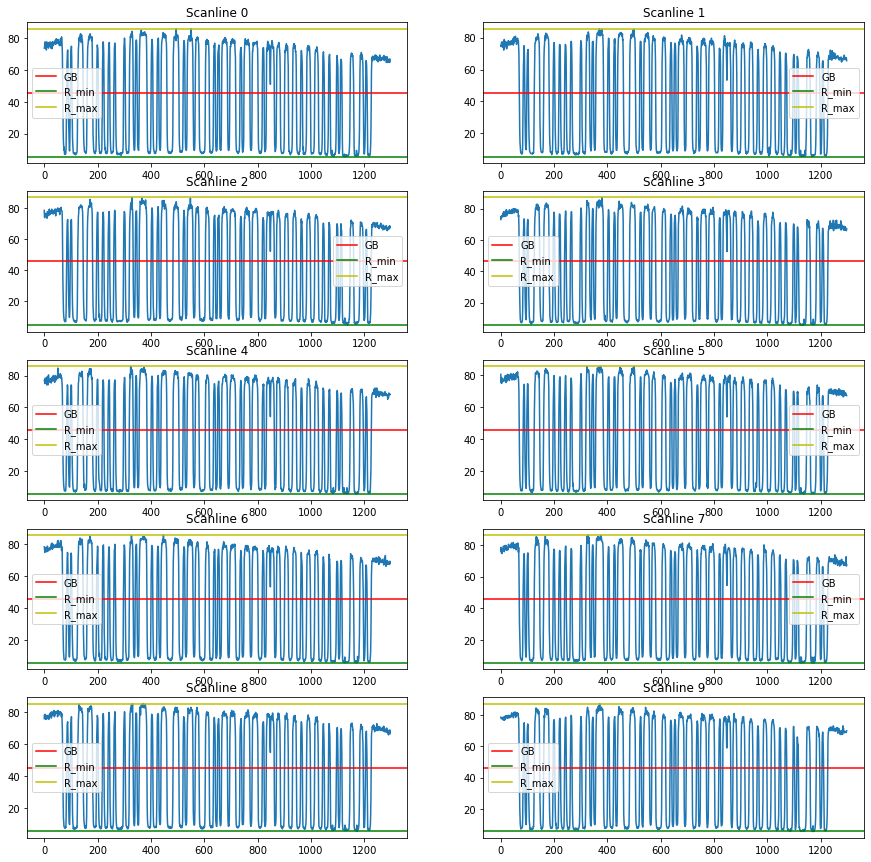

In [32]:
# TEST CHART SC: 75.3. GRADE 'A'
# MINE SC: 80.53. GRADE 'A'
# OK

%matplotlib inline  
compute_visualize_RminSC(f'../images/{images_paths[14]}')

Image path: ../images/EAN128-LOW DECODABILITY IMGB.BMP

R_min_list: [7.0588235294117645, 7.450980392156863, 7.0588235294117645, 6.666666666666667, 6.666666666666667, 6.666666666666667, 6.666666666666667, 6.666666666666667, 6.666666666666667, 6.666666666666667]
R_min mean: 6.823529411764706

R_max_list: [95.29411764705881, 94.90196078431372, 94.50980392156862, 94.11764705882352, 94.11764705882352, 95.68627450980392, 93.72549019607843, 92.54901960784314, 91.76470588235294, 91.76470588235294]
R_max mean: 93.84313725490196

R_min_grade: A

SC_list: [88.23529411764704, 87.45098039215685, 87.45098039215685, 87.45098039215685, 87.45098039215685, 89.01960784313725, 87.05882352941175, 85.88235294117646, 85.09803921568627, 85.09803921568627]
SC mean: 87.01960784313725
SC_grade: A

GB_list: [51.17647058823529, 51.17647058823529, 50.78431372549019, 50.39215686274509, 50.39215686274509, 51.17647058823529, 50.19607843137254, 49.607843137254896, 49.2156862745098, 49.2156862745098]
GB mean: 50.3333333

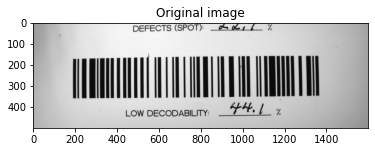

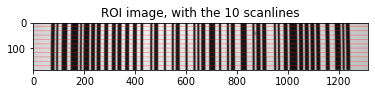

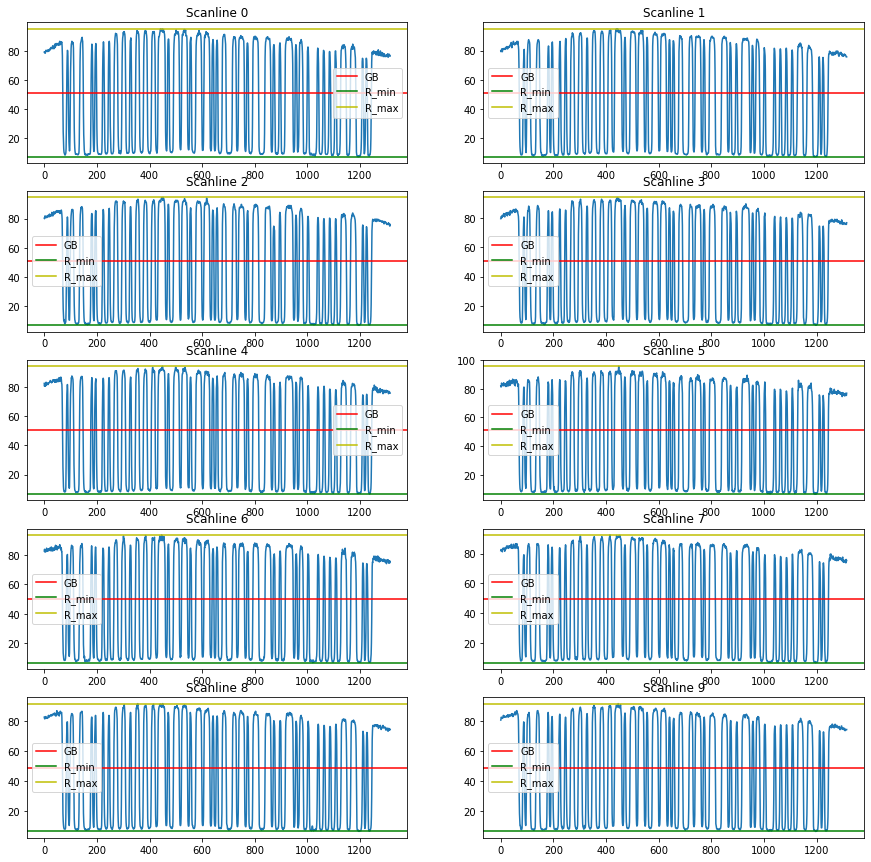

In [33]:
# TEST CHART SC: 75.4. GRADE 'A'
# MINE SC: 87.01. GRADE 'A'
# OK

%matplotlib inline  
compute_visualize_RminSC(f'../images/{images_paths[15]}')

Image path: ../images/EAN128-MASTER IMGB.BMP

R_min_list: [5.88235294117647, 5.88235294117647, 5.88235294117647, 5.88235294117647, 5.098039215686274, 5.88235294117647, 6.2745098039215685, 5.88235294117647, 5.88235294117647, 5.098039215686274]
R_min mean: 5.76470588235294

R_max_list: [89.41176470588236, 87.84313725490196, 88.62745098039215, 87.45098039215686, 88.23529411764706, 87.05882352941177, 87.45098039215686, 87.45098039215686, 86.66666666666667, 89.01960784313725]
R_max mean: 87.92156862745097

R_min_grade: A

SC_list: [83.5294117647059, 81.9607843137255, 82.74509803921569, 81.5686274509804, 83.13725490196079, 81.1764705882353, 81.17647058823529, 81.5686274509804, 80.78431372549021, 83.92156862745098]
SC mean: 82.15686274509804
SC_grade: A

GB_list: [47.64705882352942, 46.86274509803922, 47.254901960784316, 46.66666666666667, 46.66666666666667, 46.47058823529412, 46.86274509803921, 46.66666666666667, 46.274509803921575, 47.05882352941177]
GB mean: 46.84313725490196


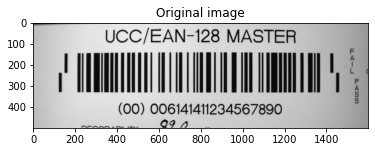

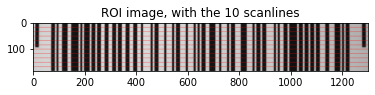

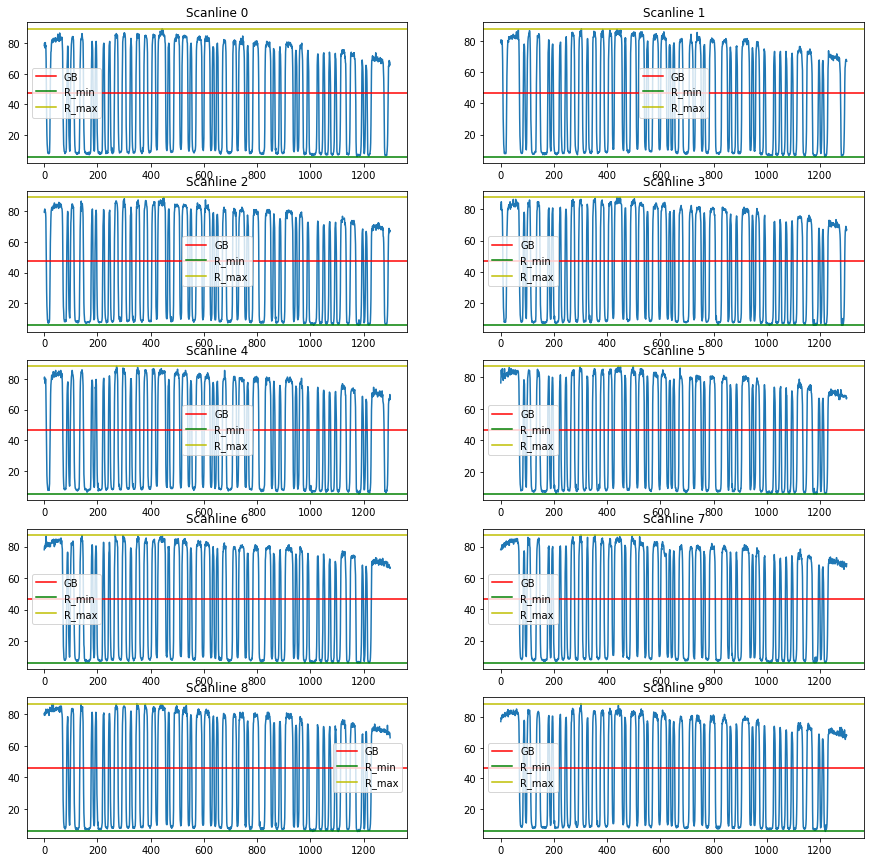

In [34]:
# TEST CHART SC: 74.8. GRADE 'A'
# MINE SC: 82.15. GRADE 'A'
# OK

%matplotlib inline  
compute_visualize_RminSC(f'../images/{images_paths[16]}')

Image path: ../images/I25-CONTRAST IMGB.BMP

R_min_list: [7.8431372549019605, 8.235294117647058, 7.450980392156863, 7.8431372549019605, 7.8431372549019605, 7.8431372549019605, 7.8431372549019605, 7.8431372549019605, 7.8431372549019605, 7.8431372549019605]
R_min mean: 7.84313725490196

R_max_list: [61.568627450980394, 61.568627450980394, 62.35294117647059, 61.568627450980394, 61.568627450980394, 60.78431372549019, 61.1764705882353, 61.568627450980394, 60.78431372549019, 61.568627450980394]
R_max mean: 61.450980392156865

R_min_grade: A

SC_list: [53.72549019607843, 53.333333333333336, 54.90196078431372, 53.72549019607843, 53.72549019607843, 52.94117647058823, 53.333333333333336, 53.72549019607843, 52.94117647058823, 53.72549019607843]
SC mean: 53.607843137254896
SC_grade: C

GB_list: [34.705882352941174, 34.90196078431373, 34.90196078431372, 34.705882352941174, 34.705882352941174, 34.31372549019608, 34.509803921568626, 34.705882352941174, 34.31372549019608, 34.705882352941174]
GB mean: 

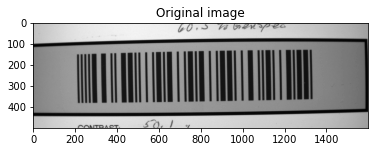

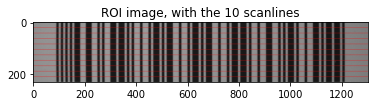

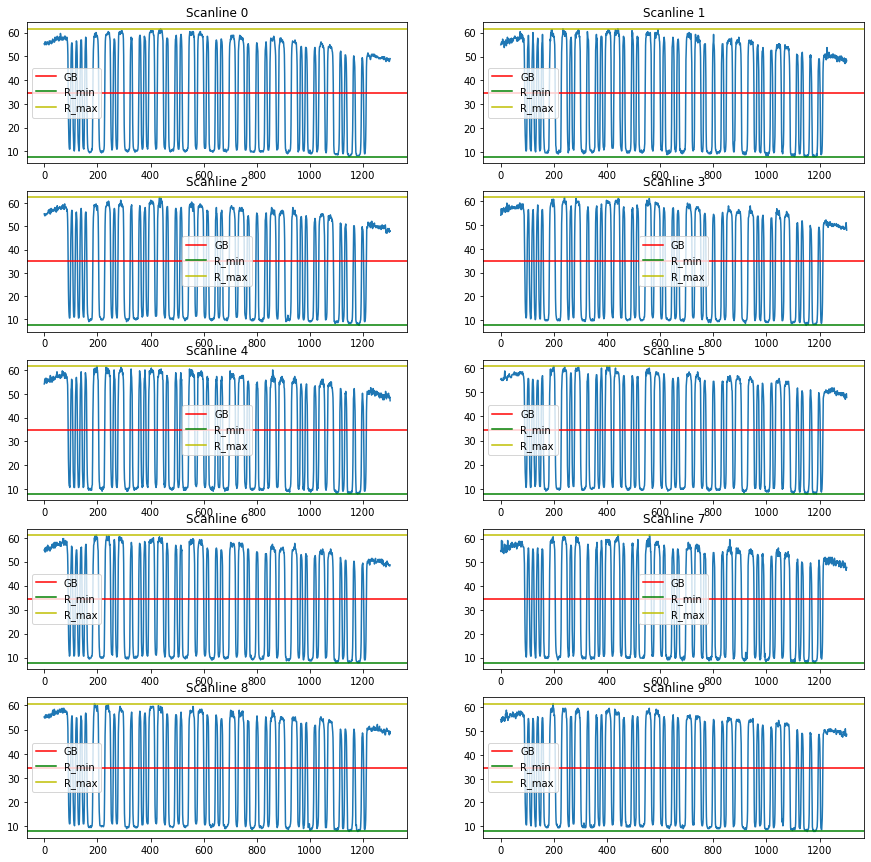

In [35]:
# TEST CHART SC: 50.1. GRADE 'C'
# MINE SC: 53.61. GRADE 'C'
# OK

%matplotlib inline  
compute_visualize_RminSC(f'../images/{images_paths[17]}')

Image path: ../images/I25-DEFECTS IMGB.BMP

R_min_list: [5.098039215686274, 5.098039215686274, 5.098039215686274, 4.313725490196078, 4.705882352941177, 5.098039215686274, 5.098039215686274, 4.705882352941177, 4.705882352941177, 4.705882352941177]
R_min mean: 4.862745098039215

R_max_list: [87.84313725490196, 87.84313725490196, 87.45098039215686, 87.84313725490196, 87.45098039215686, 87.05882352941177, 87.45098039215686, 87.45098039215686, 87.05882352941177, 86.27450980392157]
R_max mean: 87.37254901960785

R_min_grade: A

SC_list: [82.74509803921569, 82.74509803921569, 82.3529411764706, 83.52941176470588, 82.74509803921569, 81.9607843137255, 82.3529411764706, 82.74509803921569, 82.3529411764706, 81.5686274509804]
SC mean: 82.50980392156865
SC_grade: A

GB_list: [46.470588235294116, 46.470588235294116, 46.274509803921575, 46.07843137254902, 46.07843137254902, 46.07843137254902, 46.274509803921575, 46.07843137254902, 45.88235294117647, 45.490196078431374]
GB mean: 46.11764705882353


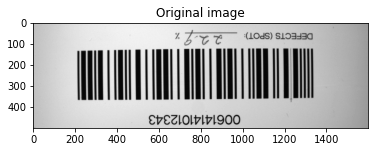

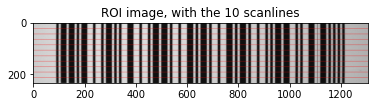

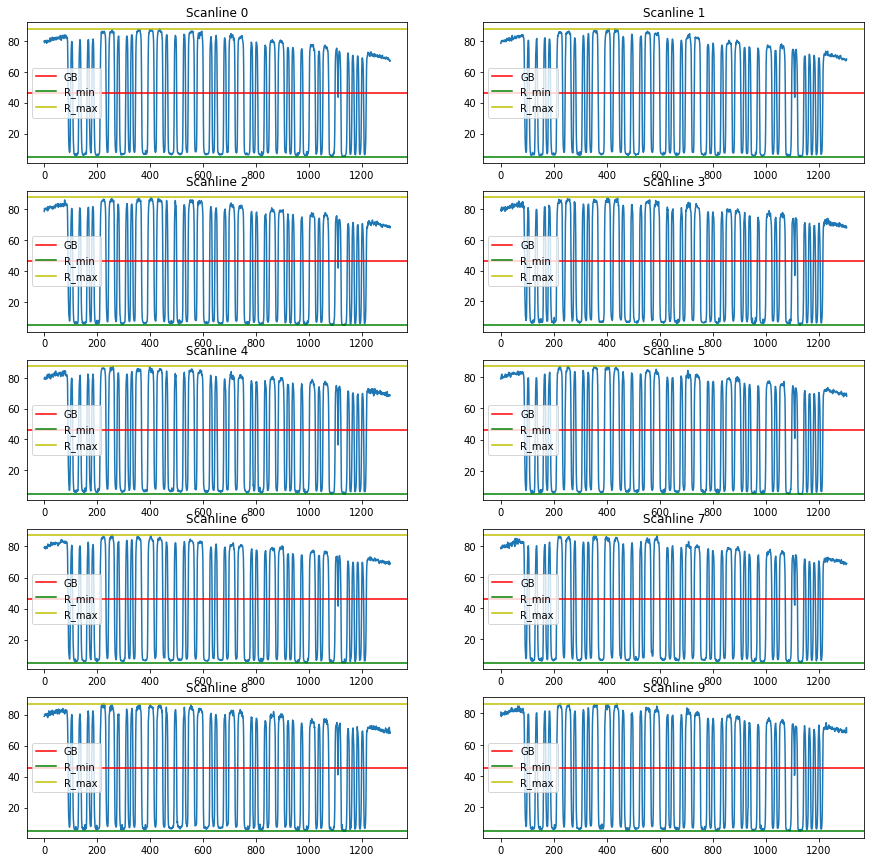

In [36]:
# TEST CHART SC: 77.8. GRADE 'A'
# MINE SC: 82.51. GRADE 'A'
# OK

%matplotlib inline  
compute_visualize_RminSC(f'../images/{images_paths[18]}')

Image path: ../images/I25-LOW DECODABILITY IMGB.BMP

R_min_list: [4.705882352941177, 4.313725490196078, 4.705882352941177, 4.705882352941177, 4.705882352941177, 4.705882352941177, 4.313725490196078, 4.705882352941177, 4.705882352941177, 4.705882352941177]
R_min mean: 4.627450980392156

R_max_list: [89.80392156862746, 89.01960784313725, 89.01960784313725, 88.62745098039215, 89.80392156862746, 89.41176470588236, 88.23529411764706, 87.84313725490196, 87.45098039215686, 88.62745098039215]
R_max mean: 88.7843137254902

R_min_grade: A

SC_list: [85.09803921568628, 84.70588235294117, 84.31372549019608, 83.92156862745098, 85.09803921568628, 84.70588235294119, 83.92156862745098, 83.13725490196079, 82.74509803921569, 83.92156862745098]
SC mean: 84.15686274509804
SC_grade: A

GB_list: [47.254901960784316, 46.666666666666664, 46.86274509803921, 46.666666666666664, 47.254901960784316, 47.05882352941177, 46.27450980392157, 46.27450980392157, 46.07843137254902, 46.666666666666664]
GB mean: 46.7058823

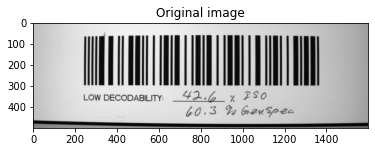

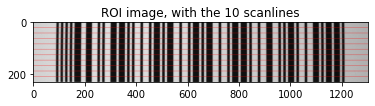

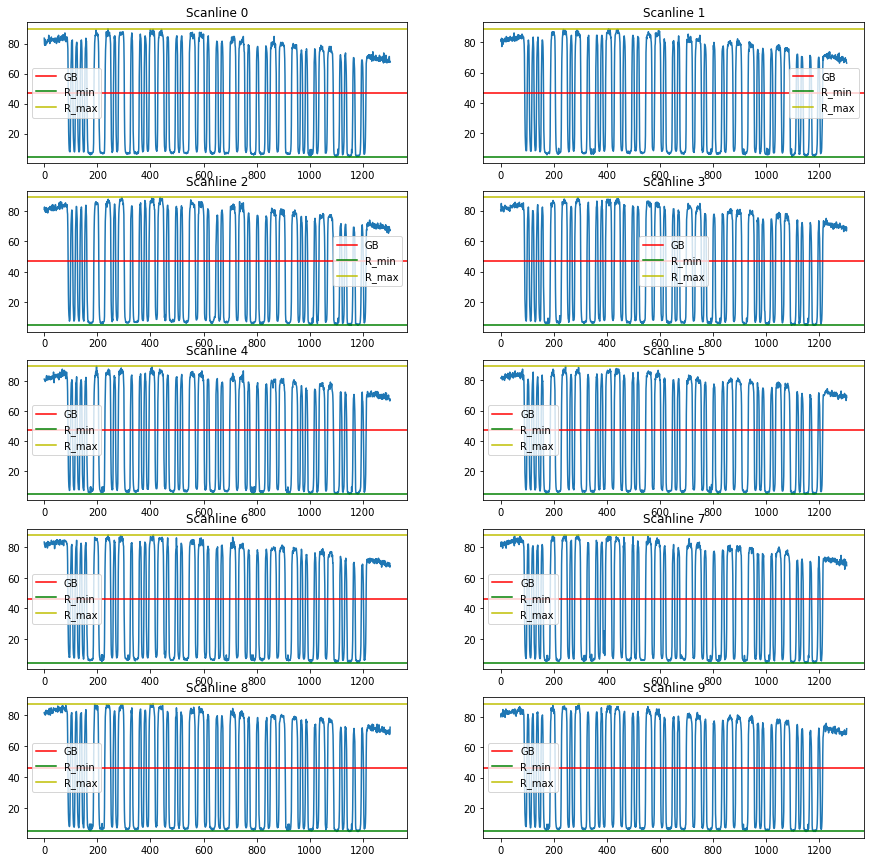

In [37]:
# TEST CHART SC: 77.8. GRADE 'A'
# MINE SC: 84.15. GRADE 'A'
# OK

%matplotlib inline  
compute_visualize_RminSC(f'../images/{images_paths[19]}')

Image path: ../images/I25-MASTER GRADE IMGB.BMP

R_min_list: [4.705882352941177, 4.705882352941177, 4.705882352941177, 4.705882352941177, 4.313725490196078, 4.313725490196078, 4.705882352941177, 4.705882352941177, 4.705882352941177, 4.705882352941177]
R_min mean: 4.627450980392156

R_max_list: [87.05882352941177, 86.27450980392157, 86.27450980392157, 86.66666666666667, 86.66666666666667, 86.66666666666667, 86.27450980392157, 85.88235294117646, 85.88235294117646, 86.27450980392157]
R_max mean: 86.3921568627451

R_min_grade: A

SC_list: [82.3529411764706, 81.5686274509804, 81.5686274509804, 81.9607843137255, 82.3529411764706, 82.3529411764706, 81.5686274509804, 81.17647058823529, 81.17647058823529, 81.5686274509804]
SC mean: 81.76470588235296
SC_grade: A

GB_list: [45.88235294117647, 45.490196078431374, 45.490196078431374, 45.68627450980392, 45.490196078431374, 45.490196078431374, 45.490196078431374, 45.29411764705882, 45.29411764705882, 45.490196078431374]
GB mean: 45.50980392156863


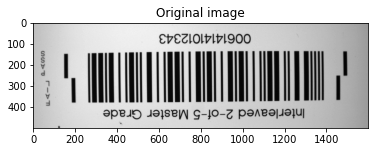

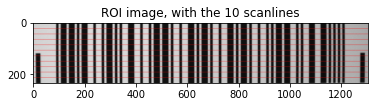

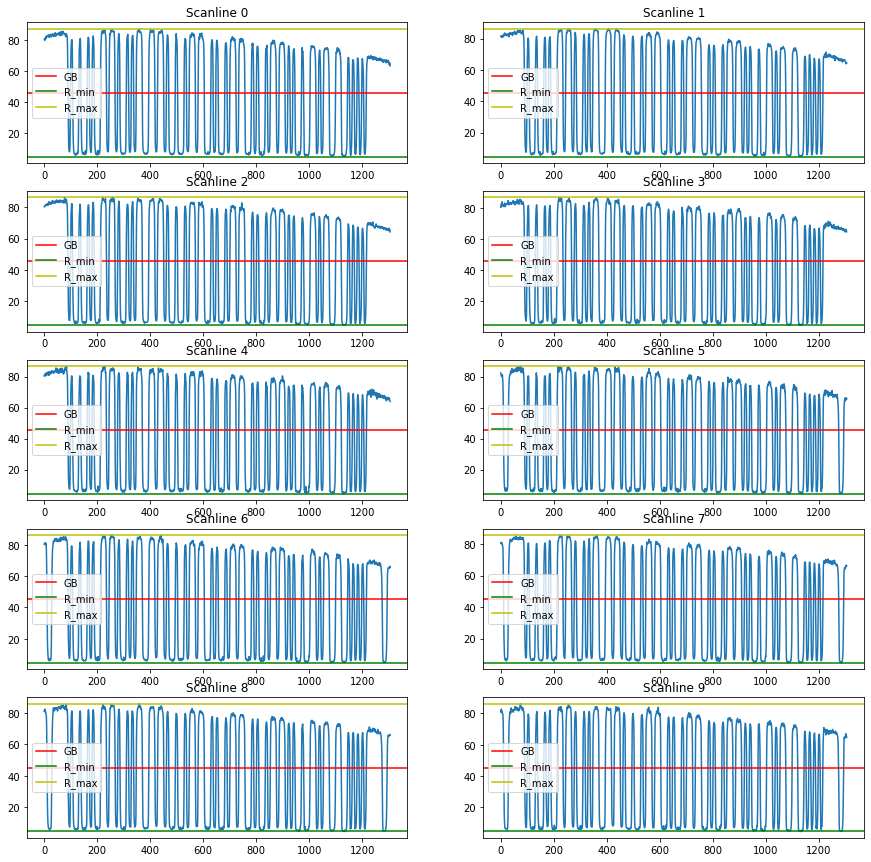

In [38]:
# TEST CHART SC: 77.9. GRADE 'A'
# MINE SC: 81.74. GRADE 'A'
# OK

%matplotlib inline  
compute_visualize_RminSC(f'../images/{images_paths[20]}')

Image path: ../images/UPC#01.BMP

R_min_list: [13.333333333333334, 13.333333333333334, 13.333333333333334, 13.333333333333334, 12.941176470588237, 13.333333333333334, 13.333333333333334, 13.333333333333334, 13.333333333333334, 14.117647058823529]
R_min mean: 13.372549019607842

R_max_list: [87.84313725490196, 88.23529411764706, 89.41176470588236, 90.19607843137256, 90.58823529411765, 90.58823529411765, 90.98039215686275, 91.37254901960785, 92.15686274509804, 92.54901960784314]
R_max mean: 90.3921568627451

R_min_grade: A

SC_list: [74.50980392156863, 74.90196078431373, 76.07843137254903, 76.86274509803923, 77.64705882352942, 77.25490196078432, 77.64705882352942, 78.03921568627452, 78.82352941176471, 78.43137254901961]
SC mean: 77.01960784313727
SC_grade: A

GB_list: [50.58823529411765, 50.7843137254902, 51.37254901960785, 51.76470588235295, 51.76470588235295, 51.9607843137255, 52.156862745098046, 52.352941176470594, 52.74509803921569, 53.333333333333336]
GB mean: 51.88235294117648


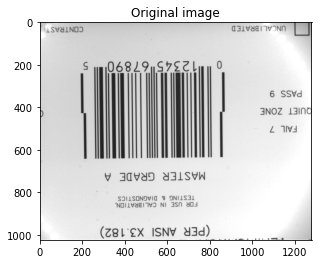

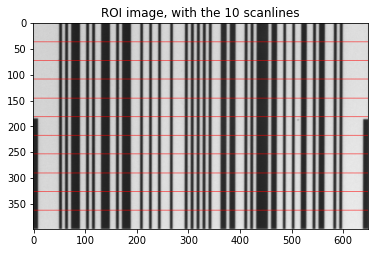

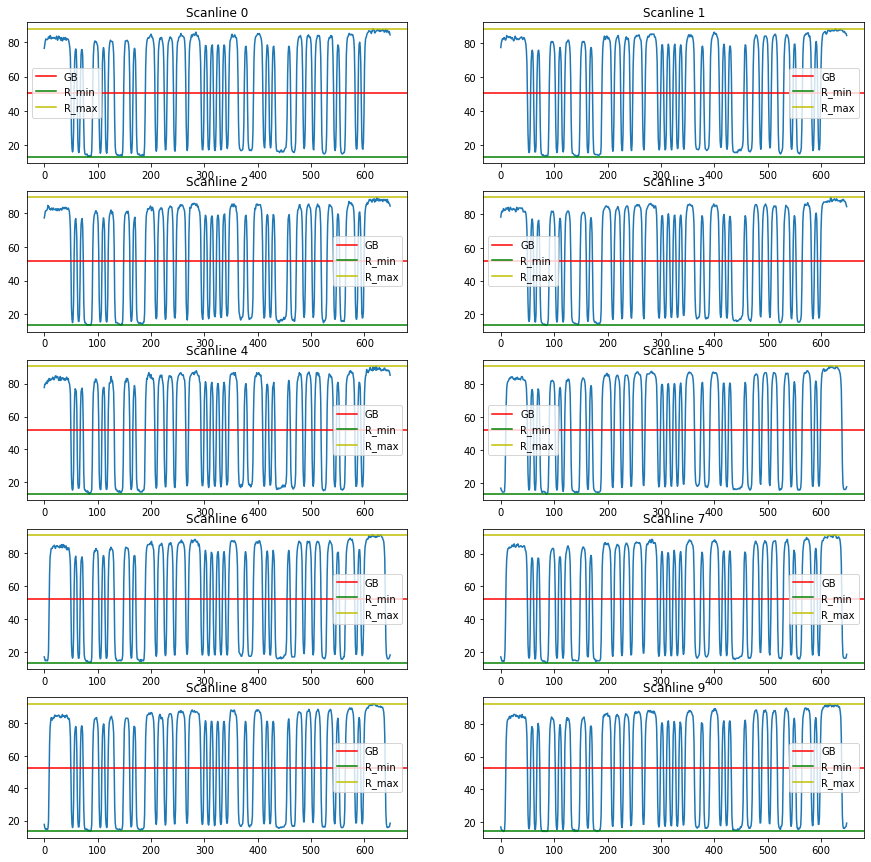

In [39]:
# TEST CHART SC: 75. GRADE 'A'
# MINE SC: 77.02. GRADE 'A'
# OK

%matplotlib inline  
compute_visualize_RminSC(f'../images/{images_paths[22]}')

Image path: ../images/UPC#03.BMP

R_min_list: [9.411764705882353, 9.411764705882353, 9.411764705882353, 9.411764705882353, 9.803921568627452, 9.803921568627452, 9.803921568627452, 9.803921568627452, 9.803921568627452, 9.803921568627452]
R_min mean: 9.647058823529415

R_max_list: [87.45098039215686, 88.23529411764706, 88.23529411764706, 90.58823529411765, 89.80392156862746, 89.41176470588236, 89.80392156862746, 89.80392156862746, 89.41176470588236, 89.01960784313725]
R_max mean: 89.17647058823529

R_min_grade: A

SC_list: [78.03921568627452, 78.82352941176471, 78.82352941176471, 81.1764705882353, 80.0, 79.60784313725492, 80.0, 80.0, 79.60784313725492, 79.2156862745098]
SC mean: 79.52941176470588
SC_grade: A

GB_list: [48.43137254901961, 48.82352941176471, 48.82352941176471, 50.00000000000001, 49.80392156862745, 49.60784313725491, 49.80392156862745, 49.80392156862745, 49.60784313725491, 49.411764705882355]
GB mean: 49.41176470588236


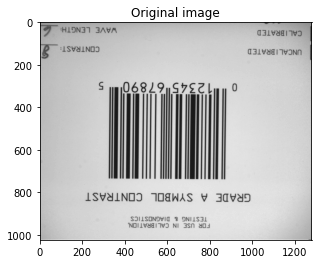

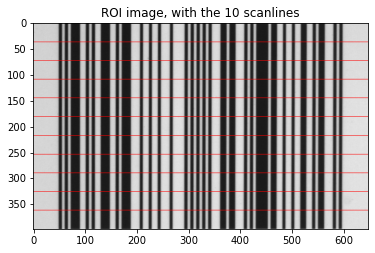

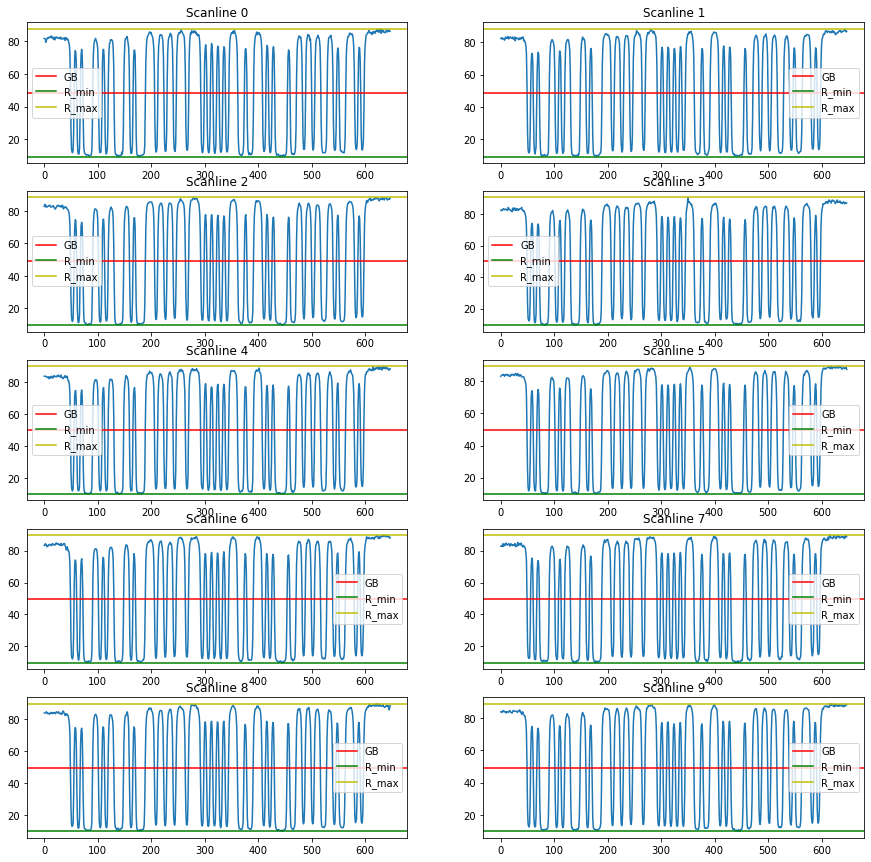

In [40]:
# TEST CHART SC: 83.6. GRADE 'A'
# MINE SC: 79.53. GRADE 'A'
# OK

%matplotlib inline  
compute_visualize_RminSC(f'../images/{images_paths[23]}')

Image path: ../images/UPC#04.BMP

R_min_list: [11.372549019607844, 11.76470588235294, 11.76470588235294, 12.156862745098039, 12.156862745098039, 12.549019607843137, 12.156862745098039, 12.549019607843137, 12.156862745098039, 12.549019607843137]
R_min mean: 12.117647058823529

R_max_list: [77.64705882352942, 78.82352941176471, 78.82352941176471, 78.43137254901961, 78.82352941176471, 80.0, 80.3921568627451, 80.0, 80.3921568627451, 80.3921568627451]
R_max mean: 79.37254901960785

R_min_grade: A

SC_list: [66.27450980392157, 67.05882352941177, 67.05882352941177, 66.27450980392157, 66.66666666666667, 67.45098039215686, 68.23529411764706, 67.45098039215686, 68.23529411764706, 67.84313725490196]
SC mean: 67.25490196078432
SC_grade: B

GB_list: [44.50980392156863, 45.294117647058826, 45.294117647058826, 45.294117647058826, 45.490196078431374, 46.27450980392157, 46.27450980392157, 46.27450980392157, 46.27450980392157, 46.470588235294116]
GB mean: 45.74509803921569


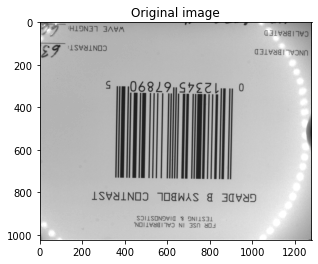

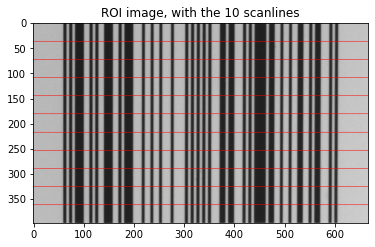

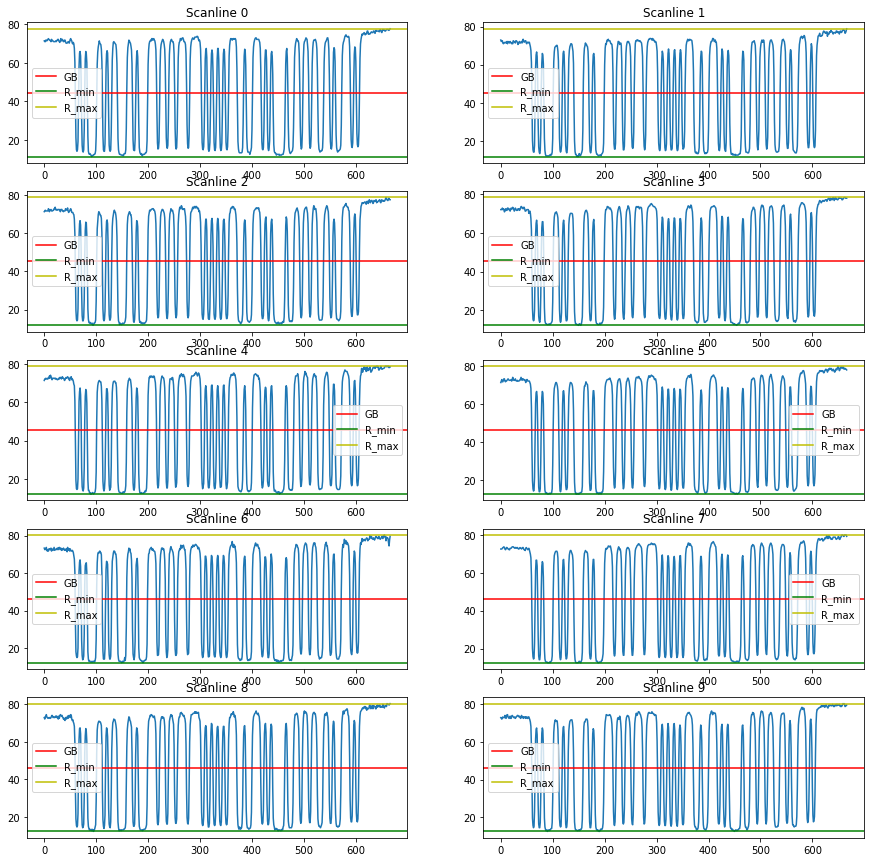

In [41]:
# TEST CHART SC: 63. GRADE 'B'
# MINE SC: 67.25. GRADE 'B'
# OK

%matplotlib inline  
compute_visualize_RminSC(f'../images/{images_paths[24]}')

Image path: ../images/UPC#05.BMP

R_min_list: [16.470588235294116, 16.470588235294116, 16.07843137254902, 16.470588235294116, 16.862745098039216, 16.470588235294116, 16.862745098039216, 16.862745098039216, 17.254901960784313, 17.647058823529413]
R_min mean: 16.745098039215687

R_max_list: [66.27450980392156, 66.66666666666666, 67.45098039215686, 67.84313725490196, 68.23529411764706, 68.62745098039215, 69.41176470588235, 68.62745098039215, 69.01960784313725, 69.41176470588235]
R_max mean: 68.15686274509804

R_min_grade: A

SC_list: [49.803921568627445, 50.19607843137254, 51.372549019607845, 51.372549019607845, 51.372549019607845, 52.15686274509804, 52.549019607843135, 51.76470588235294, 51.76470588235294, 51.764705882352935]
SC mean: 51.411764705882355
SC_grade: C

GB_list: [41.37254901960784, 41.56862745098039, 41.76470588235294, 42.15686274509804, 42.549019607843135, 42.549019607843135, 43.13725490196079, 42.74509803921569, 43.13725490196079, 43.529411764705884]
GB mean: 42.4509803921

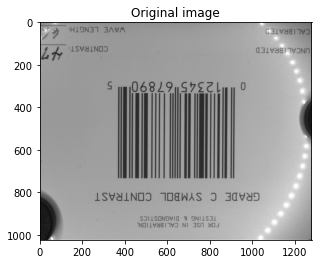

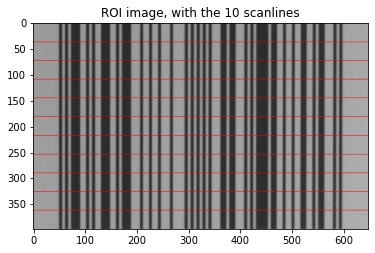

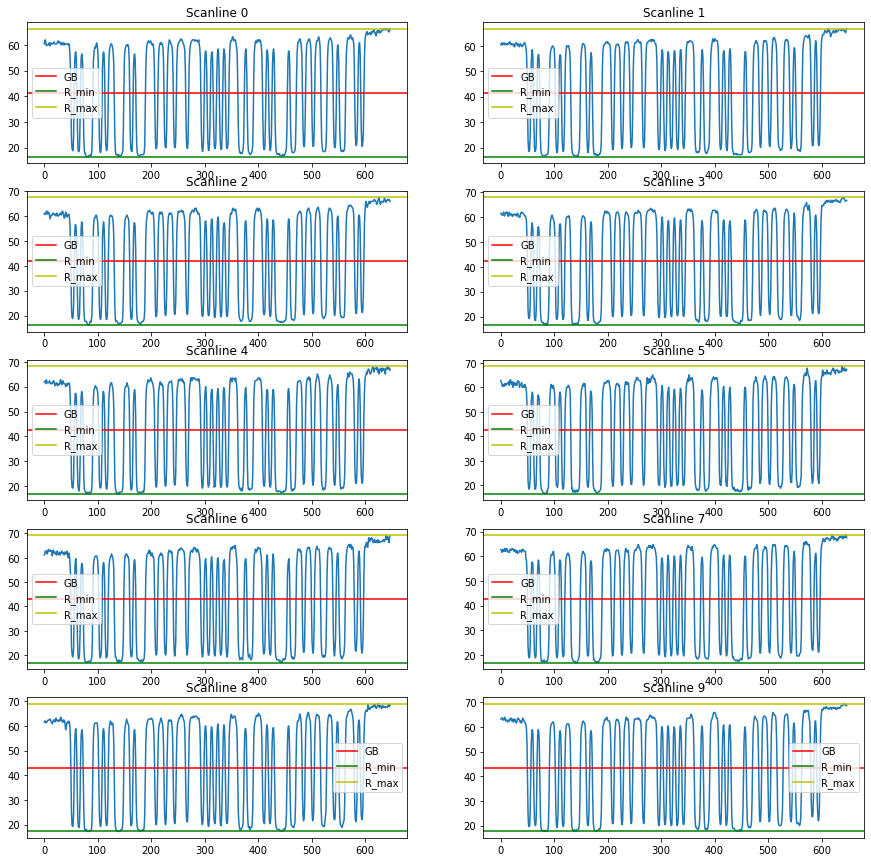

In [42]:
# TEST CHART SC: 47.7. GRADE 'C'
# MINE SC: 51.41. GRADE 'C'
# OK

%matplotlib inline  
compute_visualize_RminSC(f'../images/{images_paths[25]}')

Image path: ../images/UPC#06.BMP

R_min_list: [16.862745098039216, 16.862745098039216, 16.862745098039216, 16.862745098039216, 16.862745098039216, 16.862745098039216, 16.862745098039216, 16.862745098039216, 17.254901960784313, 16.862745098039216]
R_min mean: 16.901960784313726

R_max_list: [52.156862745098046, 53.333333333333336, 53.72549019607843, 54.509803921568626, 53.333333333333336, 54.11764705882353, 53.72549019607843, 54.509803921568626, 53.72549019607843, 54.509803921568626]
R_max mean: 53.76470588235295

R_min_grade: A

SC_list: [35.294117647058826, 36.470588235294116, 36.86274509803921, 37.647058823529406, 36.470588235294116, 37.25490196078431, 36.86274509803921, 37.647058823529406, 36.470588235294116, 37.647058823529406]
SC mean: 36.86274509803921
SC_grade: D

GB_list: [34.50980392156863, 35.09803921568627, 35.294117647058826, 35.68627450980392, 35.09803921568627, 35.49019607843137, 35.294117647058826, 35.68627450980392, 35.49019607843137, 35.68627450980392]
GB mean: 35.3333

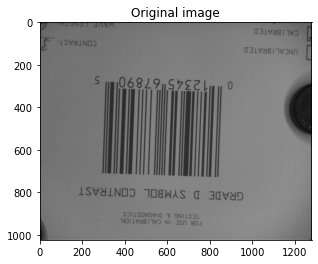

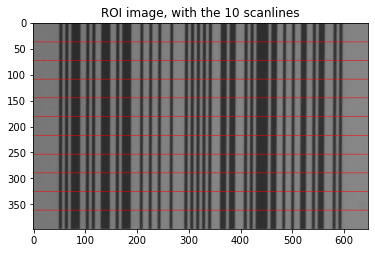

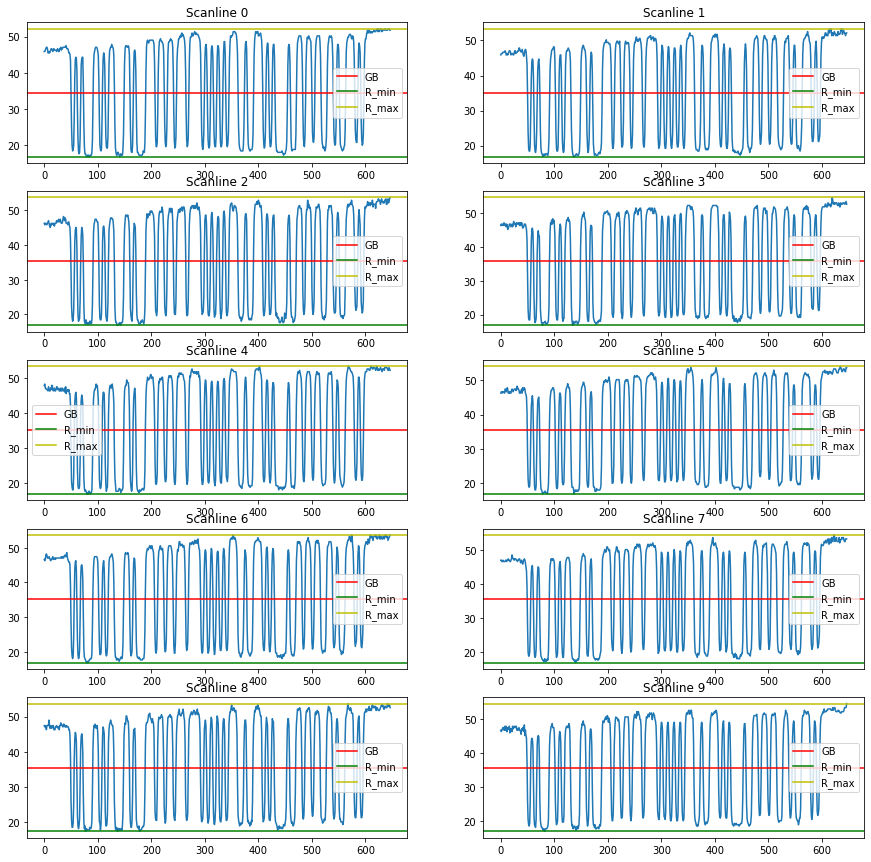

In [43]:
# TEST CHART SC: 38.2. GRADE 'D'
# MINE SC: 36.8. GRADE 'D'
# OK

%matplotlib inline  
compute_visualize_RminSC(f'../images/{images_paths[26]}')

Image path: ../images/UPC#07.BMP

R_min_list: [16.470588235294116, 16.470588235294116, 16.470588235294116, 16.470588235294116, 16.862745098039216, 16.862745098039216, 16.470588235294116, 16.862745098039216, 16.862745098039216, 16.862745098039216]
R_min mean: 16.666666666666668

R_max_list: [32.94117647058823, 33.72549019607843, 33.33333333333333, 33.33333333333333, 34.11764705882353, 34.509803921568626, 33.72549019607843, 33.72549019607843, 34.509803921568626, 33.72549019607843]
R_max mean: 33.76470588235294

R_min_grade: A

SC_list: [16.470588235294116, 17.254901960784316, 16.862745098039213, 16.862745098039213, 17.254901960784313, 17.64705882352941, 17.254901960784316, 16.862745098039216, 17.64705882352941, 16.862745098039216]
SC mean: 17.098039215686278
SC_grade: F

GB_list: [24.705882352941174, 25.098039215686274, 24.901960784313722, 24.901960784313722, 25.490196078431374, 25.686274509803923, 25.098039215686274, 25.294117647058826, 25.686274509803923, 25.294117647058826]
GB mean: 2

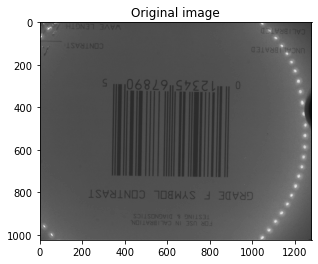

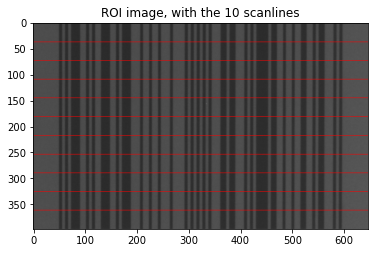

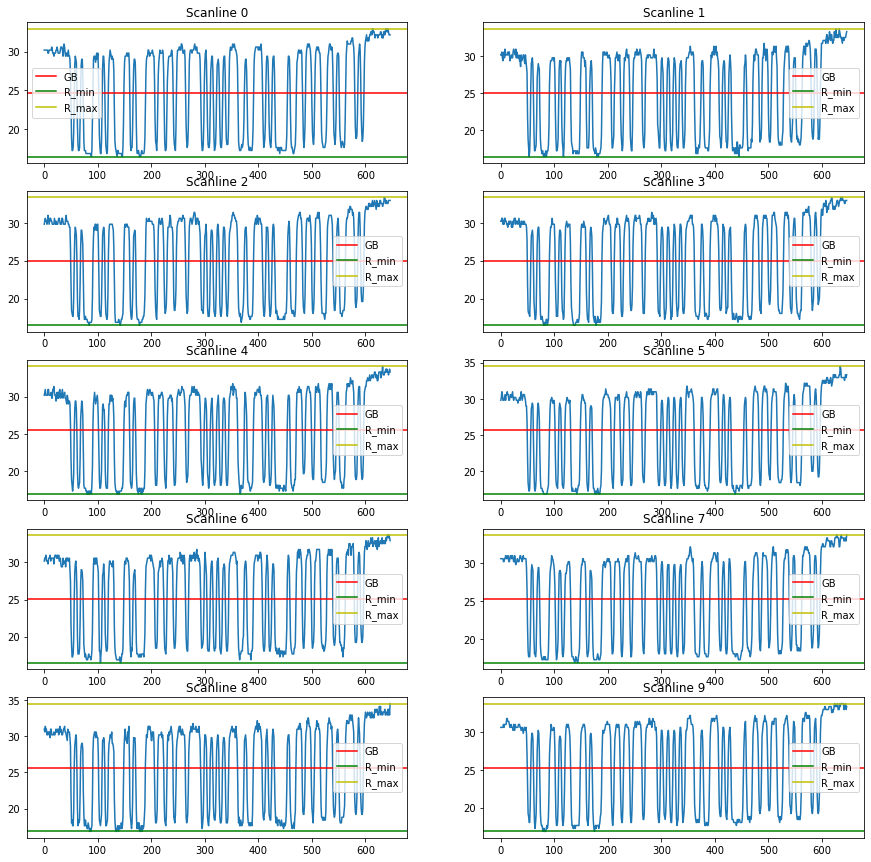

In [45]:
# TEST CHART SC: 15. GRADE 'F'
# MINE SC: 17.09. GRADE 'F'
# OK

%matplotlib inline  
compute_visualize_RminSC(f'../images/{images_paths[27]}')

Image path: ../images/UPC#08.BMP

R_min_list: [13.725490196078432, 13.725490196078432, 13.333333333333334, 13.725490196078432, 13.725490196078432, 14.117647058823529, 13.725490196078432, 14.117647058823529, 14.117647058823529, 13.725490196078432]
R_min mean: 13.80392156862745

R_max_list: [90.58823529411765, 91.76470588235294, 92.15686274509804, 92.54901960784314, 93.33333333333333, 93.33333333333333, 93.72549019607843, 93.33333333333333, 93.72549019607843, 94.11764705882352]
R_max mean: 92.86274509803921

R_min_grade: A

SC_list: [76.86274509803923, 78.0392156862745, 78.82352941176471, 78.8235294117647, 79.60784313725489, 79.2156862745098, 80.0, 79.2156862745098, 79.60784313725489, 80.39215686274508]
SC mean: 79.05882352941175
SC_grade: A

GB_list: [52.156862745098046, 52.745098039215684, 52.74509803921569, 53.13725490196078, 53.52941176470588, 53.72549019607843, 53.72549019607843, 53.72549019607843, 53.921568627450974, 53.921568627450974]
GB mean: 53.333333333333336


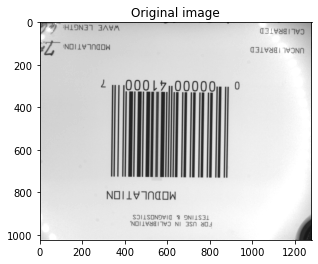

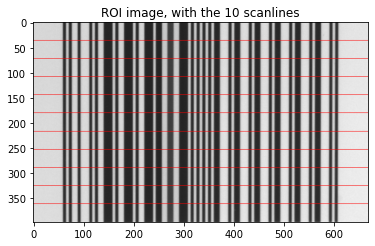

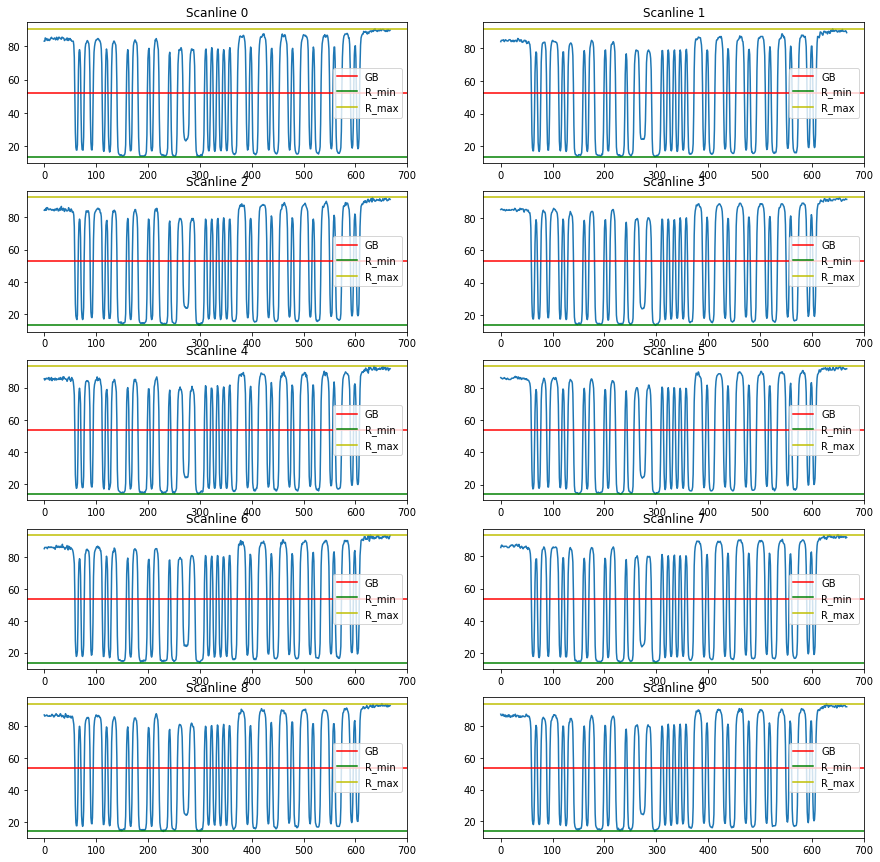

In [46]:
# TEST CHART SC: 74.4. GRADE 'A'
# MINE SC: 79.05. GRADE 'A'
# OK

%matplotlib inline  
compute_visualize_RminSC(f'../images/{images_paths[28]}')

Image path: ../images/UPC#09.BMP

R_min_list: [13.725490196078432, 13.725490196078432, 12.941176470588237, 13.725490196078432, 14.117647058823529, 14.117647058823529, 14.117647058823529, 14.50980392156863, 13.725490196078432, 14.50980392156863]
R_min mean: 13.92156862745098

R_max_list: [90.98039215686275, 92.15686274509804, 91.76470588235294, 92.15686274509804, 92.94117647058823, 92.94117647058823, 93.72549019607843, 94.90196078431372, 94.50980392156862, 94.90196078431372]
R_max mean: 93.09803921568627

R_min_grade: A

SC_list: [77.25490196078431, 78.43137254901961, 78.82352941176471, 78.43137254901961, 78.8235294117647, 78.8235294117647, 79.60784313725489, 80.39215686274508, 80.7843137254902, 80.39215686274508]
SC mean: 79.17647058823528
SC_grade: A

GB_list: [52.35294117647059, 52.94117647058824, 52.352941176470594, 52.94117647058824, 53.52941176470588, 53.52941176470588, 53.921568627450974, 54.705882352941174, 54.11764705882353, 54.705882352941174]
GB mean: 53.50980392156863


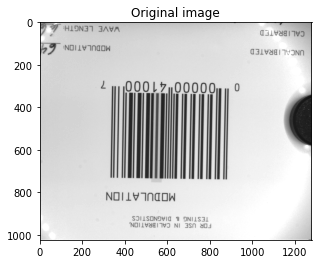

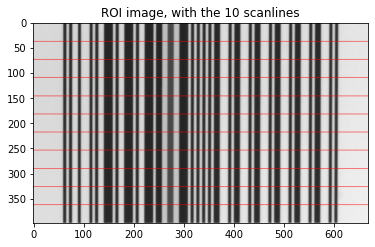

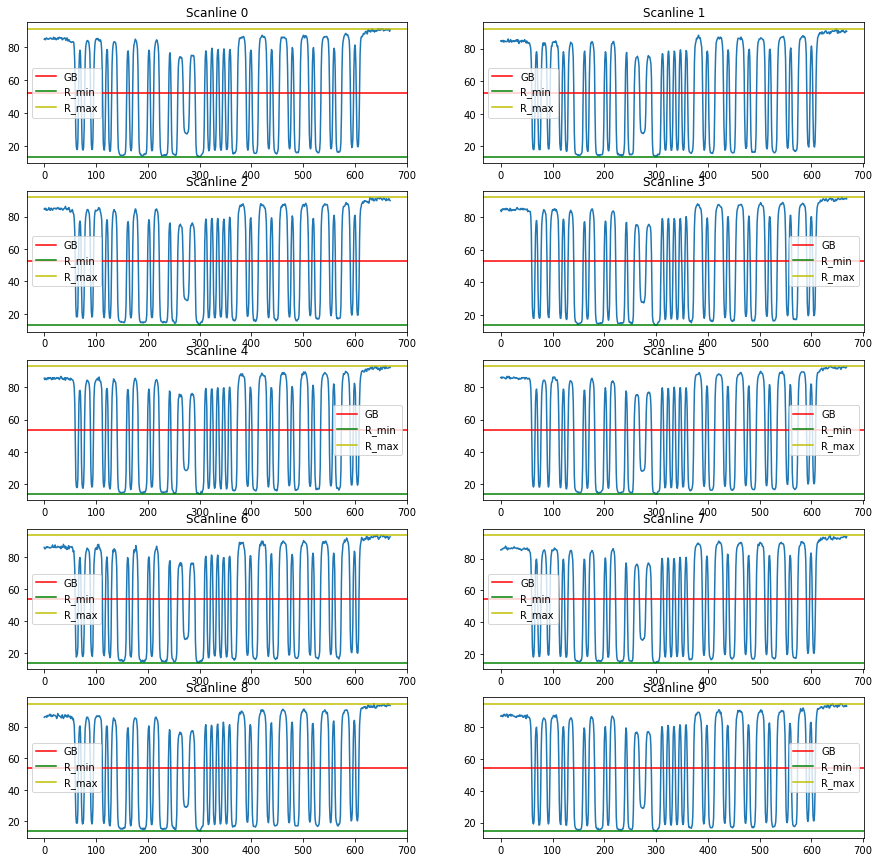

In [47]:
# TEST CHART SC: 75.7. GRADE 'A'
# MINE SC: 79.17. GRADE 'A'
# OK

%matplotlib inline  
compute_visualize_RminSC(f'../images/{images_paths[29]}')

Image path: ../images/UPC#10.BMP

R_min_list: [13.725490196078432, 13.725490196078432, 13.725490196078432, 14.50980392156863, 14.117647058823529, 14.117647058823529, 14.50980392156863, 14.50980392156863, 14.117647058823529, 14.50980392156863]
R_min mean: 14.156862745098039

R_max_list: [92.15686274509804, 94.11764705882352, 92.94117647058823, 93.33333333333333, 93.33333333333333, 94.50980392156862, 94.90196078431372, 94.50980392156862, 94.50980392156862, 94.90196078431372]
R_max mean: 93.92156862745097

R_min_grade: A

SC_list: [78.43137254901961, 80.39215686274508, 79.2156862745098, 78.8235294117647, 79.2156862745098, 80.39215686274508, 80.39215686274508, 79.99999999999999, 80.39215686274508, 80.39215686274508]
SC mean: 79.76470588235294
SC_grade: A

GB_list: [52.94117647058824, 53.921568627450974, 53.333333333333336, 53.92156862745098, 53.72549019607843, 54.31372549019607, 54.705882352941174, 54.50980392156862, 54.31372549019607, 54.705882352941174]
GB mean: 54.03921568627451


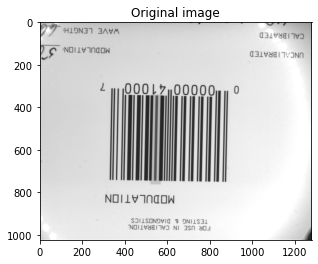

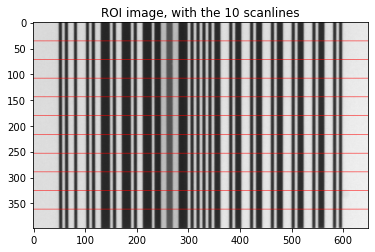

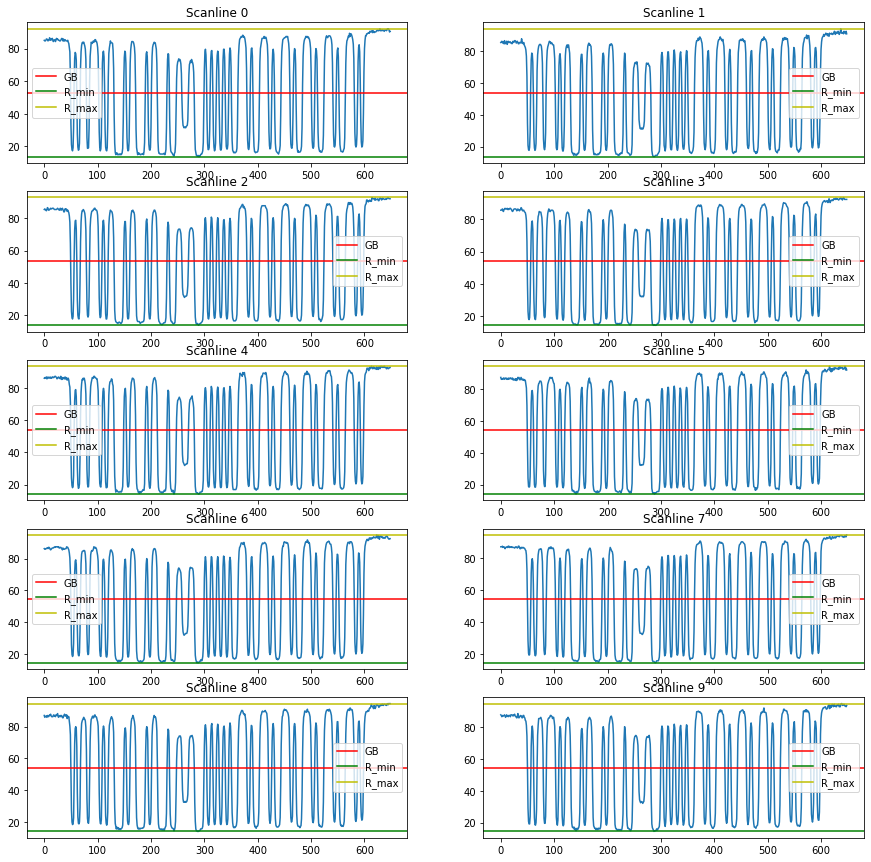

In [48]:
# TEST CHART SC: 75.8. GRADE 'A'
# MINE SC: 79.76. GRADE 'A'
# OK

%matplotlib inline  
compute_visualize_RminSC(f'../images/{images_paths[30]}')

Image path: ../images/UPC#11.BMP

R_min_list: [10.196078431372548, 10.588235294117647, 10.196078431372548, 10.196078431372548, 9.803921568627452, 10.196078431372548, 10.196078431372548, 10.980392156862745, 10.588235294117647, 10.588235294117647]
R_min mean: 10.352941176470589

R_max_list: [87.45098039215686, 87.45098039215686, 88.62745098039215, 89.01960784313725, 90.19607843137256, 89.41176470588236, 90.58823529411765, 89.80392156862746, 90.19607843137256, 89.80392156862746]
R_max mean: 89.25490196078431

R_min_grade: A

SC_list: [77.25490196078431, 76.86274509803921, 78.43137254901961, 78.8235294117647, 80.39215686274511, 79.2156862745098, 80.39215686274511, 78.82352941176471, 79.6078431372549, 79.2156862745098]
SC mean: 78.90196078431373
SC_grade: A

GB_list: [48.8235294117647, 49.01960784313725, 49.411764705882355, 49.607843137254896, 50.00000000000001, 49.80392156862745, 50.392156862745104, 50.3921568627451, 50.3921568627451, 50.19607843137255]
GB mean: 49.80392156862745


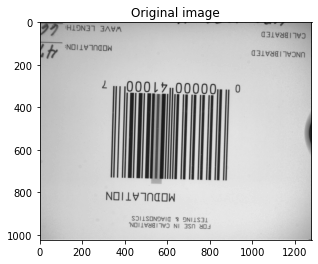

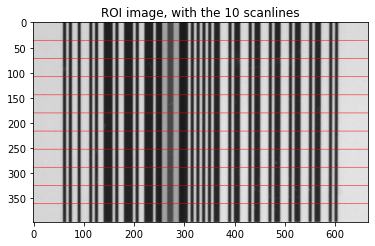

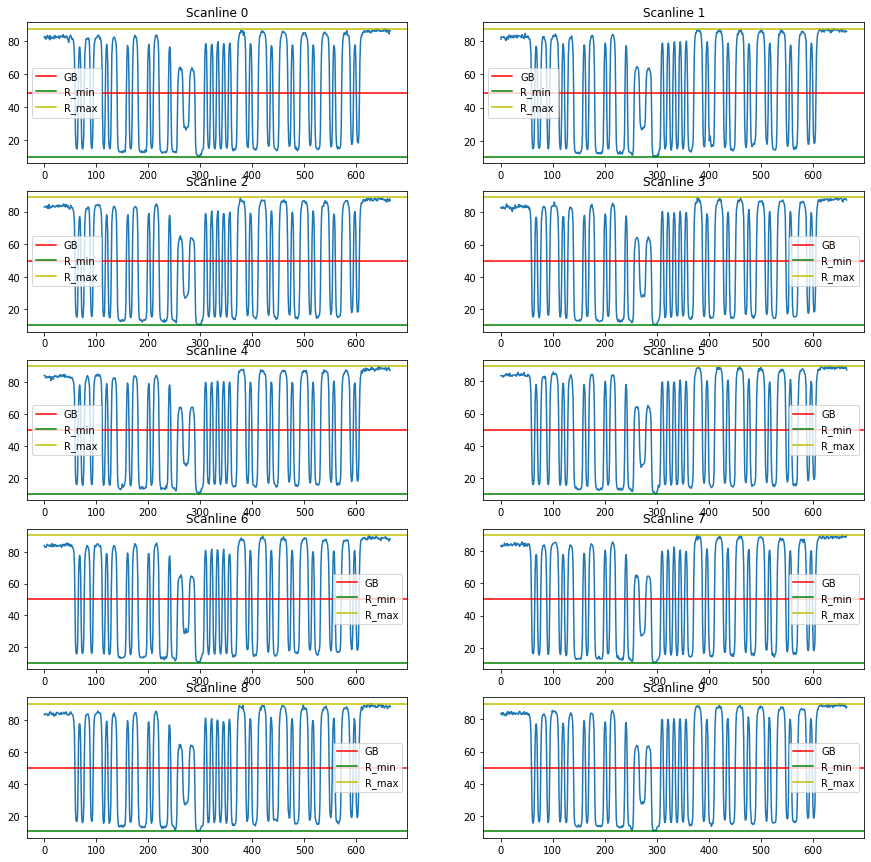

In [49]:
# TEST CHART SC: 82.6. GRADE 'A'
# MINE SC: 78.9. GRADE 'A'
# OK

%matplotlib inline  
compute_visualize_RminSC(f'../images/{images_paths[31]}')

Image path: ../images/UPC#12.BMP

R_min_list: [11.76470588235294, 11.76470588235294, 12.156862745098039, 12.156862745098039, 12.156862745098039, 12.549019607843137, 12.941176470588237, 12.156862745098039, 12.549019607843137, 12.156862745098039]
R_min mean: 12.23529411764706

R_max_list: [90.98039215686275, 92.15686274509804, 92.54901960784314, 93.33333333333333, 94.11764705882352, 94.50980392156862, 94.50980392156862, 95.29411764705881, 95.29411764705881, 95.68627450980392]
R_max mean: 93.84313725490195

R_min_grade: A

SC_list: [79.2156862745098, 80.3921568627451, 80.3921568627451, 81.17647058823529, 81.96078431372548, 81.96078431372548, 81.56862745098039, 83.13725490196077, 82.74509803921568, 83.52941176470588]
SC mean: 81.60784313725489
SC_grade: A

GB_list: [51.372549019607845, 51.96078431372549, 52.35294117647059, 52.745098039215684, 53.13725490196078, 53.52941176470588, 53.72549019607843, 53.725490196078425, 53.921568627450974, 53.92156862745098]
GB mean: 53.03921568627451


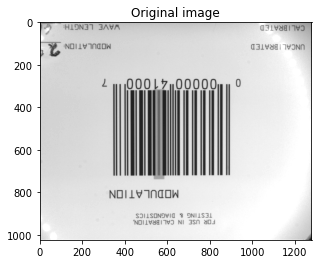

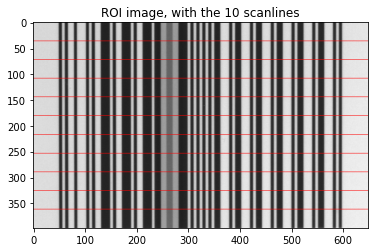

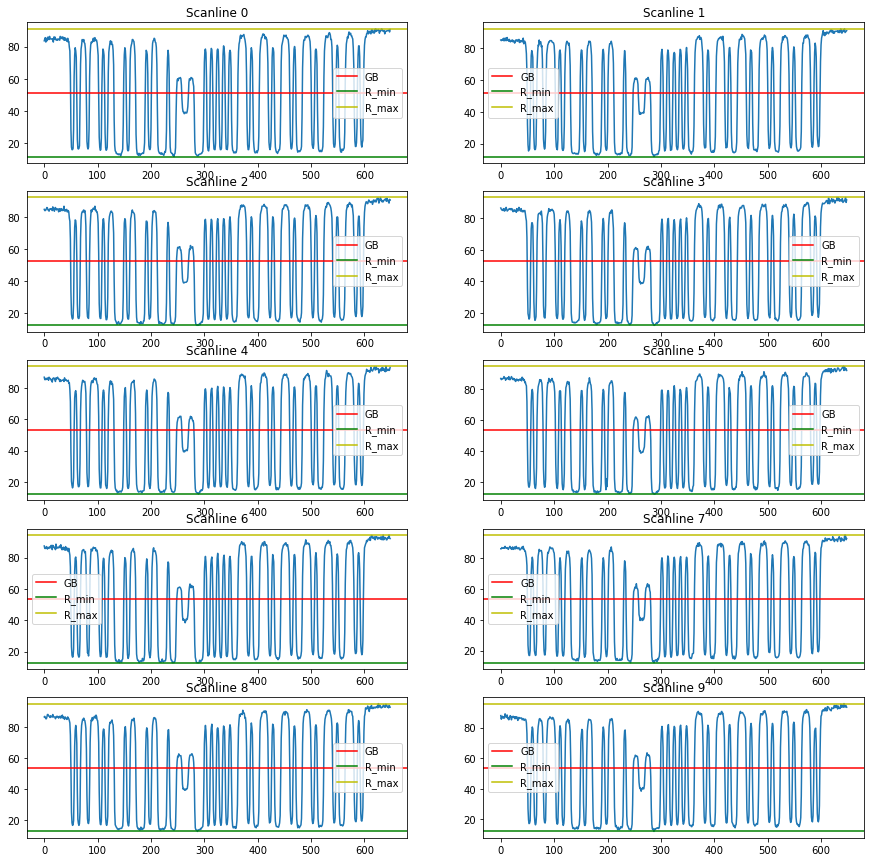

In [50]:
# TEST CHART SC: 76.4. GRADE 'A'
# MINE SC: 81.61. GRADE 'A'
# OK

%matplotlib inline  
compute_visualize_RminSC(f'../images/{images_paths[32]}')

Image path: ../images/UPC#13.BMP

R_min_list: [10.980392156862745, 10.980392156862745, 10.980392156862745, 10.980392156862745, 11.372549019607844, 11.372549019607844, 11.372549019607844, 10.980392156862745, 11.372549019607844, 11.76470588235294]
R_min mean: 11.215686274509803

R_max_list: [90.19607843137256, 90.98039215686275, 91.37254901960785, 92.15686274509804, 92.15686274509804, 92.54901960784314, 92.94117647058823, 93.33333333333333, 92.94117647058823, 93.72549019607843]
R_max mean: 92.23529411764707

R_min_grade: A

SC_list: [79.2156862745098, 80.0, 80.3921568627451, 81.17647058823529, 80.7843137254902, 81.17647058823529, 81.56862745098039, 82.35294117647058, 81.56862745098039, 81.96078431372548]
SC mean: 81.01960784313727
SC_grade: A

GB_list: [50.58823529411765, 50.98039215686275, 51.17647058823529, 51.56862745098039, 51.76470588235294, 51.96078431372549, 52.15686274509804, 52.15686274509804, 52.15686274509804, 52.745098039215684]
GB mean: 51.72549019607843


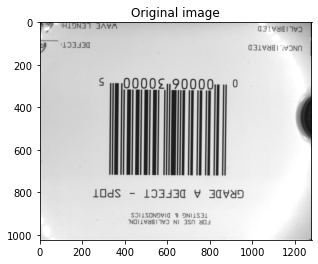

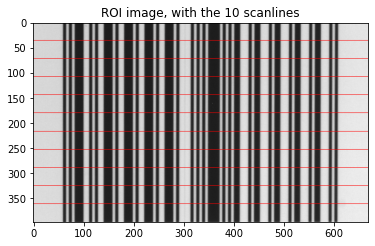

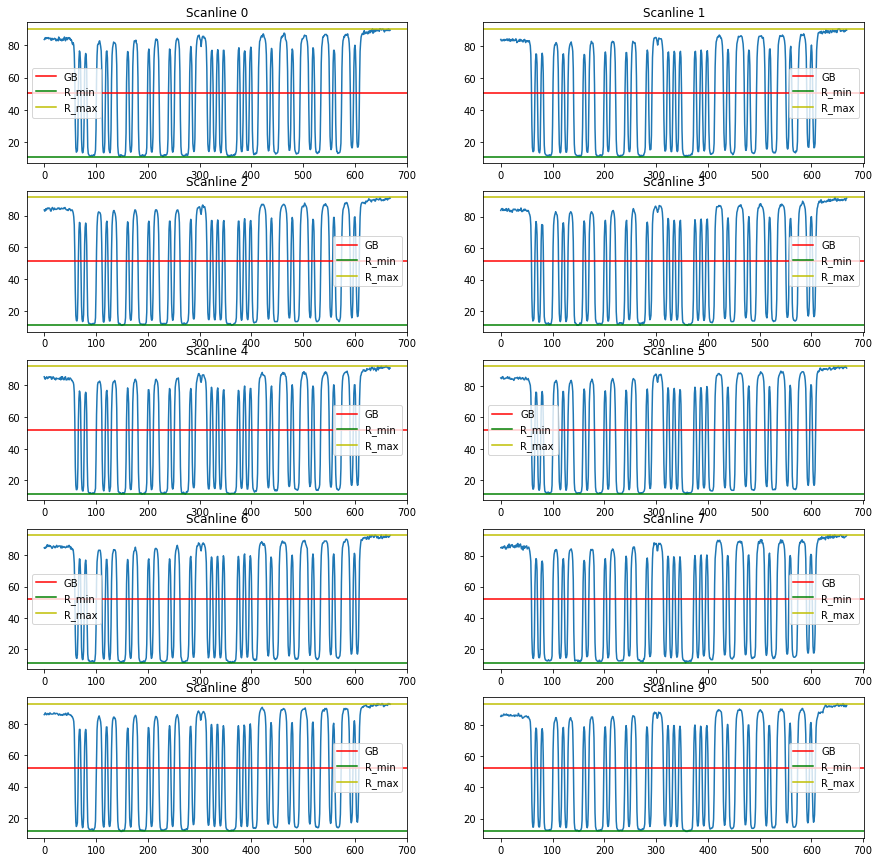

In [51]:
# TEST CHART SC: 76.5. GRADE 'A'
# MINE SC: 81.02. GRADE 'A'
# OK

%matplotlib inline  
compute_visualize_RminSC(f'../images/{images_paths[33]}')

Image path: ../images/UPC#14.BMP

R_min_list: [13.725490196078432, 14.117647058823529, 14.117647058823529, 14.117647058823529, 14.117647058823529, 14.117647058823529, 14.117647058823529, 14.117647058823529, 14.50980392156863, 14.50980392156863]
R_min mean: 14.156862745098039

R_max_list: [91.37254901960785, 92.54901960784314, 92.15686274509804, 93.72549019607843, 94.11764705882352, 94.50980392156862, 94.11764705882352, 94.90196078431372, 94.90196078431372, 94.90196078431372]
R_max mean: 93.72549019607843

R_min_grade: A

SC_list: [77.64705882352942, 78.43137254901961, 78.0392156862745, 79.60784313725489, 80.0, 80.39215686274508, 80.0, 80.7843137254902, 80.39215686274508, 80.39215686274508]
SC mean: 79.56862745098039
SC_grade: A

GB_list: [52.54901960784314, 53.333333333333336, 53.13725490196078, 53.921568627450974, 54.11764705882353, 54.31372549019607, 54.11764705882353, 54.509803921568626, 54.705882352941174, 54.705882352941174]
GB mean: 53.94117647058823


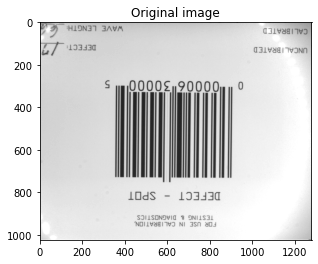

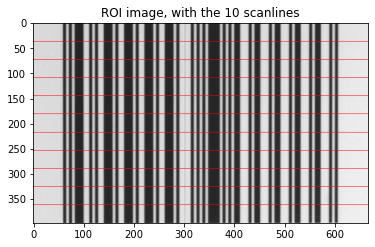

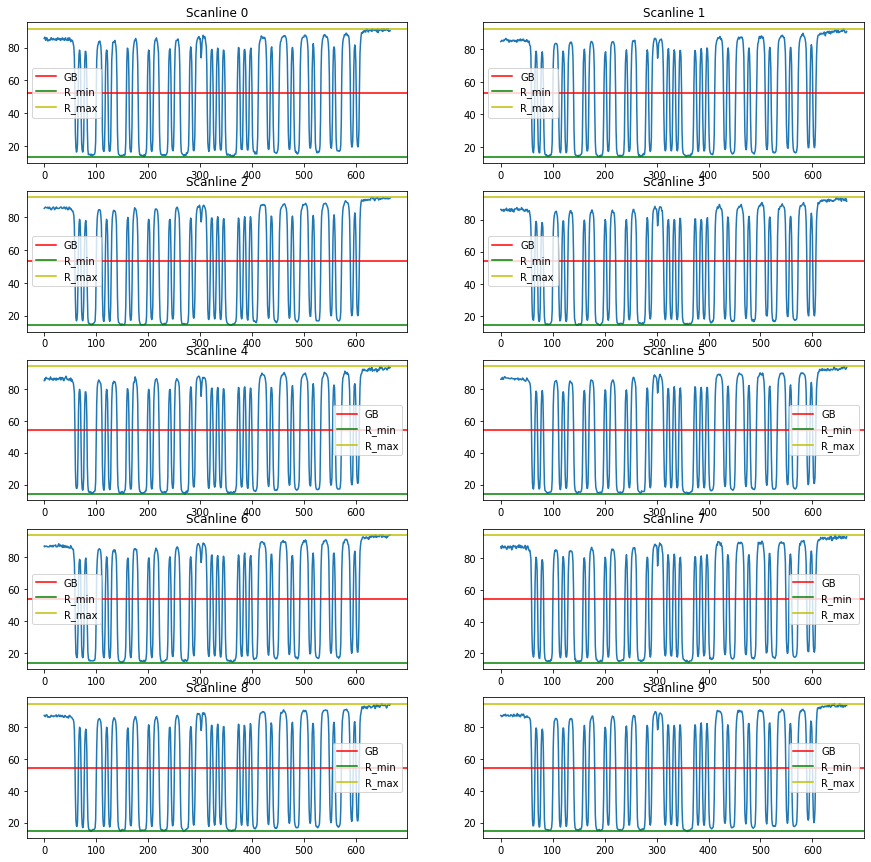

In [52]:
# TEST CHART SC: 75. GRADE 'A'
# MINE SC: 89.57. GRADE 'A'
# OK

%matplotlib inline  
compute_visualize_RminSC(f'../images/{images_paths[34]}')

Image path: ../images/UPC#15.BMP

R_min_list: [16.470588235294116, 16.470588235294116, 16.470588235294116, 16.470588235294116, 16.862745098039216, 17.254901960784313, 16.862745098039216, 16.470588235294116, 16.862745098039216, 17.254901960784313]
R_min mean: 16.745098039215684

R_max_list: [91.37254901960785, 91.37254901960785, 93.33333333333333, 92.54901960784314, 93.72549019607843, 93.72549019607843, 94.11764705882352, 94.90196078431372, 94.50980392156862, 94.50980392156862]
R_max mean: 93.41176470588235

R_min_grade: A

SC_list: [74.90196078431373, 74.90196078431373, 76.86274509803921, 76.07843137254902, 76.86274509803921, 76.47058823529412, 77.25490196078431, 78.4313725490196, 77.6470588235294, 77.25490196078431]
SC mean: 76.66666666666666
SC_grade: A

GB_list: [53.92156862745098, 53.92156862745098, 54.90196078431372, 54.509803921568626, 55.294117647058826, 55.49019607843137, 55.49019607843137, 55.686274509803916, 55.68627450980392, 55.882352941176464]
GB mean: 55.07843137254902


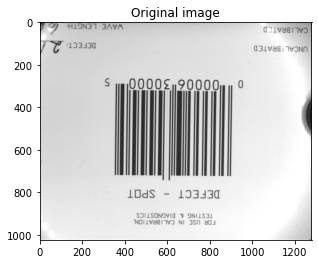

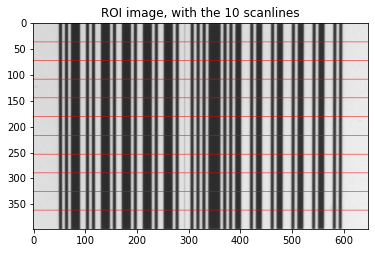

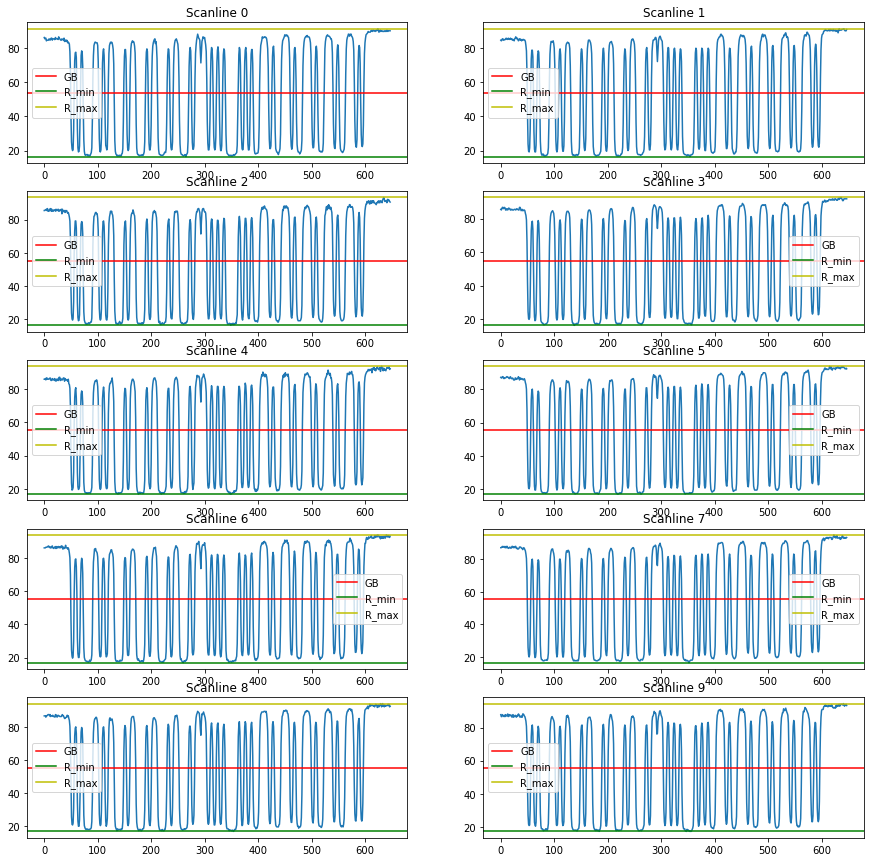

In [53]:
# TEST CHART SC: 72. GRADE 'A'
# MINE SC: 86.67. GRADE 'A'
# OK

%matplotlib inline  
compute_visualize_RminSC(f'../images/{images_paths[35]}')

Image path: ../images/UPC#16.BMP

R_min_list: [13.725490196078432, 13.725490196078432, 14.117647058823529, 14.117647058823529, 14.117647058823529, 14.50980392156863, 14.50980392156863, 14.50980392156863, 14.50980392156863, 14.50980392156863]
R_min mean: 14.235294117647062

R_max_list: [91.37254901960785, 91.37254901960785, 92.54901960784314, 93.33333333333333, 93.33333333333333, 94.11764705882352, 94.50980392156862, 94.50980392156862, 95.68627450980392, 96.07843137254902]
R_max mean: 93.68627450980392

R_min_grade: A

SC_list: [77.64705882352942, 77.64705882352942, 78.43137254901961, 79.2156862745098, 79.2156862745098, 79.60784313725489, 79.99999999999999, 79.99999999999999, 81.17647058823529, 81.56862745098039]
SC mean: 79.45098039215686
SC_grade: A

GB_list: [52.54901960784314, 52.54901960784314, 53.333333333333336, 53.72549019607843, 53.72549019607843, 54.31372549019608, 54.50980392156862, 54.50980392156862, 55.09803921568627, 55.294117647058826]
GB mean: 53.96078431372549


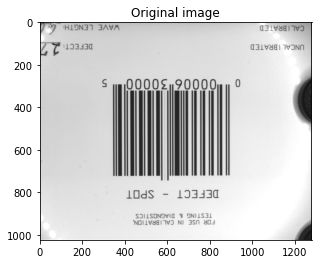

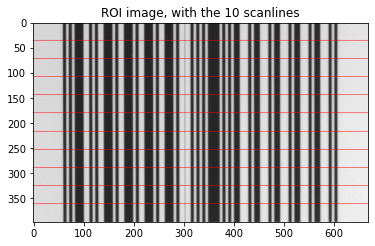

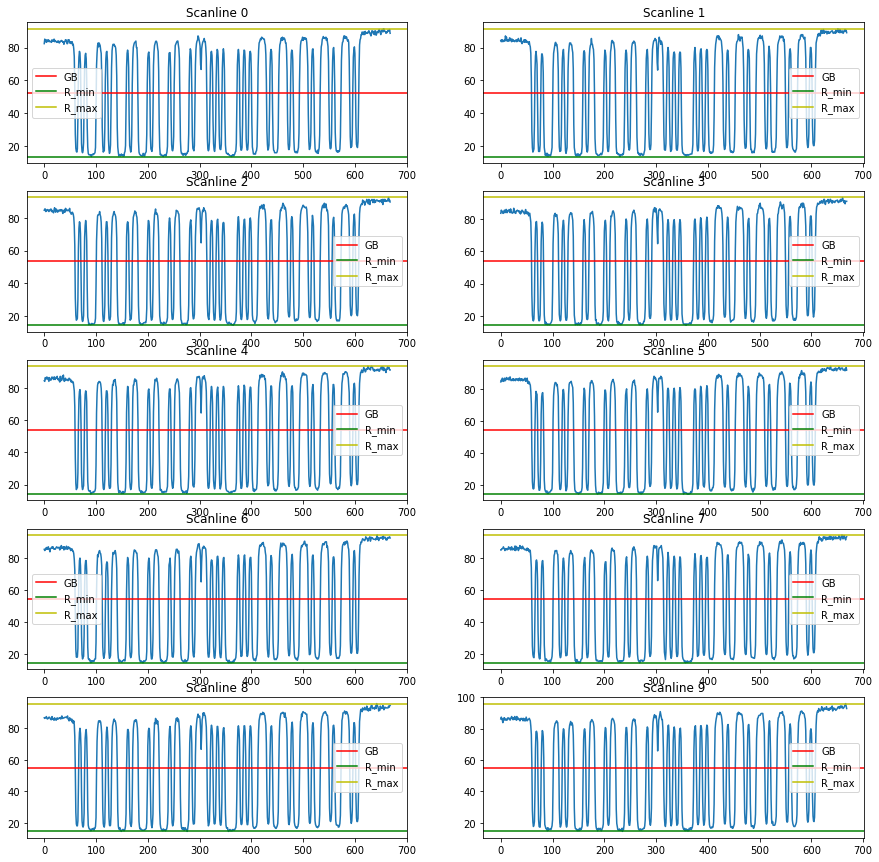

In [54]:
# TEST CHART SC: 75.7. GRADE 'A'
# MINE SC: 79.45. GRADE 'A'
# OK

%matplotlib inline  
compute_visualize_RminSC(f'../images/{images_paths[36]}')

Image path: ../images/UPC#17.BMP

R_min_list: [14.117647058823529, 14.50980392156863, 14.117647058823529, 14.50980392156863, 14.901960784313726, 14.901960784313726, 14.901960784313726, 14.901960784313726, 14.901960784313726, 14.901960784313726]
R_min mean: 14.666666666666668

R_max_list: [91.37254901960785, 92.15686274509804, 92.15686274509804, 92.54901960784314, 93.33333333333333, 93.72549019607843, 93.33333333333333, 94.50980392156862, 94.90196078431372, 94.50980392156862]
R_max mean: 93.25490196078431

R_min_grade: A

SC_list: [77.25490196078431, 77.6470588235294, 78.0392156862745, 78.0392156862745, 78.4313725490196, 78.8235294117647, 78.4313725490196, 79.60784313725489, 79.99999999999999, 79.60784313725489]
SC mean: 78.58823529411765
SC_grade: A

GB_list: [52.745098039215684, 53.33333333333333, 53.13725490196078, 53.529411764705884, 54.11764705882352, 54.31372549019608, 54.11764705882352, 54.705882352941174, 54.901960784313715, 54.705882352941174]
GB mean: 53.96078431372549


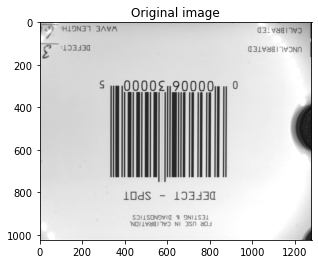

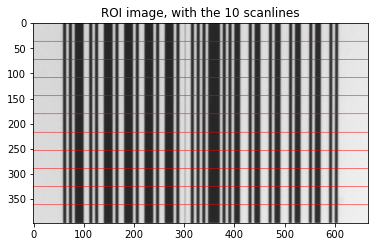

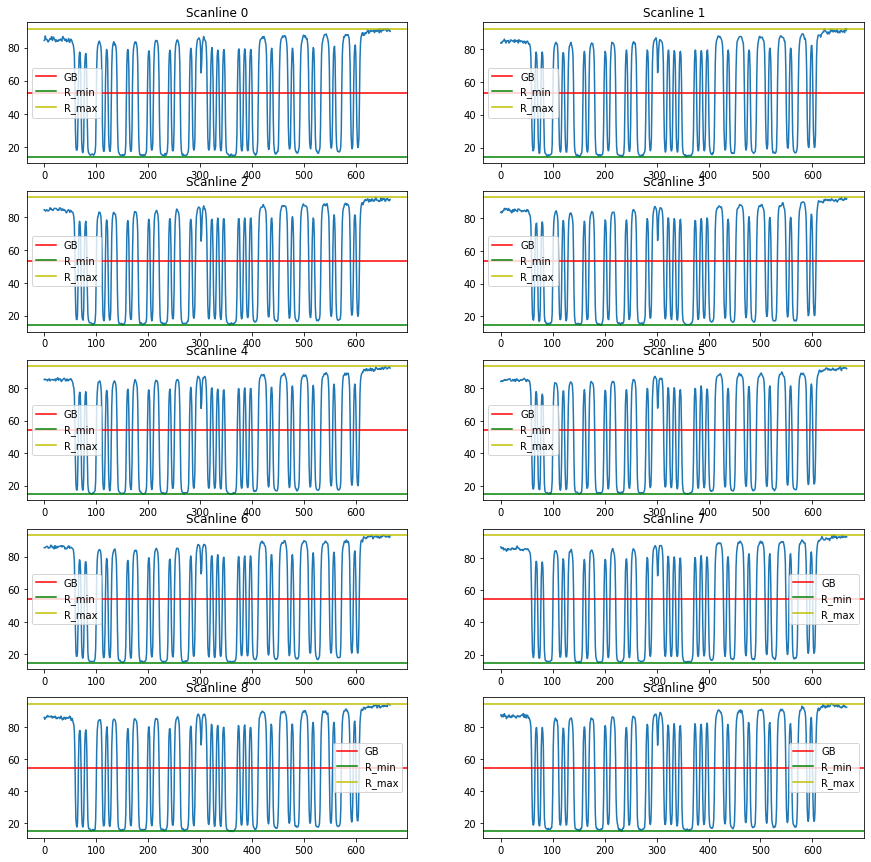

In [55]:
# TEST CHART SC: 74.5. GRADE 'A'
# MINE SC: 78.59. GRADE 'A'
# OK

%matplotlib inline  
compute_visualize_RminSC(f'../images/{images_paths[37]}')

Image path: ../images/UPC#18.BMP

R_min_list: [14.50980392156863, 14.901960784313726, 14.50980392156863, 14.901960784313726, 14.901960784313726, 14.901960784313726, 14.901960784313726, 15.294117647058824, 15.686274509803921, 15.686274509803921]
R_min mean: 15.019607843137255

R_max_list: [92.54901960784314, 94.11764705882352, 94.50980392156862, 94.50980392156862, 94.90196078431372, 94.90196078431372, 94.90196078431372, 94.50980392156862, 94.50980392156862, 95.29411764705881]
R_max mean: 94.4705882352941

R_min_grade: A

SC_list: [78.0392156862745, 79.21568627450979, 79.99999999999999, 79.60784313725489, 79.99999999999999, 79.99999999999999, 79.99999999999999, 79.21568627450979, 78.8235294117647, 79.60784313725489]
SC mean: 79.45098039215685
SC_grade: A

GB_list: [53.529411764705884, 54.50980392156862, 54.50980392156862, 54.705882352941174, 54.901960784313715, 54.901960784313715, 54.901960784313715, 54.90196078431372, 55.09803921568627, 55.49019607843137]
GB mean: 54.74509803921568


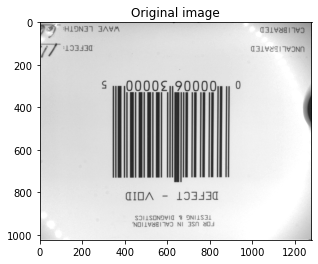

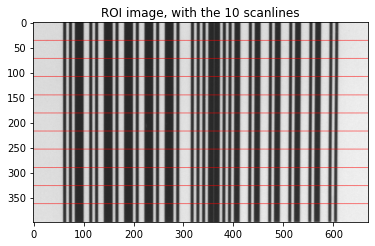

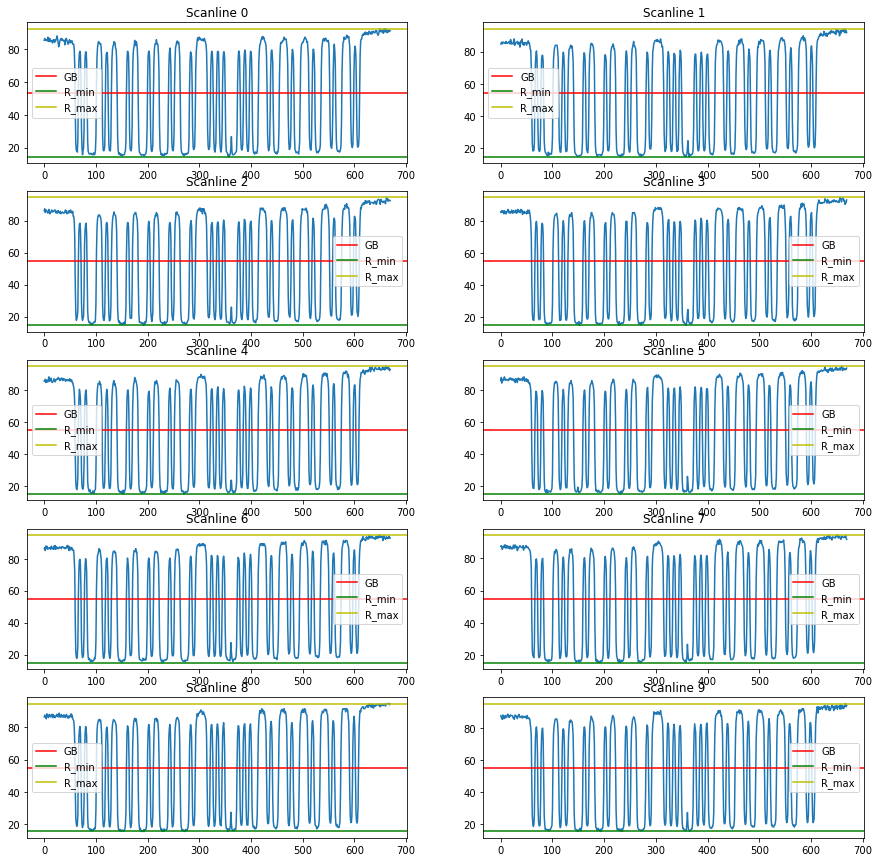

In [56]:
# TEST CHART SC: 74.7. GRADE 'A'
# MINE SC: 79.45. GRADE 'A'
# OK

%matplotlib inline  
compute_visualize_RminSC(f'../images/{images_paths[38]}')

Image path: ../images/UPC#19.BMP

R_min_list: [18.03921568627451, 18.03921568627451, 18.43137254901961, 18.43137254901961, 18.823529411764707, 18.43137254901961, 18.43137254901961, 18.43137254901961, 18.823529411764707, 18.823529411764707]
R_min mean: 18.470588235294116

R_max_list: [90.58823529411765, 91.37254901960785, 92.15686274509804, 92.15686274509804, 92.94117647058823, 93.33333333333333, 93.33333333333333, 93.72549019607843, 94.11764705882352, 93.72549019607843]
R_max mean: 92.74509803921568

R_min_grade: A

SC_list: [72.54901960784315, 73.33333333333334, 73.72549019607843, 73.72549019607843, 74.11764705882352, 74.90196078431372, 74.90196078431372, 75.29411764705881, 75.29411764705881, 74.90196078431372]
SC mean: 74.27450980392156
SC_grade: A

GB_list: [54.313725490196084, 54.70588235294118, 55.294117647058826, 55.294117647058826, 55.882352941176464, 55.882352941176464, 55.882352941176464, 56.07843137254902, 56.470588235294116, 56.27450980392156]
GB mean: 55.607843137254896


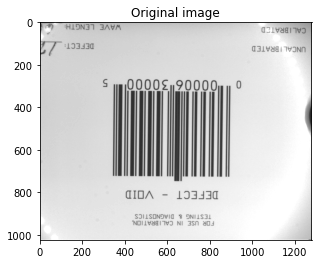

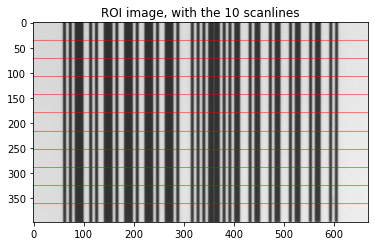

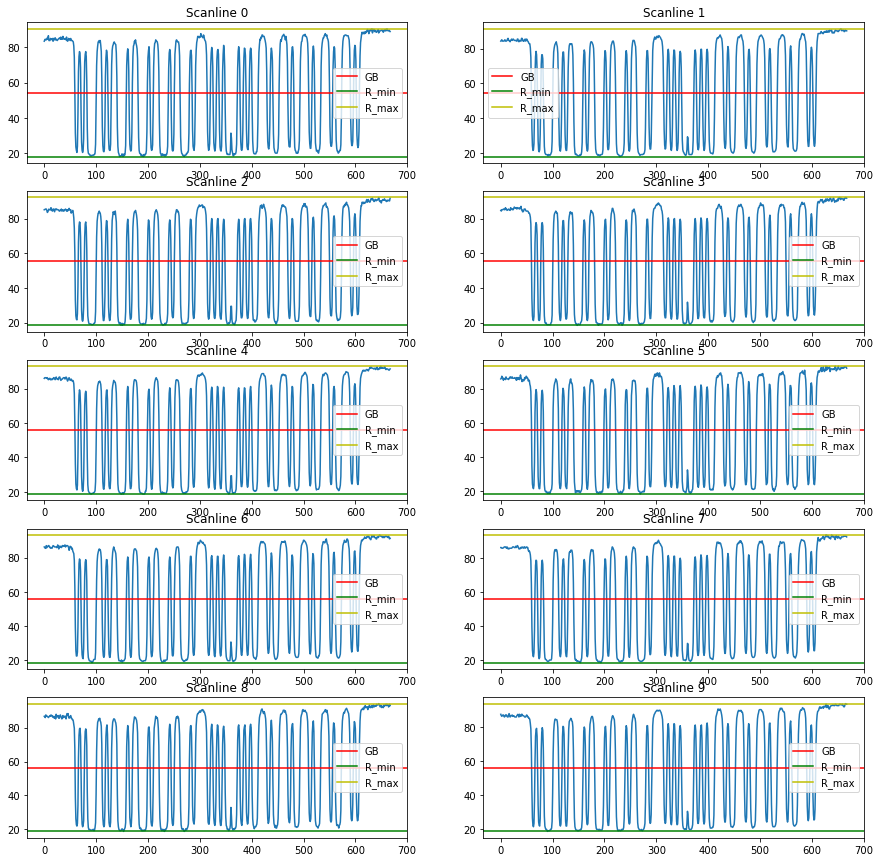

In [57]:
# TEST CHART SC: 71. GRADE 'A'
# MINE SC: 74.27. GRADE 'A'
# OK

%matplotlib inline  
compute_visualize_RminSC(f'../images/{images_paths[39]}')

Image path: ../images/UPC#20.BMP

R_min_list: [15.686274509803921, 15.686274509803921, 15.294117647058824, 15.294117647058824, 15.686274509803921, 16.07843137254902, 16.07843137254902, 16.07843137254902, 16.07843137254902, 16.470588235294116]
R_min mean: 15.843137254901958

R_max_list: [90.58823529411765, 91.37254901960785, 90.58823529411765, 91.76470588235294, 92.15686274509804, 93.33333333333333, 93.72549019607843, 94.11764705882352, 93.72549019607843, 94.90196078431372]
R_max mean: 92.62745098039217

R_min_grade: A

SC_list: [74.90196078431373, 75.68627450980392, 75.29411764705883, 76.47058823529412, 76.47058823529412, 77.25490196078431, 77.6470588235294, 78.0392156862745, 77.6470588235294, 78.4313725490196]
SC mean: 76.7843137254902
SC_grade: A

GB_list: [53.13725490196079, 53.529411764705884, 52.94117647058824, 53.529411764705884, 53.92156862745098, 54.705882352941174, 54.90196078431372, 55.09803921568627, 54.90196078431372, 55.686274509803916]
GB mean: 54.23529411764705


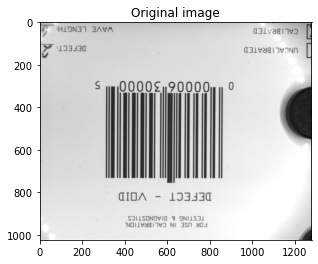

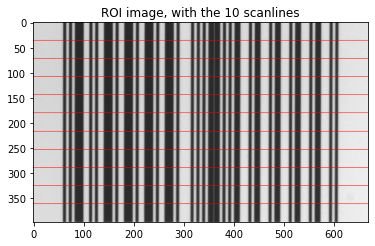

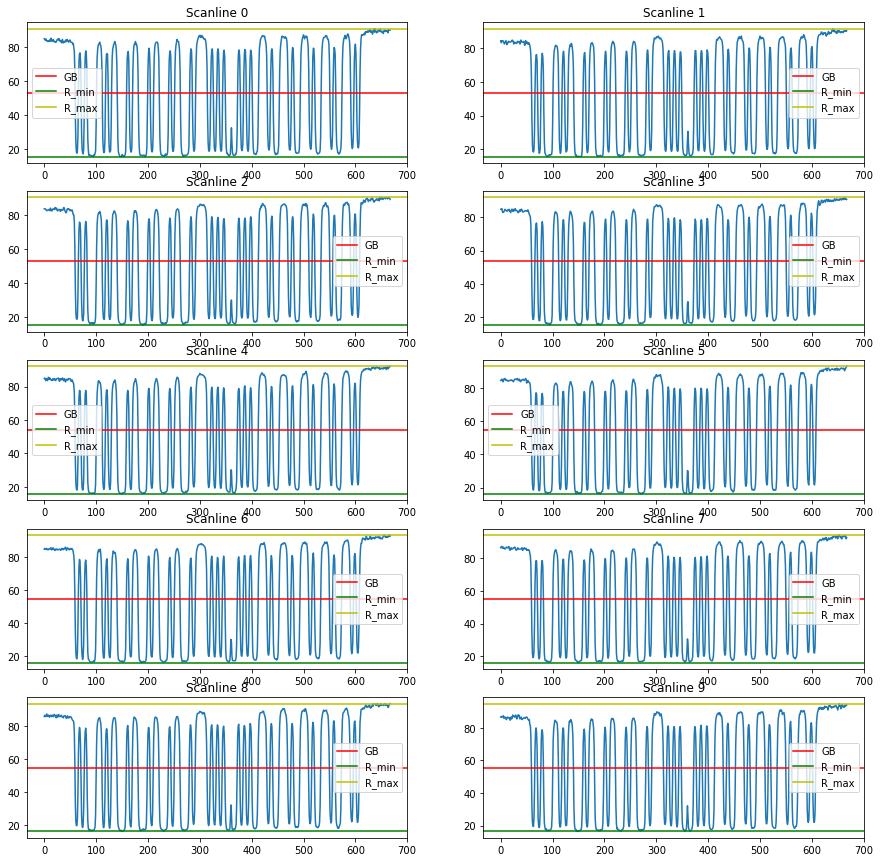

In [58]:
# TEST CHART SC: 73.7. GRADE 'A'
# MINE SC: 76.78. GRADE 'A'
# OK

%matplotlib inline  
compute_visualize_RminSC(f'../images/{images_paths[40]}')

Image path: ../images/UPC#21.BMP

R_min_list: [15.294117647058824, 15.294117647058824, 15.294117647058824, 15.294117647058824, 15.686274509803921, 15.686274509803921, 15.686274509803921, 15.686274509803921, 15.294117647058824, 16.470588235294116]
R_min mean: 15.568627450980392

R_max_list: [89.80392156862746, 90.19607843137256, 90.98039215686275, 91.37254901960785, 91.37254901960785, 92.15686274509804, 92.54901960784314, 93.33333333333333, 93.72549019607843, 94.50980392156862]
R_max mean: 92.0

R_min_grade: A

SC_list: [74.50980392156863, 74.90196078431373, 75.68627450980392, 76.07843137254902, 75.68627450980392, 76.47058823529412, 76.86274509803921, 77.6470588235294, 78.4313725490196, 78.0392156862745]
SC mean: 76.43137254901958
SC_grade: A

GB_list: [52.54901960784314, 52.74509803921569, 53.13725490196079, 53.333333333333336, 53.529411764705884, 53.92156862745098, 54.11764705882353, 54.509803921568626, 54.509803921568626, 55.49019607843137]
GB mean: 53.7843137254902


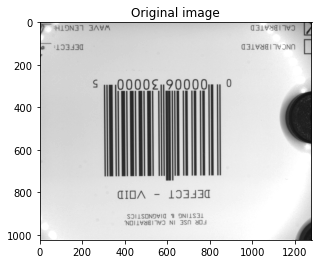

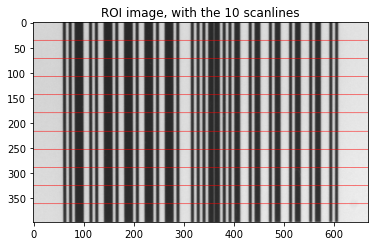

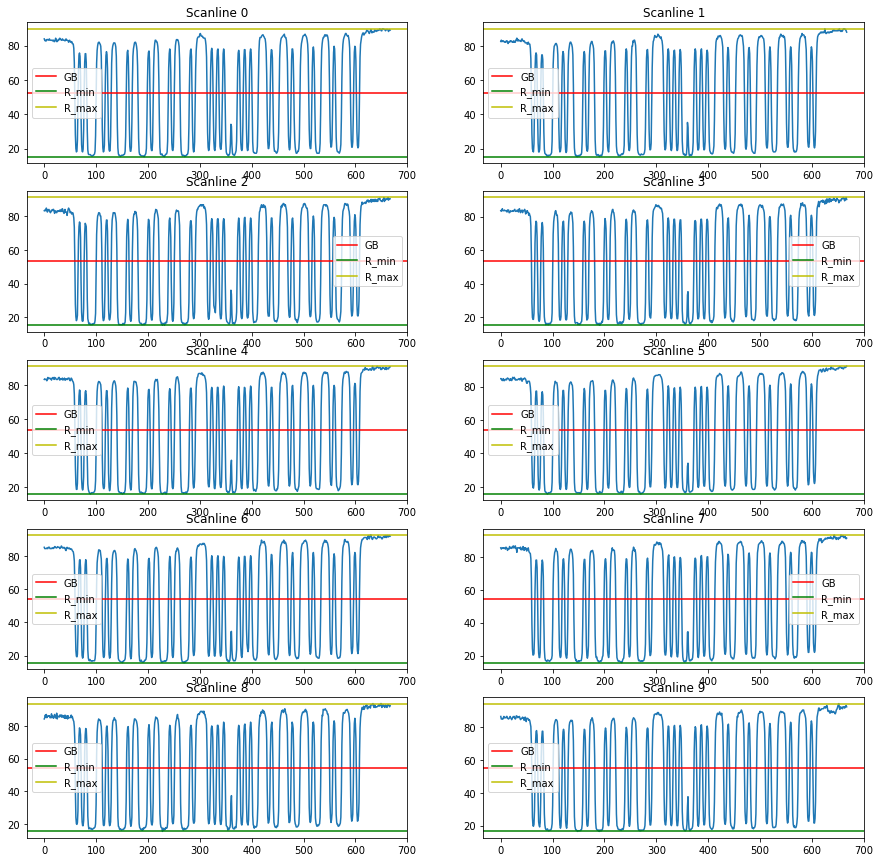

In [59]:
# TEST CHART SC: 74.4. GRADE 'A'
# MINE SC: 76.43. GRADE 'A'
# OK

%matplotlib inline  
compute_visualize_RminSC(f'../images/{images_paths[41]}')

Image path: ../images/UPC#22.BMP

R_min_list: [14.50980392156863, 14.50980392156863, 14.901960784313726, 14.50980392156863, 14.901960784313726, 15.294117647058824, 14.901960784313726, 15.294117647058824, 15.686274509803921, 15.686274509803921]
R_min mean: 15.019607843137255

R_max_list: [89.41176470588236, 90.58823529411765, 90.19607843137256, 91.37254901960785, 91.37254901960785, 92.94117647058823, 94.11764705882352, 94.50980392156862, 94.50980392156862, 93.33333333333333]
R_max mean: 92.23529411764706

R_min_grade: A

SC_list: [74.90196078431373, 76.07843137254902, 75.29411764705883, 76.86274509803921, 76.47058823529412, 77.6470588235294, 79.21568627450979, 79.21568627450979, 78.8235294117647, 77.6470588235294]
SC mean: 77.2156862745098
SC_grade: A

GB_list: [51.9607843137255, 52.549019607843135, 52.549019607843135, 52.94117647058823, 53.13725490196079, 54.11764705882353, 54.50980392156862, 54.90196078431372, 55.09803921568627, 54.509803921568626]
GB mean: 53.627450980392155


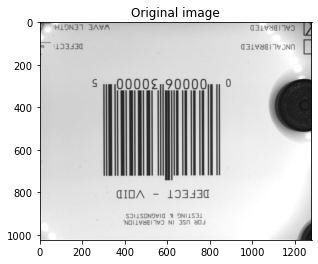

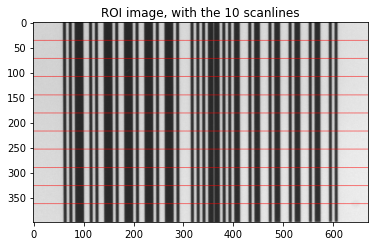

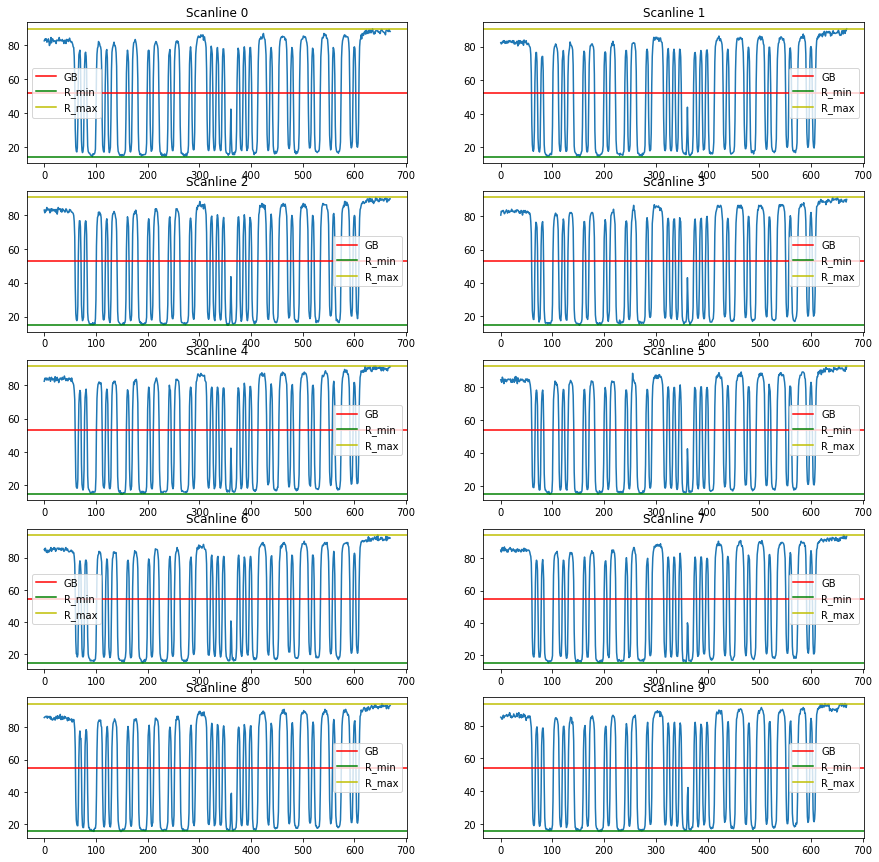

In [60]:
# TEST CHART SC: 74.3. GRADE 'A'
# MINE SC: 77.21. GRADE 'A'
# OK

%matplotlib inline  
compute_visualize_RminSC(f'../images/{images_paths[42]}')

Image path: ../images/UPC#23.BMP

R_min_list: [12.549019607843137, 12.156862745098039, 12.549019607843137, 12.156862745098039, 12.156862745098039, 12.156862745098039, 12.941176470588237, 12.941176470588237, 12.941176470588237, 12.941176470588237]
R_min mean: 12.549019607843137

R_max_list: [88.62745098039215, 88.23529411764706, 90.19607843137256, 90.19607843137256, 90.98039215686275, 91.37254901960785, 91.76470588235294, 92.54901960784314, 92.94117647058823, 92.94117647058823]
R_max mean: 90.98039215686276

R_min_grade: A

SC_list: [76.07843137254902, 76.07843137254902, 77.64705882352942, 78.03921568627452, 78.82352941176471, 79.2156862745098, 78.82352941176471, 79.6078431372549, 80.0, 80.0]
SC mean: 78.43137254901961
SC_grade: A

GB_list: [50.588235294117645, 50.19607843137255, 51.372549019607845, 51.1764705882353, 51.568627450980394, 51.76470588235294, 52.352941176470594, 52.74509803921569, 52.94117647058824, 52.94117647058824]
GB mean: 51.76470588235294


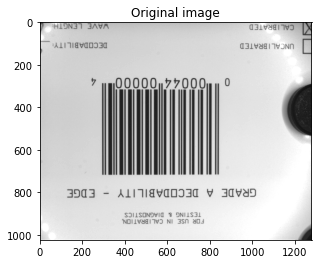

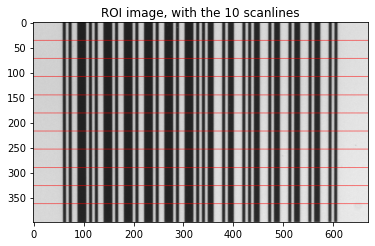

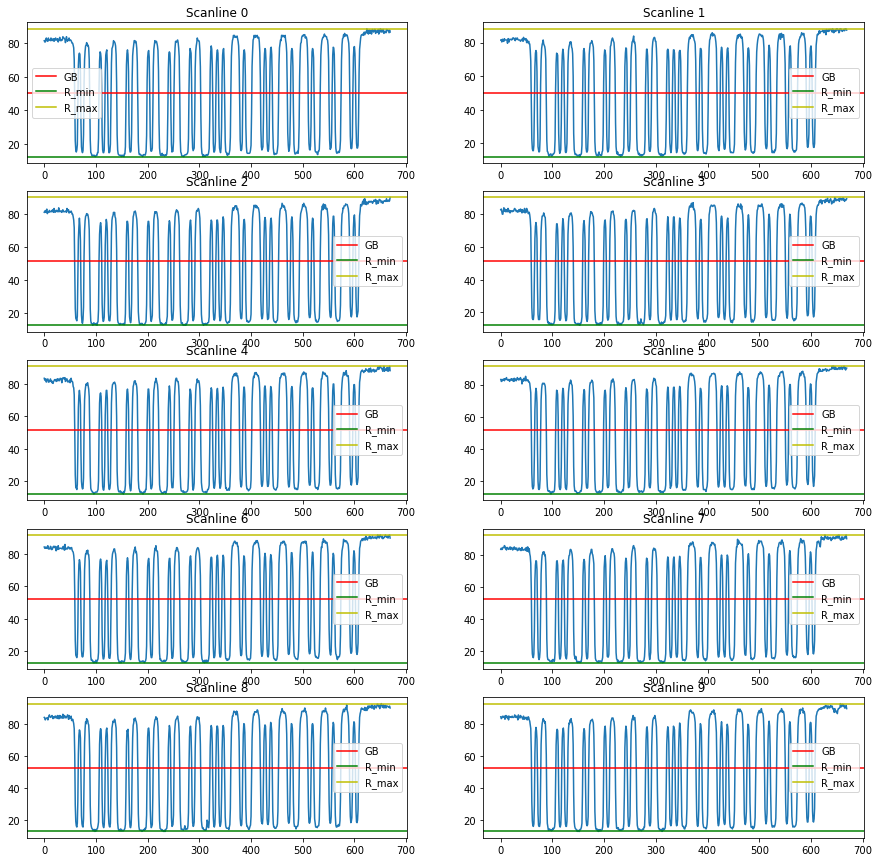

In [61]:
# TEST CHART SC: 74.8. GRADE 'A'
# MINE SC: 78.43. GRADE 'A'
# OK

%matplotlib inline  
compute_visualize_RminSC(f'../images/{images_paths[43]}')

Image path: ../images/UPC#24.BMP

R_min_list: [13.725490196078432, 12.941176470588237, 13.333333333333334, 13.725490196078432, 13.725490196078432, 13.725490196078432, 14.117647058823529, 14.117647058823529, 14.50980392156863, 14.50980392156863]
R_min mean: 13.843137254901961

R_max_list: [89.41176470588236, 89.01960784313725, 90.19607843137256, 90.19607843137256, 91.37254901960785, 91.76470588235294, 91.76470588235294, 92.54901960784314, 92.15686274509804, 92.94117647058823]
R_max mean: 91.13725490196077

R_min_grade: A

SC_list: [75.68627450980392, 76.07843137254902, 76.86274509803923, 76.47058823529412, 77.64705882352942, 78.0392156862745, 77.64705882352942, 78.43137254901961, 77.6470588235294, 78.4313725490196]
SC mean: 77.29411764705881
SC_grade: A

GB_list: [51.568627450980394, 50.98039215686275, 51.76470588235295, 51.96078431372549, 52.54901960784314, 52.745098039215684, 52.94117647058824, 53.333333333333336, 53.33333333333333, 53.725490196078425]
GB mean: 52.49019607843137


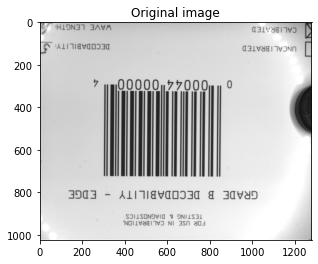

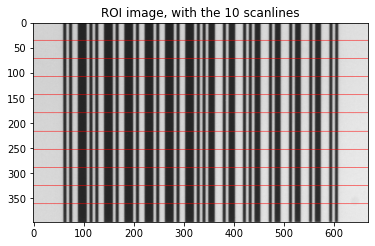

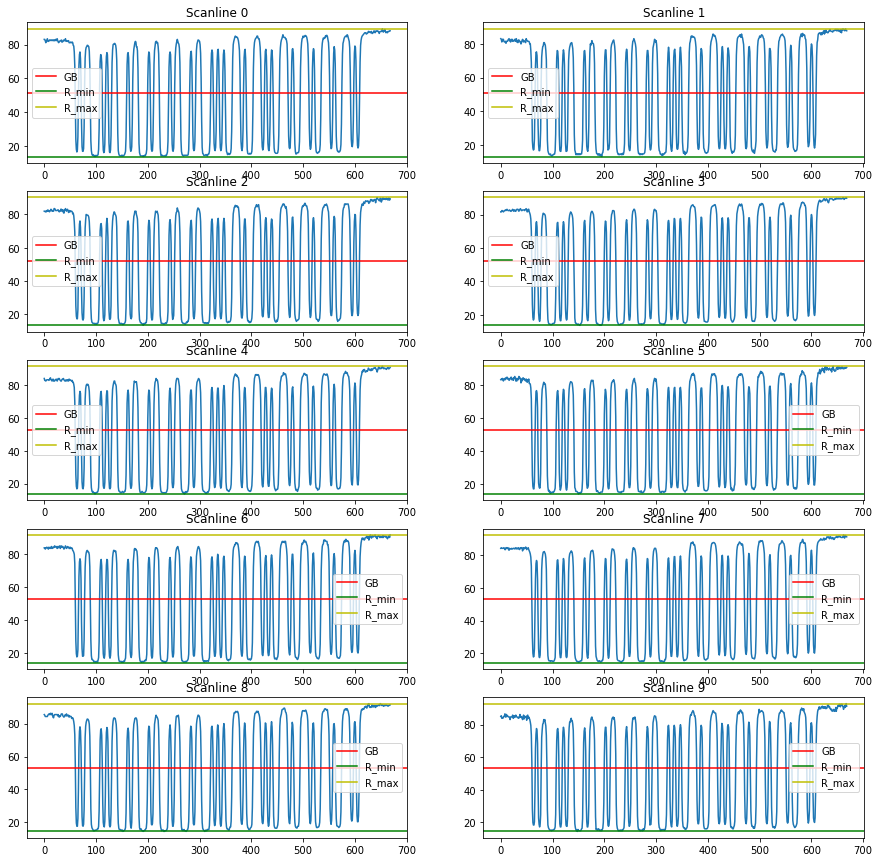

In [62]:
# TEST CHART SC: 73.8. GRADE 'A'
# MINE SC: 77.29. GRADE 'A'
# OK

%matplotlib inline  
compute_visualize_RminSC(f'../images/{images_paths[44]}')

Image path: ../images/UPC#25.BMP

R_min_list: [11.76470588235294, 11.76470588235294, 11.76470588235294, 11.76470588235294, 12.156862745098039, 12.549019607843137, 12.549019607843137, 12.549019607843137, 12.156862745098039, 12.549019607843137]
R_min mean: 12.156862745098037

R_max_list: [90.98039215686275, 91.37254901960785, 92.54901960784314, 92.54901960784314, 92.94117647058823, 92.54901960784314, 92.94117647058823, 94.11764705882352, 94.50980392156862, 94.11764705882352]
R_max mean: 92.86274509803921

R_min_grade: A

SC_list: [79.2156862745098, 79.6078431372549, 80.7843137254902, 80.7843137254902, 80.7843137254902, 80.0, 80.3921568627451, 81.56862745098039, 82.35294117647058, 81.56862745098039]
SC mean: 80.70588235294117
SC_grade: A

GB_list: [51.372549019607845, 51.568627450980394, 52.15686274509804, 52.15686274509804, 52.549019607843135, 52.549019607843135, 52.745098039215684, 53.33333333333333, 53.33333333333333, 53.33333333333333]
GB mean: 52.50980392156862


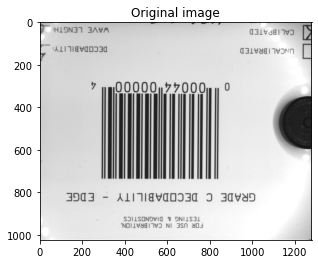

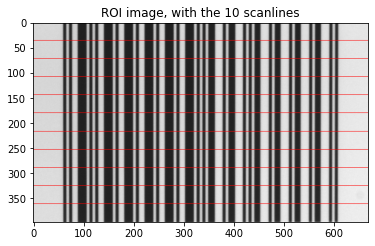

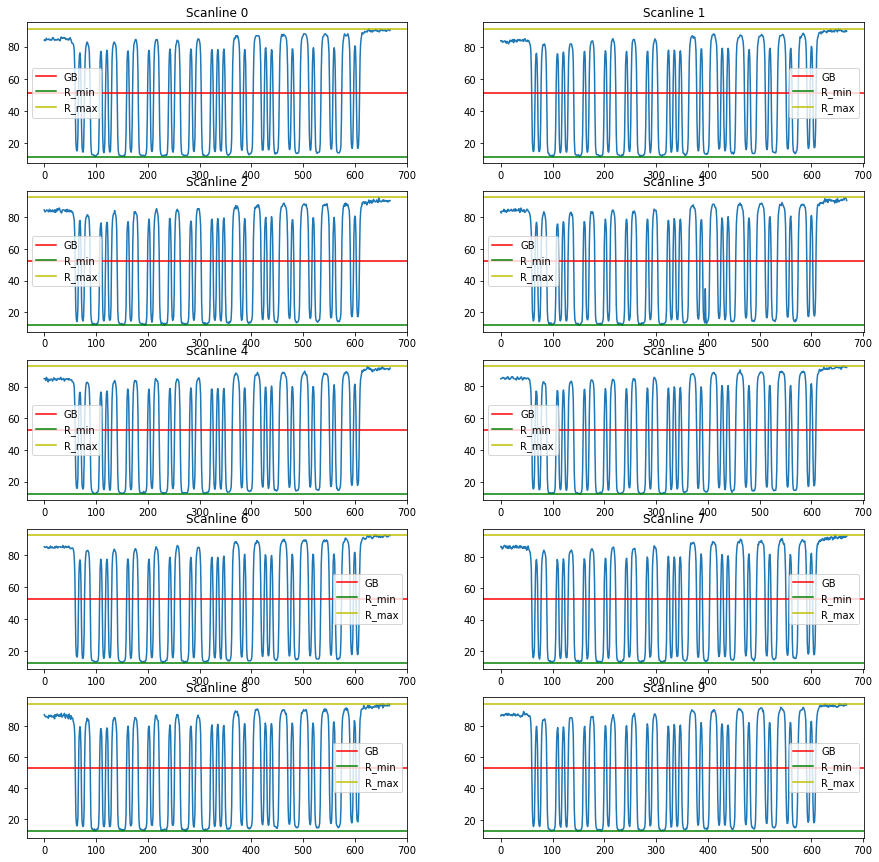

In [63]:
# TEST CHART SC: 77.5. GRADE 'A'
# MINE SC: 80.07. GRADE 'A'
# OK

%matplotlib inline  
compute_visualize_RminSC(f'../images/{images_paths[45]}')

Image path: ../images/UPC#26.BMP

R_min_list: [11.76470588235294, 12.156862745098039, 11.76470588235294, 11.76470588235294, 12.156862745098039, 12.156862745098039, 12.549019607843137, 12.549019607843137, 12.549019607843137, 12.549019607843137]
R_min mean: 12.196078431372548

R_max_list: [88.23529411764706, 89.41176470588236, 89.01960784313725, 90.19607843137256, 90.19607843137256, 90.98039215686275, 91.37254901960785, 92.15686274509804, 91.76470588235294, 92.15686274509804]
R_max mean: 90.54901960784314

R_min_grade: A

SC_list: [76.47058823529412, 77.25490196078432, 77.25490196078431, 78.43137254901961, 78.03921568627452, 78.82352941176471, 78.82352941176471, 79.6078431372549, 79.2156862745098, 79.6078431372549]
SC mean: 78.3529411764706
SC_grade: A

GB_list: [50.0, 50.7843137254902, 50.3921568627451, 50.98039215686275, 51.1764705882353, 51.568627450980394, 51.96078431372549, 52.35294117647059, 52.15686274509804, 52.35294117647059]
GB mean: 51.372549019607845


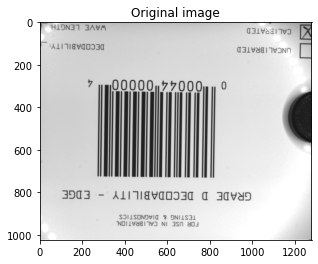

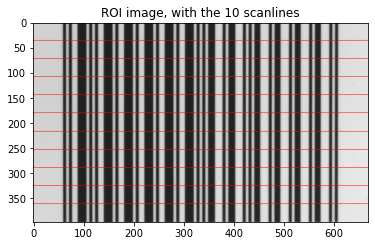

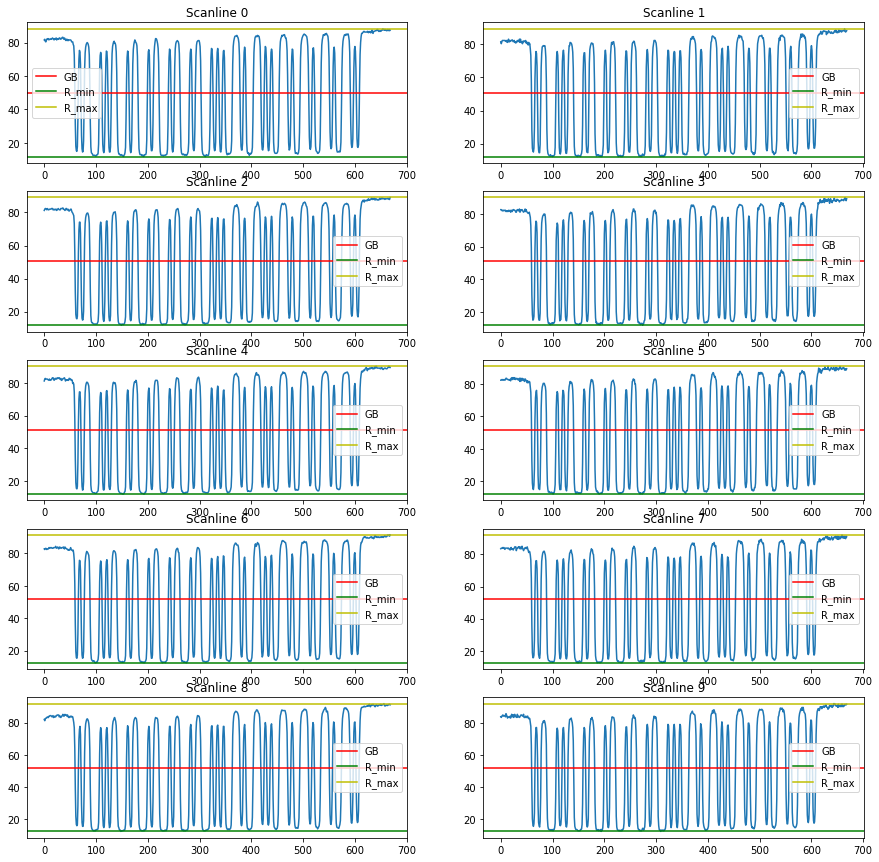

In [64]:
# TEST CHART SC: 75.4. GRADE 'A'
# MINE SC: 78.35. GRADE 'A'
# OK

%matplotlib inline  
compute_visualize_RminSC(f'../images/{images_paths[46]}')

Image path: ../images/UPC#27.BMP

R_min_list: [11.76470588235294, 11.76470588235294, 11.76470588235294, 11.76470588235294, 11.76470588235294, 12.156862745098039, 12.156862745098039, 11.76470588235294, 12.549019607843137, 12.549019607843137]
R_min mean: 12.0

R_max_list: [89.41176470588236, 89.01960784313725, 89.41176470588236, 89.41176470588236, 89.80392156862746, 89.80392156862746, 90.98039215686275, 91.37254901960785, 91.37254901960785, 91.76470588235294]
R_max mean: 90.23529411764706

R_min_grade: A

SC_list: [77.64705882352942, 77.25490196078431, 77.64705882352942, 77.64705882352942, 78.03921568627452, 77.64705882352942, 78.82352941176471, 79.6078431372549, 78.82352941176471, 79.2156862745098]
SC mean: 78.23529411764707
SC_grade: A

GB_list: [50.58823529411765, 50.3921568627451, 50.58823529411765, 50.58823529411765, 50.7843137254902, 50.98039215686275, 51.568627450980394, 51.568627450980394, 51.96078431372549, 52.15686274509804]
GB mean: 51.117647058823536


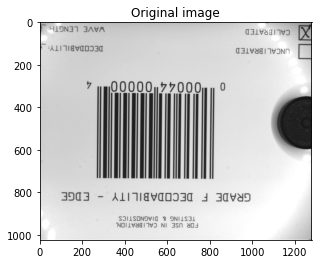

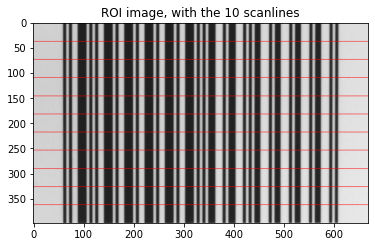

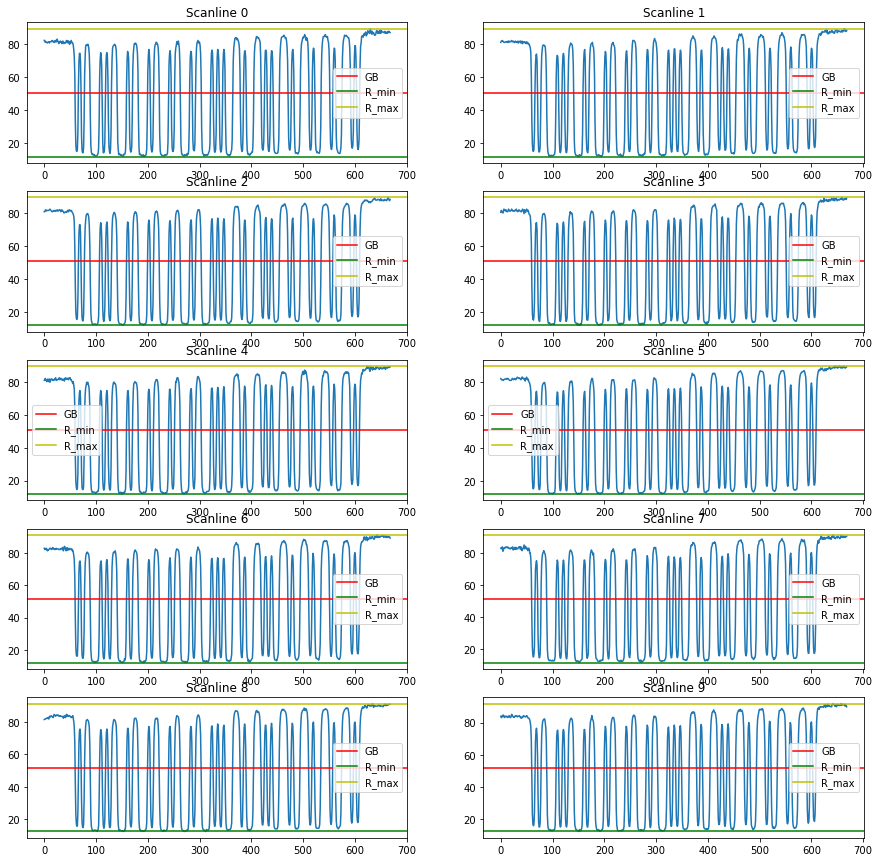

In [65]:
# TEST CHART SC: 76.8. GRADE 'A'
# MINE SC: 78.23. GRADE 'A'
# OK

%matplotlib inline  
compute_visualize_RminSC(f'../images/{images_paths[47]}')

Image path: ../images/UPC#28.BMP

R_min_list: [12.941176470588237, 12.941176470588237, 12.941176470588237, 12.941176470588237, 12.941176470588237, 13.333333333333334, 13.333333333333334, 13.725490196078432, 13.725490196078432, 13.725490196078432]
R_min mean: 13.254901960784315

R_max_list: [89.01960784313725, 89.41176470588236, 89.80392156862746, 89.80392156862746, 90.58823529411765, 90.98039215686275, 92.54901960784314, 92.15686274509804, 92.94117647058823, 93.72549019607843]
R_max mean: 91.09803921568627

R_min_grade: A

SC_list: [76.07843137254902, 76.47058823529413, 76.86274509803923, 76.86274509803923, 77.64705882352942, 77.64705882352942, 79.2156862745098, 78.43137254901961, 79.2156862745098, 80.0]
SC mean: 77.84313725490196
SC_grade: A

GB_list: [50.98039215686275, 51.176470588235304, 51.37254901960785, 51.37254901960785, 51.76470588235295, 52.156862745098046, 52.94117647058824, 52.94117647058824, 53.333333333333336, 53.72549019607843]
GB mean: 52.17647058823529


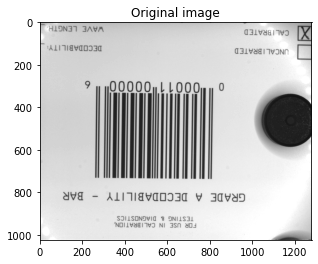

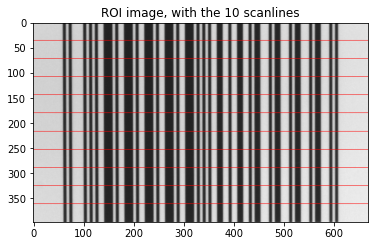

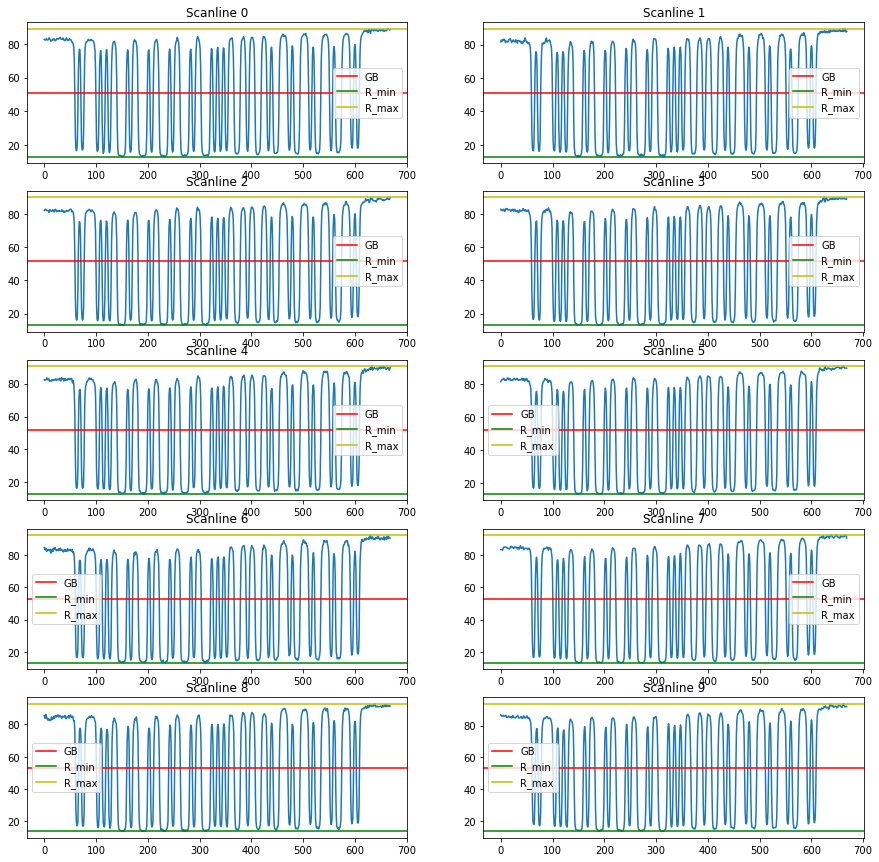

In [66]:
# TEST CHART SC: 74.9. GRADE 'A'
# MINE SC: 77.84. GRADE 'A'
# OK

%matplotlib inline  
compute_visualize_RminSC(f'../images/{images_paths[48]}')

Image path: ../images/UPC#29.BMP

R_min_list: [12.156862745098039, 12.156862745098039, 12.156862745098039, 12.549019607843137, 11.76470588235294, 12.941176470588237, 12.941176470588237, 13.333333333333334, 13.333333333333334, 12.941176470588237]
R_min mean: 12.627450980392156

R_max_list: [89.41176470588236, 89.80392156862746, 90.58823529411765, 90.98039215686275, 91.76470588235294, 91.76470588235294, 92.54901960784314, 92.94117647058823, 93.33333333333333, 93.72549019607843]
R_max mean: 91.68627450980392

R_min_grade: A

SC_list: [77.25490196078432, 77.64705882352942, 78.43137254901961, 78.43137254901961, 80.0, 78.82352941176471, 79.6078431372549, 79.6078431372549, 80.0, 80.7843137254902]
SC mean: 79.05882352941175
SC_grade: A

GB_list: [50.7843137254902, 50.98039215686275, 51.372549019607845, 51.76470588235294, 51.76470588235294, 52.352941176470594, 52.74509803921569, 53.13725490196079, 53.333333333333336, 53.333333333333336]
GB mean: 52.156862745098046


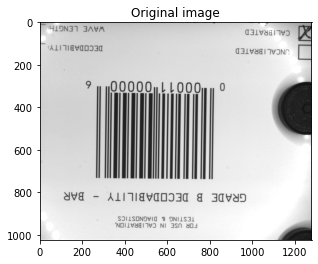

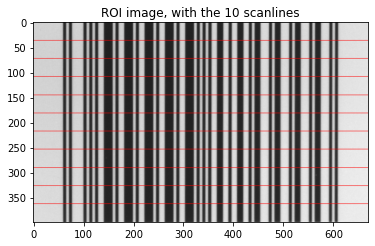

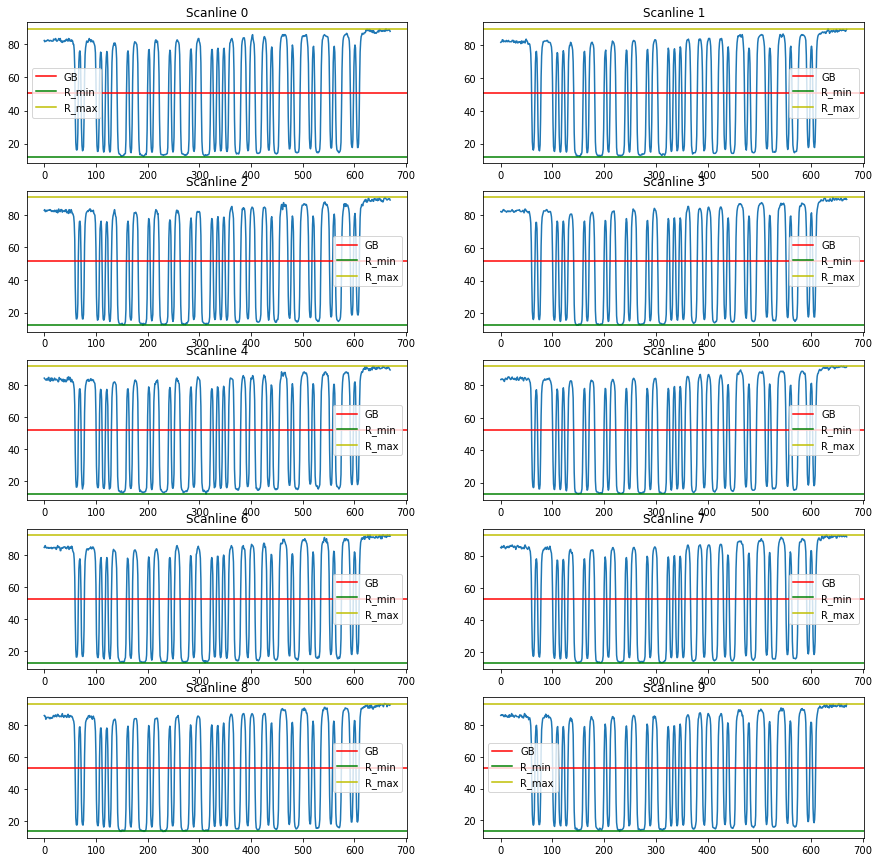

In [67]:
# TEST CHART SC: 75.9. GRADE 'A'
# MINE SC: 79.05. GRADE 'A'
# OK

%matplotlib inline  
compute_visualize_RminSC(f'../images/{images_paths[49]}')

Image path: ../images/UPC#30.BMP

R_min_list: [12.941176470588237, 12.941176470588237, 12.941176470588237, 12.941176470588237, 12.941176470588237, 13.333333333333334, 13.333333333333334, 12.941176470588237, 13.333333333333334, 13.333333333333334]
R_min mean: 13.098039215686276

R_max_list: [90.19607843137256, 90.98039215686275, 90.98039215686275, 91.37254901960785, 91.37254901960785, 92.15686274509804, 92.54901960784314, 93.72549019607843, 93.72549019607843, 94.11764705882352]
R_max mean: 92.11764705882352

R_min_grade: A

SC_list: [77.25490196078432, 78.03921568627452, 78.03921568627452, 78.43137254901961, 78.43137254901961, 78.82352941176471, 79.2156862745098, 80.7843137254902, 80.3921568627451, 80.7843137254902]
SC mean: 79.01960784313725
SC_grade: A

GB_list: [51.5686274509804, 51.9607843137255, 51.9607843137255, 52.156862745098046, 52.156862745098046, 52.74509803921569, 52.94117647058824, 53.333333333333336, 53.529411764705884, 53.72549019607843]
GB mean: 52.6078431372549


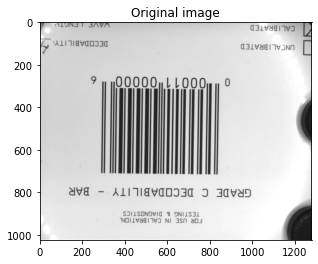

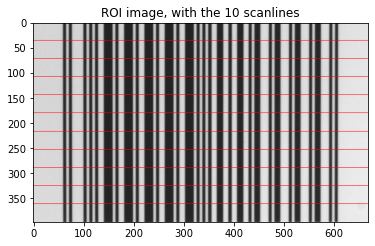

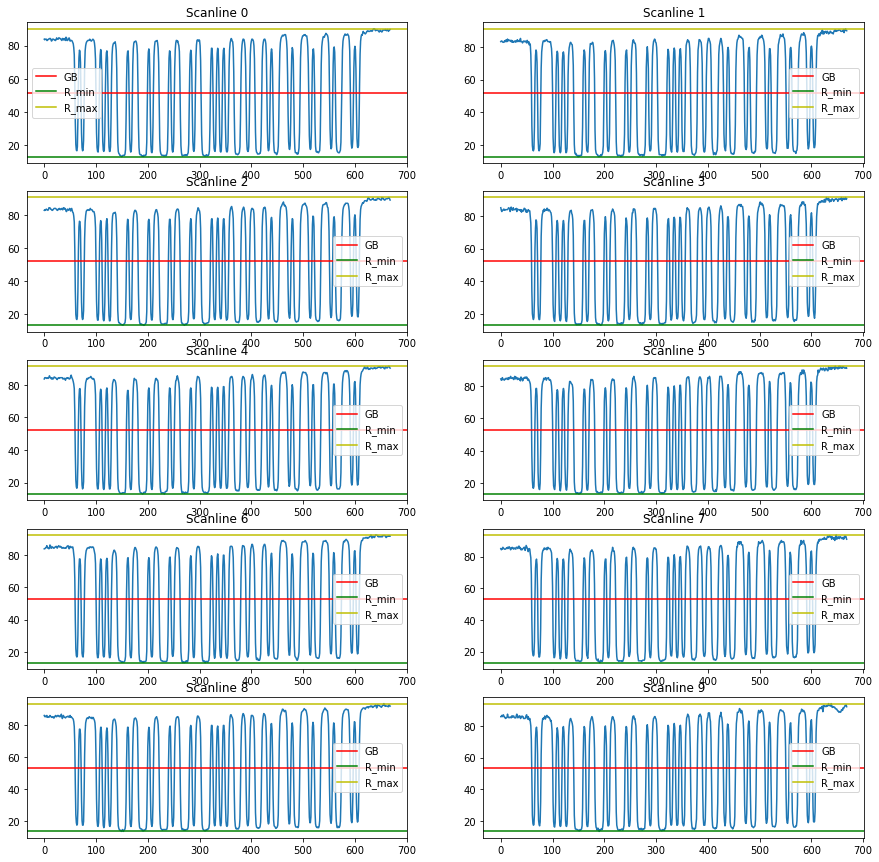

In [68]:
# TEST CHART SC: 75.8. GRADE 'A'
# MINE SC: 79.02. GRADE 'A'
# OK

%matplotlib inline  
compute_visualize_RminSC(f'../images/{images_paths[50]}')

Image path: ../images/UPC#31.BMP

R_min_list: [10.980392156862745, 10.980392156862745, 10.980392156862745, 10.980392156862745, 10.980392156862745, 11.372549019607844, 10.980392156862745, 11.372549019607844, 11.372549019607844, 11.372549019607844]
R_min mean: 11.137254901960784

R_max_list: [89.80392156862746, 90.58823529411765, 90.58823529411765, 90.98039215686275, 92.54901960784314, 91.76470588235294, 92.94117647058823, 92.54901960784314, 93.33333333333333, 93.33333333333333]
R_max mean: 91.84313725490196

R_min_grade: A

SC_list: [78.82352941176471, 79.6078431372549, 79.6078431372549, 80.0, 81.56862745098039, 80.3921568627451, 81.96078431372548, 81.17647058823529, 81.96078431372548, 81.96078431372548]
SC mean: 80.70588235294119
SC_grade: A

GB_list: [50.3921568627451, 50.78431372549019, 50.78431372549019, 50.98039215686275, 51.76470588235294, 51.568627450980394, 51.96078431372548, 51.96078431372549, 52.35294117647059, 52.35294117647059]
GB mean: 51.49019607843137


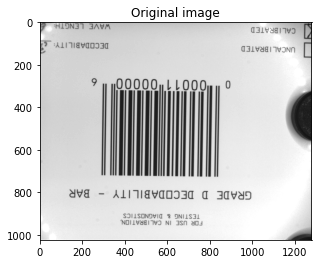

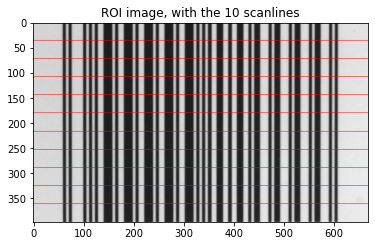

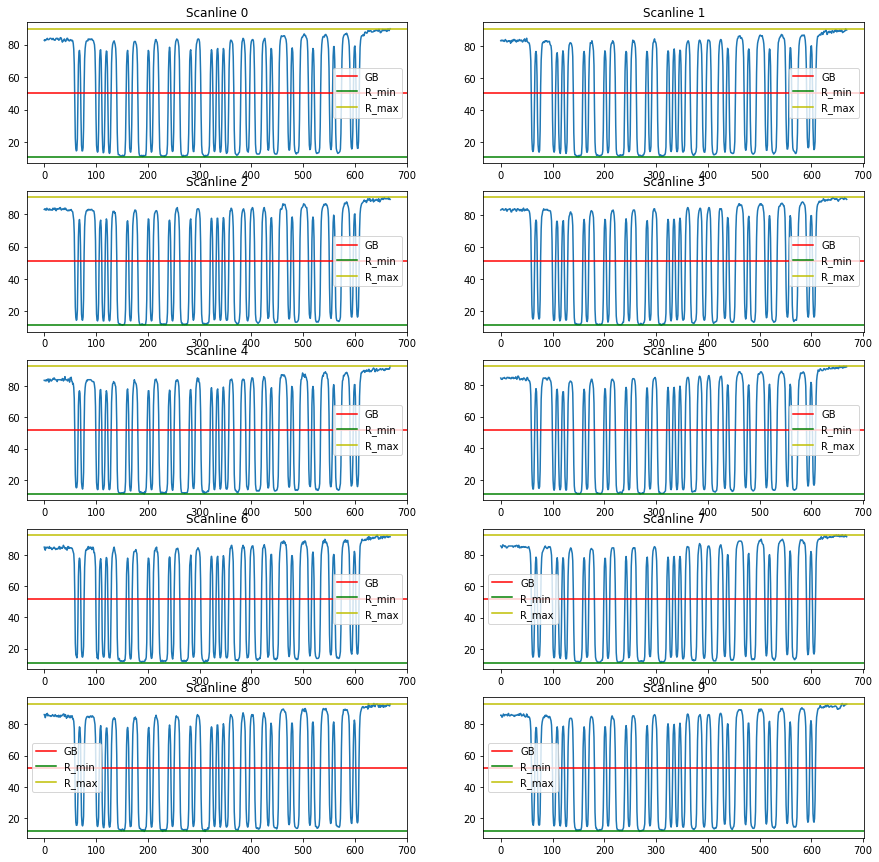

In [69]:
# TEST CHART SC: 77. GRADE 'A'
# MINE SC: 80.71. GRADE 'A'
# OK

%matplotlib inline  
compute_visualize_RminSC(f'../images/{images_paths[51]}')

Image path: ../images/UPC#32.BMP

R_min_list: [10.980392156862745, 10.588235294117647, 10.980392156862745, 10.588235294117647, 10.588235294117647, 10.980392156862745, 10.980392156862745, 11.372549019607844, 11.372549019607844, 11.372549019607844]
R_min mean: 10.980392156862745

R_max_list: [88.62745098039215, 89.01960784313725, 89.41176470588236, 90.19607843137256, 90.19607843137256, 91.37254901960785, 91.76470588235294, 92.15686274509804, 92.54901960784314, 93.33333333333333]
R_max mean: 90.86274509803921

R_min_grade: A

SC_list: [77.6470588235294, 78.4313725490196, 78.43137254901961, 79.6078431372549, 79.6078431372549, 80.3921568627451, 80.7843137254902, 80.7843137254902, 81.17647058823529, 81.96078431372548]
SC mean: 79.88235294117648
SC_grade: A

GB_list: [49.803921568627445, 49.803921568627445, 50.196078431372555, 50.3921568627451, 50.3921568627451, 51.17647058823529, 51.372549019607845, 51.76470588235294, 51.96078431372549, 52.35294117647059]
GB mean: 50.92156862745098


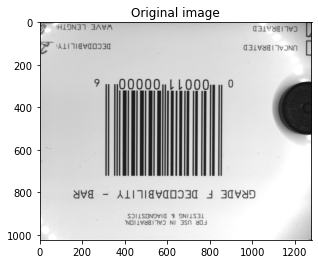

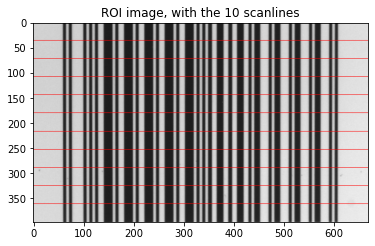

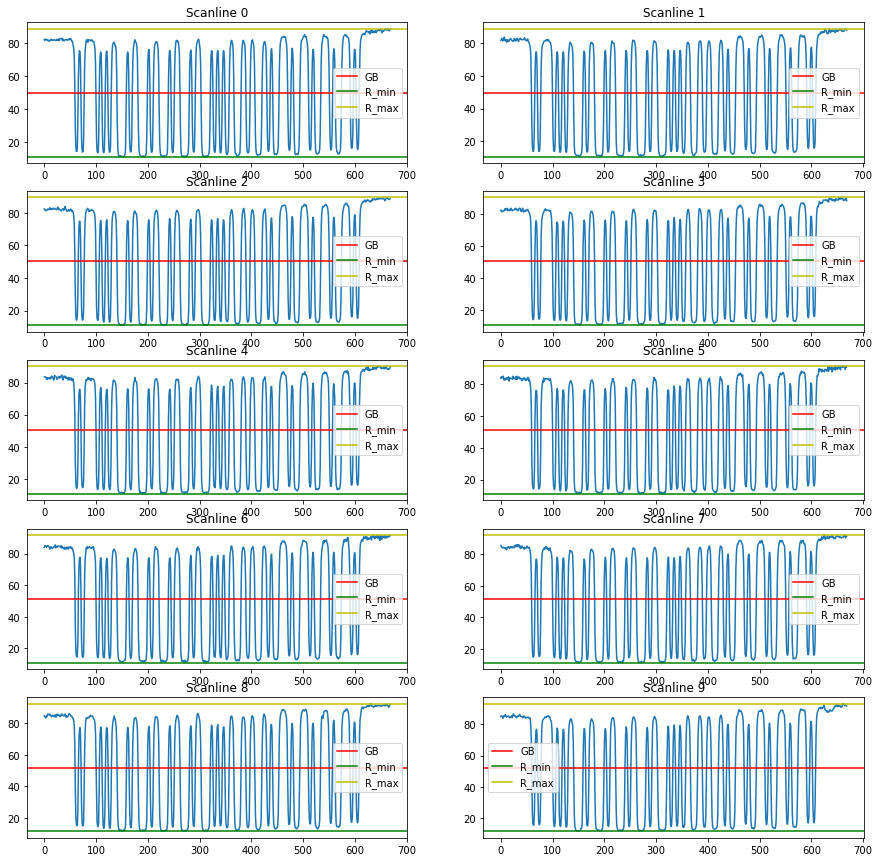

In [70]:
# TEST CHART SC: 76.8. GRADE 'A'
# MINE SC: 79.89. GRADE 'A'
# OK

%matplotlib inline  
compute_visualize_RminSC(f'../images/{images_paths[52]}')

## FINAL COMMENTS
The results are pretty good. Pretty similar to the test chart values. Even if some small differences can be present (either bigger or smaller value than the test chart), the grade is always the same.

These some differences in the values are clearly produced by the lighting condition of the camera. Let's see some examples.

**If the computed value si higher than the chart value, this means that there is a lot of light. Like in this example.** (This is the most typical case.)

Image path: ../images/UPC#24.BMP

R_min_list: [13.725490196078432, 12.941176470588237, 13.333333333333334, 13.725490196078432, 13.725490196078432, 13.725490196078432, 14.117647058823529, 14.117647058823529, 14.50980392156863, 14.50980392156863]
R_min mean: 13.843137254901961

R_max_list: [89.41176470588236, 89.01960784313725, 90.19607843137256, 90.19607843137256, 91.37254901960785, 91.76470588235294, 91.76470588235294, 92.54901960784314, 92.15686274509804, 92.94117647058823]
R_max mean: 91.13725490196077

R_min_grade: A

SC_list: [75.68627450980392, 76.07843137254902, 76.86274509803923, 76.47058823529412, 77.64705882352942, 78.0392156862745, 77.64705882352942, 78.43137254901961, 77.6470588235294, 78.4313725490196]
SC mean: 77.29411764705881
SC_grade: A

GB_list: [51.568627450980394, 50.98039215686275, 51.76470588235295, 51.96078431372549, 52.54901960784314, 52.745098039215684, 52.94117647058824, 53.333333333333336, 53.33333333333333, 53.725490196078425]
GB mean: 52.49019607843137


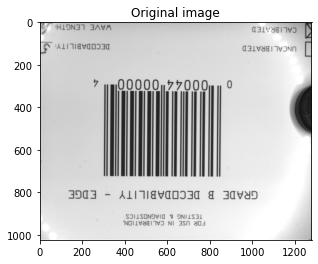

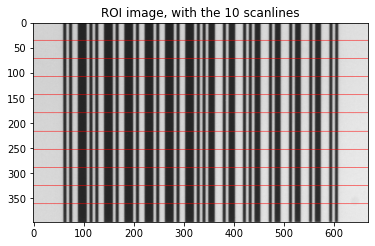

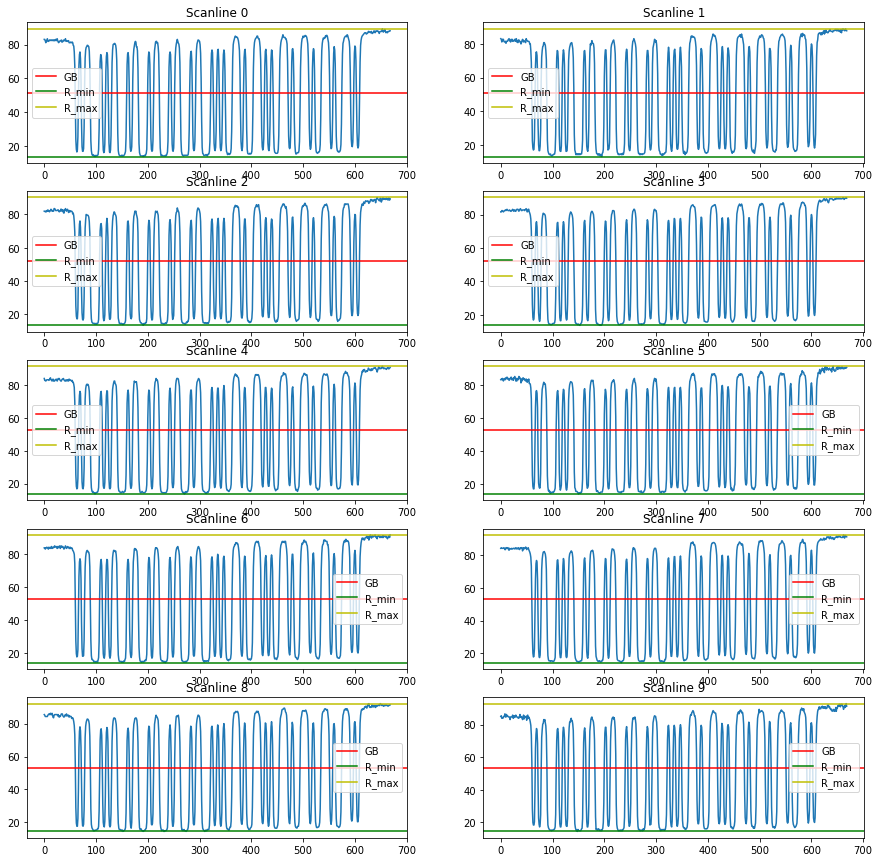

In [71]:
# TEST CHART SC: 73.8. GRADE 'A'
# MINE SC: 77.29. GRADE 'A'
# OK

%matplotlib inline  
compute_visualize_RminSC(f'../images/{images_paths[44]}')

**If the computed value si lower than the chart value, this means that there is a lack of light. Like in this example.**

Image path: ../images/C128_7.5LOW.BMP

R_min_list: [0.7843137254901961, 0.7843137254901961, 0.7843137254901961, 1.1764705882352942, 1.1764705882352942, 1.1764705882352942, 0.7843137254901961, 0.7843137254901961, 0.7843137254901961, 0.39215686274509803]
R_min mean: 0.8627450980392158

R_max_list: [75.68627450980392, 74.50980392156863, 74.11764705882354, 74.11764705882354, 73.33333333333333, 74.11764705882354, 74.50980392156863, 74.50980392156863, 74.50980392156863, 74.50980392156863]
R_max mean: 74.39215686274511

R_min_grade: A

SC_list: [74.90196078431373, 73.72549019607844, 73.33333333333334, 72.94117647058825, 72.15686274509804, 72.94117647058825, 73.72549019607844, 73.72549019607844, 73.72549019607844, 74.11764705882354]
SC mean: 73.52941176470588
SC_grade: A

GB_list: [38.23529411764706, 37.64705882352941, 37.450980392156865, 37.64705882352942, 37.254901960784316, 37.64705882352942, 37.64705882352941, 37.64705882352941, 37.64705882352941, 37.450980392156865]
GB mean: 37.6274509803

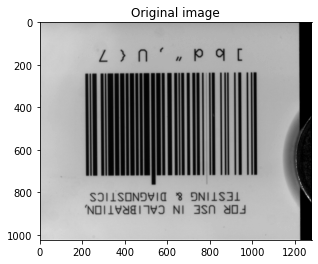

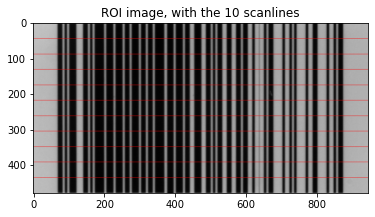

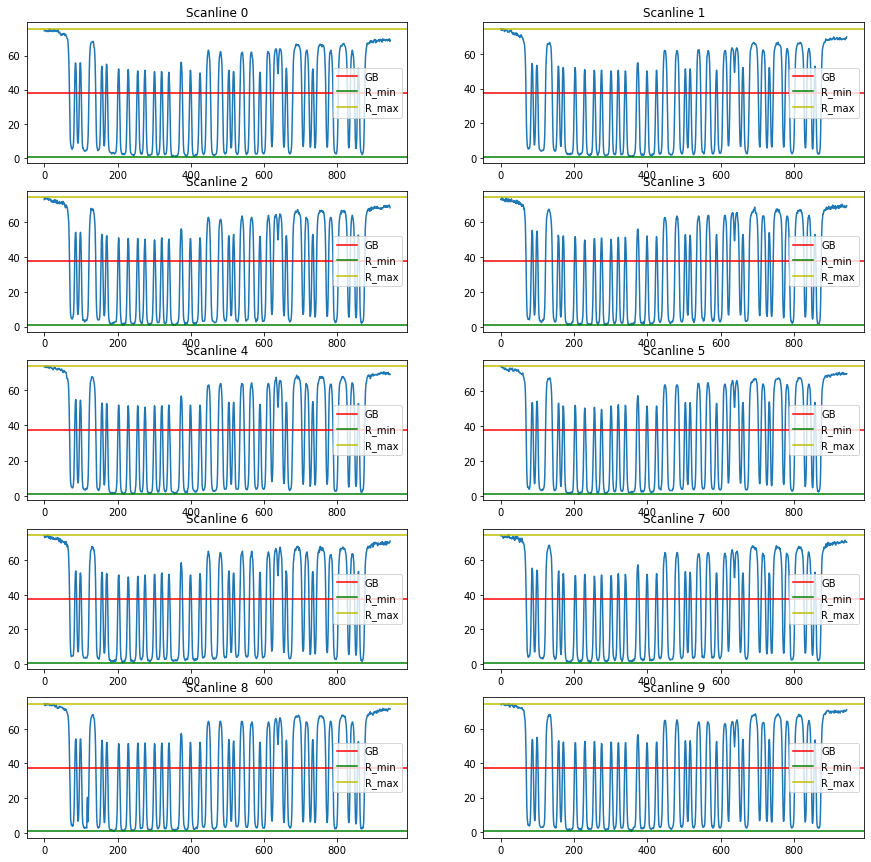

In [72]:
# TEST CHART SC: 76.4, 76.7. GRADE 'A'
# MINE SC: 73.52. GRADE 'A'
# OK

%matplotlib inline  
compute_visualize_RminSC(f'../images/{images_paths[2]}')